## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'segmentAnything-full' 
TRANSFORM = 'gabor'
CHANNEL = 'blue'
PARAM_CSV = "gabor_new.csv"

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
blue_gabor_full_segmentAnything.ipynb


In [3]:
import git
from pathlib import Path
import os
import pandas as pd
import numpy as np

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/brandonmarks/Desktop/hierarchical-bayesian-model-validation/results/case-studies/segmentAnything/full/gabor/blue'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))

# treat all as nonskewed for gabor grouped over frequency
nonskewed_filter_idxs = list(group_data_map.keys())

df = pd.read_csv(os.path.join(ROOT_DIR, "gabor", PARAM_CSV), index_col="index")
df = df.sort_index()

filter_group_map = (df.loc[:, ["wave_number", "aspect_ratio", "frequency"]]
                      .apply(tuple, axis=1)
                      .to_dict())

filter_group_map

{0: (2.0, 0.5, 0.044),
 1: (2.0, 0.5, 0.065),
 2: (2.0, 0.5, 0.096),
 3: (2.0, 0.5, 0.141),
 4: (2.0, 0.5, 0.208),
 5: (2.0, 0.5, 0.306),
 6: (2.0, 0.5, 0.45),
 7: (2.0, 1.0, 0.044),
 8: (2.0, 1.0, 0.065),
 9: (2.0, 1.0, 0.096),
 10: (2.0, 1.0, 0.141),
 11: (2.0, 1.0, 0.208),
 12: (2.0, 1.0, 0.306),
 13: (2.0, 1.0, 0.45),
 14: (3.0, 0.5, 0.044),
 15: (3.0, 0.5, 0.065),
 16: (3.0, 0.5, 0.096),
 17: (3.0, 0.5, 0.141),
 18: (3.0, 0.5, 0.208),
 19: (3.0, 0.5, 0.306),
 20: (3.0, 0.5, 0.45),
 21: (3.0, 1.0, 0.044),
 22: (3.0, 1.0, 0.065),
 23: (3.0, 1.0, 0.096),
 24: (3.0, 1.0, 0.141),
 25: (3.0, 1.0, 0.208),
 26: (3.0, 1.0, 0.306),
 27: (3.0, 1.0, 0.45),
 28: (4.0, 0.5, 0.044),
 29: (4.0, 0.5, 0.065),
 30: (4.0, 0.5, 0.096),
 31: (4.0, 0.5, 0.141),
 32: (4.0, 0.5, 0.208),
 33: (4.0, 0.5, 0.306),
 34: (4.0, 0.5, 0.45),
 35: (4.0, 1.0, 0.044),
 36: (4.0, 1.0, 0.065),
 37: (4.0, 1.0, 0.096),
 38: (4.0, 1.0, 0.141),
 39: (4.0, 1.0, 0.208),
 40: (4.0, 1.0, 0.306),
 41: (4.0, 1.0, 0.45)}

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters
elif 'gabor' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 262144000,
 1: 262144000,
 2: 262144000,
 3: 262144000,
 4: 262144000,
 5: 262144000,
 6: 262144000,
 7: 262144000,
 8: 262144000,
 9: 262144000,
 10: 262144000,
 11: 262144000,
 12: 262144000,
 13: 262144000,
 14: 262144000,
 15: 262144000,
 16: 262144000,
 17: 262144000,
 18: 262144000,
 19: 262144000,
 20: 262144000,
 21: 262144000,
 22: 262144000,
 23: 262144000,
 24: 262144000,
 25: 262144000,
 26: 262144000,
 27: 262144000,
 28: 262144000,
 29: 262144000,
 30: 262144000,
 31: 262144000,
 32: 262144000,
 33: 262144000,
 34: 262144000,
 35: 262144000,
 36: 262144000,
 37: 262144000,
 38: 262144000,
 39: 262144000,
 40: 262144000,
 41: 262144000}

Running 12760 CDFs


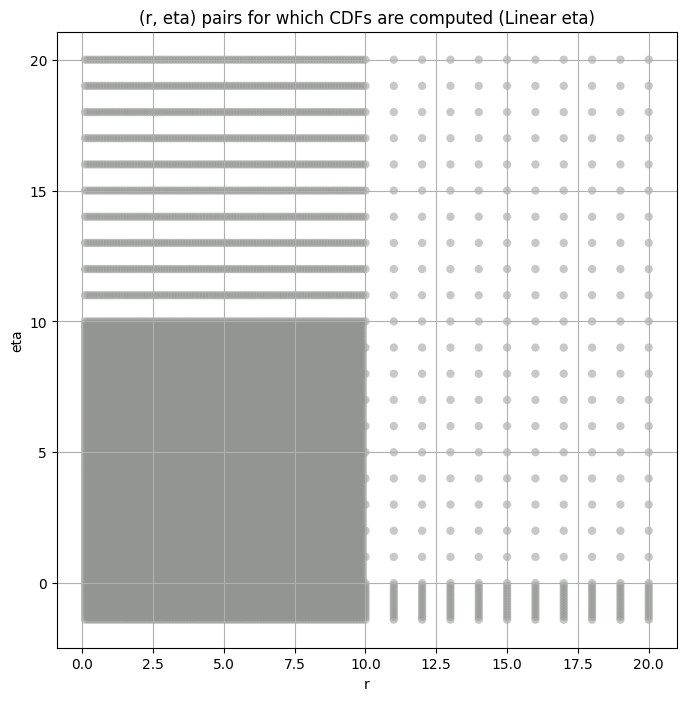

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}: {str(filter_group_map[group])}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = str(filter_group_map[group])

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0: (2.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 1: (2.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2: (2.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3: (2.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4: (2.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5: (2.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6: (2.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7: (2.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8: (2.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9: (2.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10: (2.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11: (2.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12: (2.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13: (2.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14: (3.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15: (3.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16: (3.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17: (3.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18: (3.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19: (3.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20: (3.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21: (3.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22: (3.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23: (3.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24: (3.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25: (3.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26: (3.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27: (3.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28: (4.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29: (4.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30: (4.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31: (4.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32: (4.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33: (4.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34: (4.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35: (4.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 36: (4.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37: (4.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38: (4.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39: (4.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40: (4.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41: (4.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,38141.09400,29741.96500,47408.02300,5.545877,3.051156,15.768338,262144000.0,"(2.0, 0.5, 0.044)"
1,16323.57900,12823.37800,20713.02000,6.197828,3.286204,19.461838,262144000.0,"(2.0, 0.5, 0.065)"
2,6576.69800,5205.66200,8263.79100,6.400652,3.229711,17.005306,262144000.0,"(2.0, 0.5, 0.096)"
3,2797.85910,2166.36350,3563.50500,7.264324,3.640300,21.403347,262144000.0,"(2.0, 0.5, 0.141)"
4,1152.82480,876.24927,1451.83330,8.286530,4.267028,29.099030,262144000.0,"(2.0, 0.5, 0.208)"
5,415.59400,313.29500,537.46234,9.865244,4.211713,37.117893,262144000.0,"(2.0, 0.5, 0.306)"
6,279.85425,209.98505,375.27567,9.890322,4.796311,35.474228,262144000.0,"(2.0, 0.5, 0.45)"
7,54288.89500,43416.72300,68531.04000,6.410547,3.334382,19.243261,262144000.0,"(2.0, 1.0, 0.044)"
8,21606.79500,16645.76000,27949.41000,7.674028,3.695609,25.068642,262144000.0,"(2.0, 1.0, 0.065)"


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,38141.09400,38141.093750,36672.796875,35696.363281,34124.695312
1,16323.57900,16323.579102,15653.871094,15204.600586,14486.630859
2,6576.69800,6576.698242,6298.104980,6114.589355,5823.115723
3,2797.85910,2797.859131,2667.471680,2583.403320,2451.534668
4,1152.82480,1152.824829,1093.903076,1056.982178,999.801819
5,415.59400,415.593994,391.712921,376.970245,354.566895
6,279.85425,279.854248,263.973541,254.048370,238.812012
7,54288.89500,54288.894531,51886.398438,50359.734375,47985.933594
8,21606.79500,21606.794922,20549.632812,19878.464844,18846.496094


####
Filter_idx, 0: (2.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.004411266483964393 38141.094


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.005214778791867214 36672.797


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.005127122700877229 35696.363


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.007109777981930854 34124.695
Number of samples: 100000, Without approximation : 262144000.0


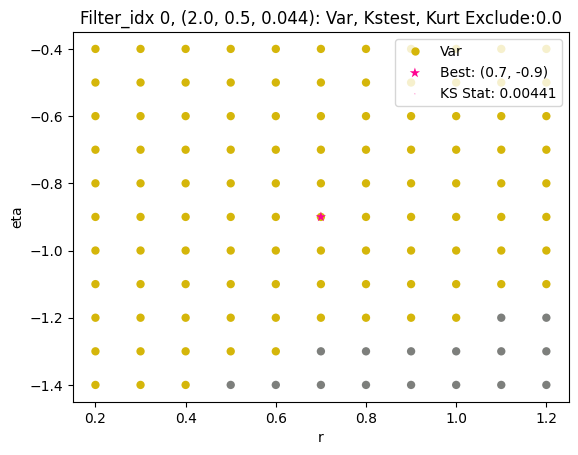

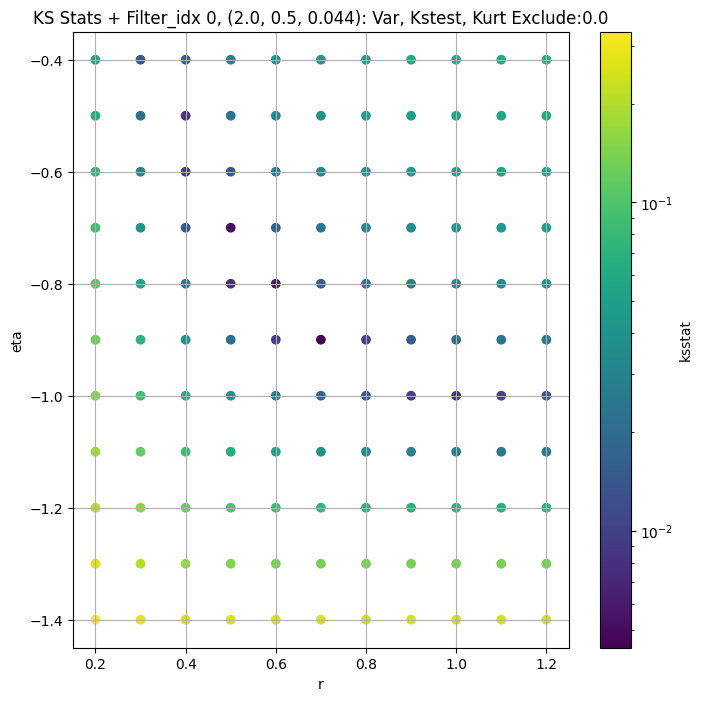

####
Filter_idx, 1: (2.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 0 0.004968393856501829 16323.579


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 50 0.005141562154049928 15653.871


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 100 0.005225962618853143 15204.601


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 200 0.006364345255780335 14486.631
Number of samples: 100000, Without approximation : 262144000.0


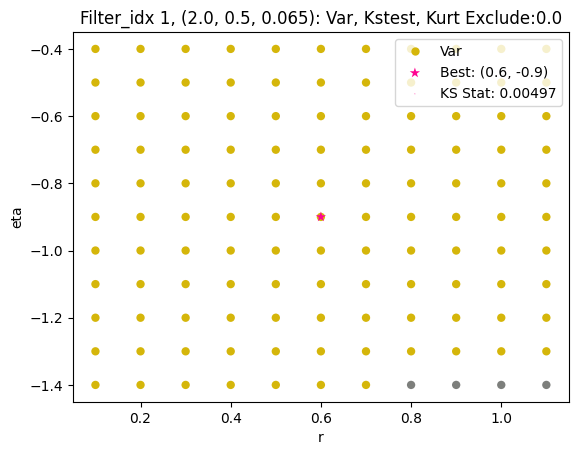

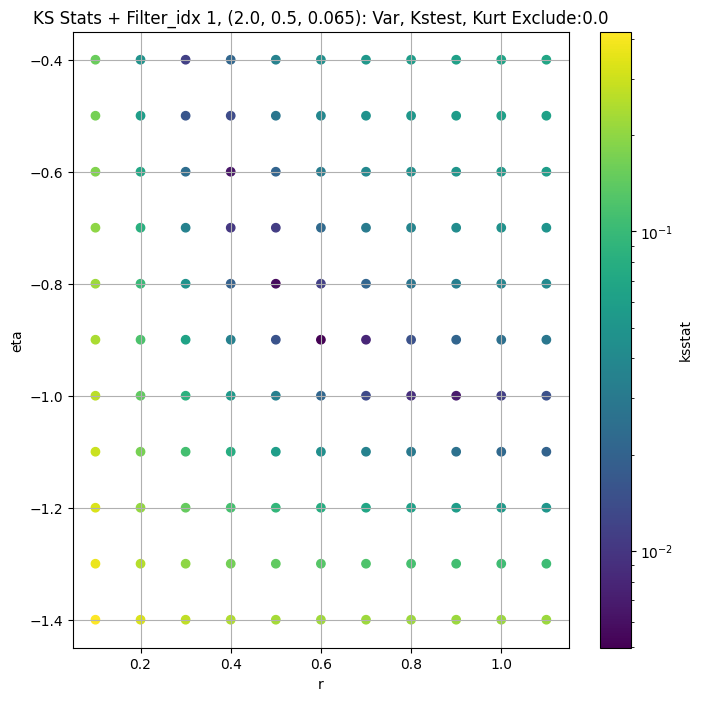

####
Filter_idx, 2: (2.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.004761620800159627 6576.698


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.005616074381474656 6298.105


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.004718259709472594 6114.5894


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.006757227971698615 5823.1157
Number of samples: 100000, Without approximation : 262144000.0


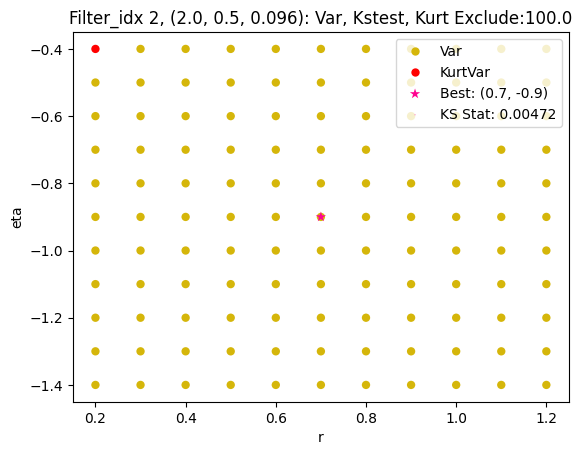

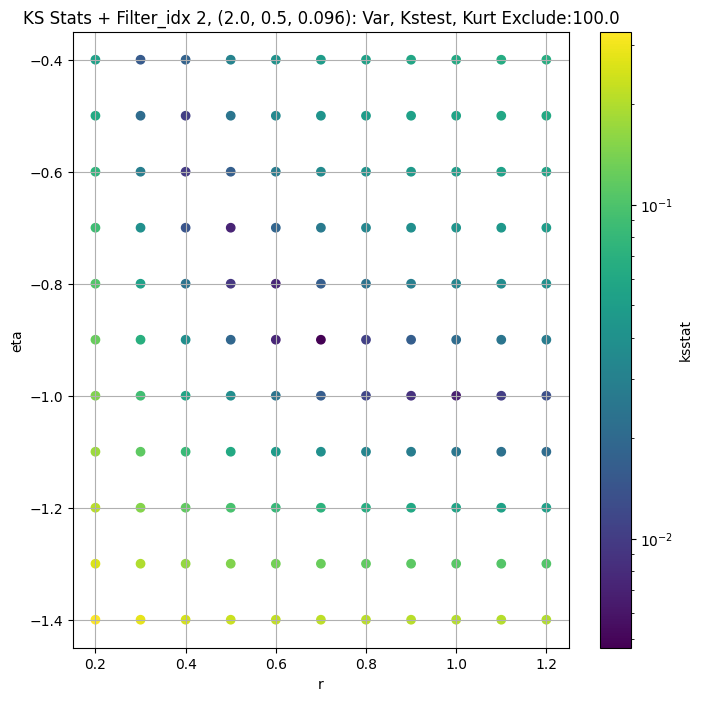

####
Filter_idx, 3: (2.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.00313804141267926 2797.8591


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.005573471581653791 2667.4717


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.00639723317573293 2583.4033


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.006248478997050277 2451.5347
Number of samples: 100000, Without approximation : 262144000.0


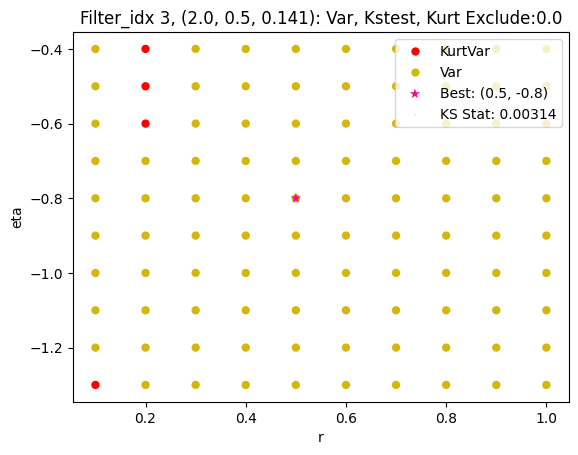

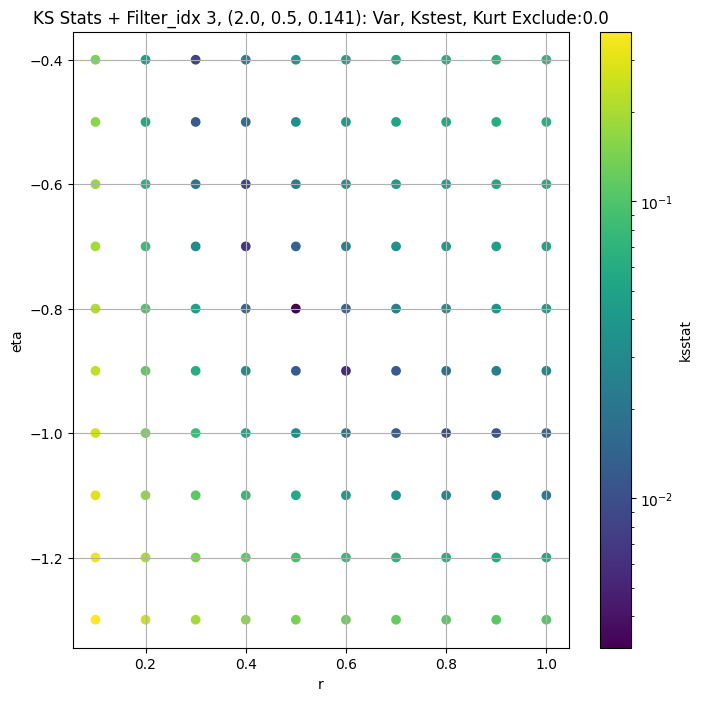

####
Filter_idx, 4: (2.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.005469714717703744 1152.8248


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.006729246765086461 1093.9031


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.005798226567707752 1056.9822


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.007190675307356065 999.8018
Number of samples: 100000, Without approximation : 262144000.0


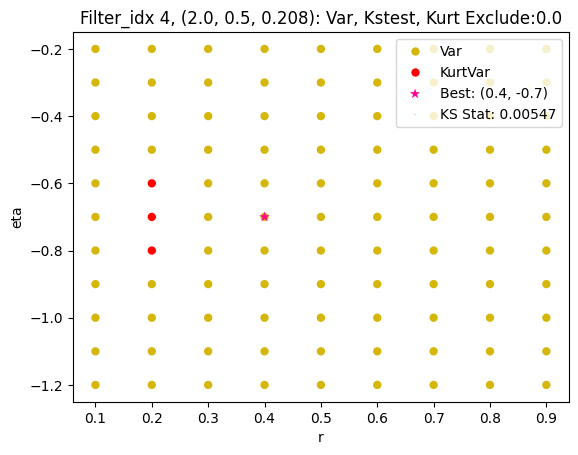

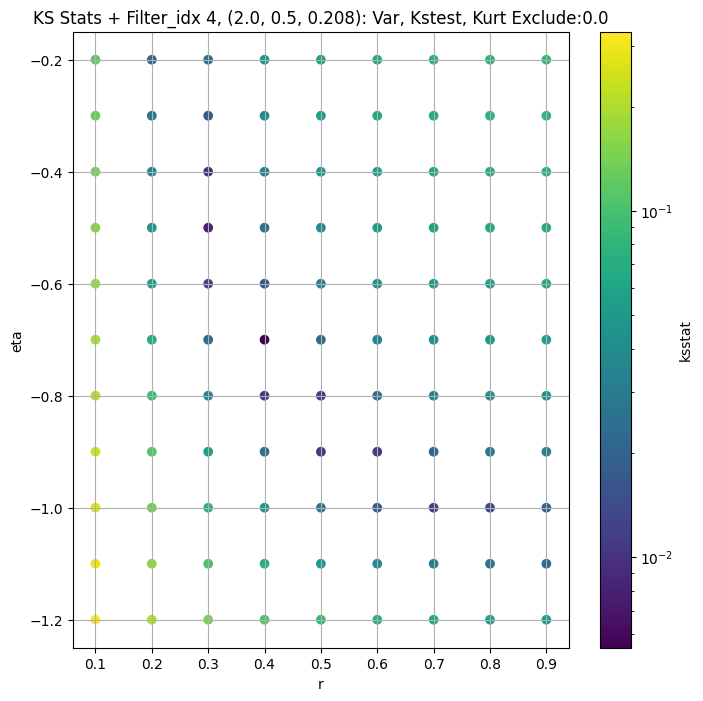

####
Filter_idx, 5: (2.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.005197315458799423 415.594


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.0054363958030350795 391.71292


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.005706065719533082 376.97025


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.007292499627196025 354.5669
Number of samples: 100000, Without approximation : 262144000.0


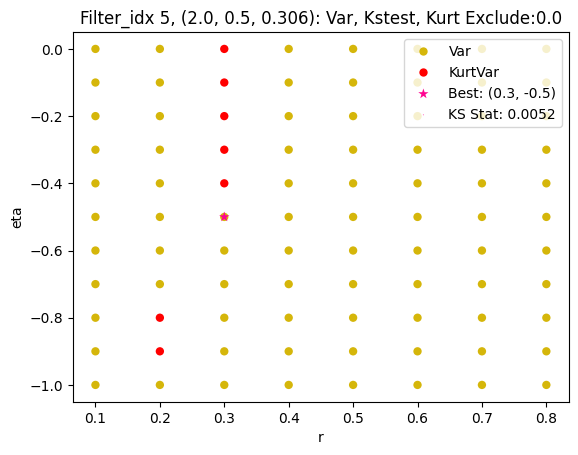

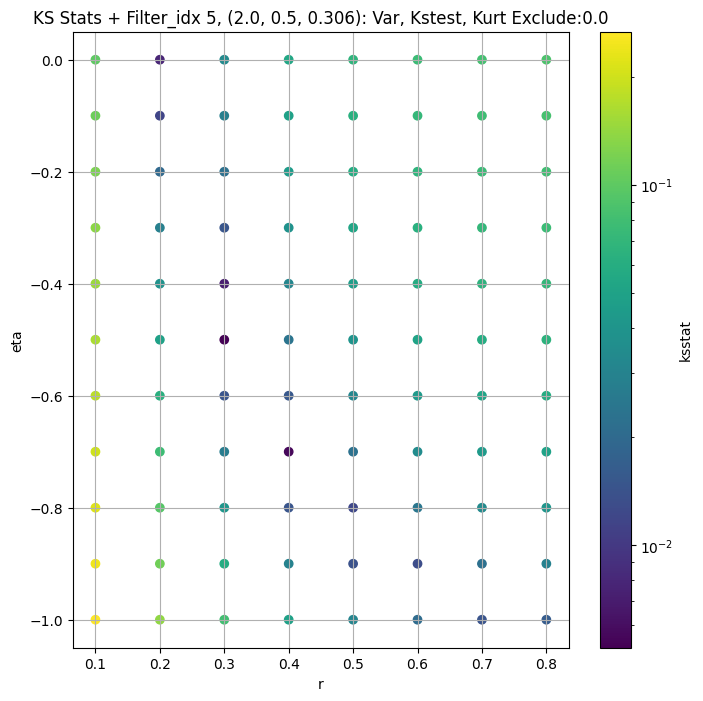

####
Filter_idx, 6: (2.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.004549358720662089 279.85425


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.0047512648740078225 263.97354


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.005917748494282282 254.04837


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.006641704106401636 238.81201
Number of samples: 100000, Without approximation : 262144000.0


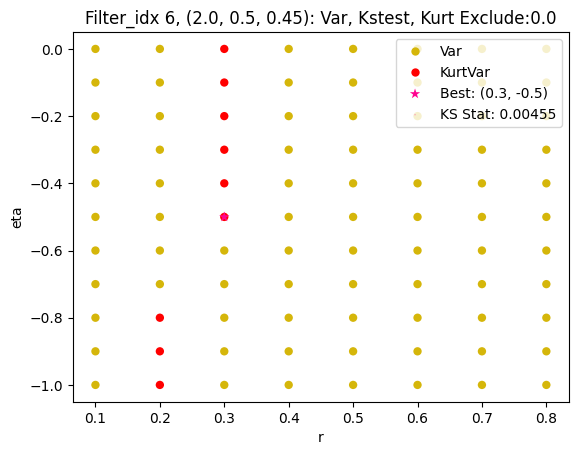

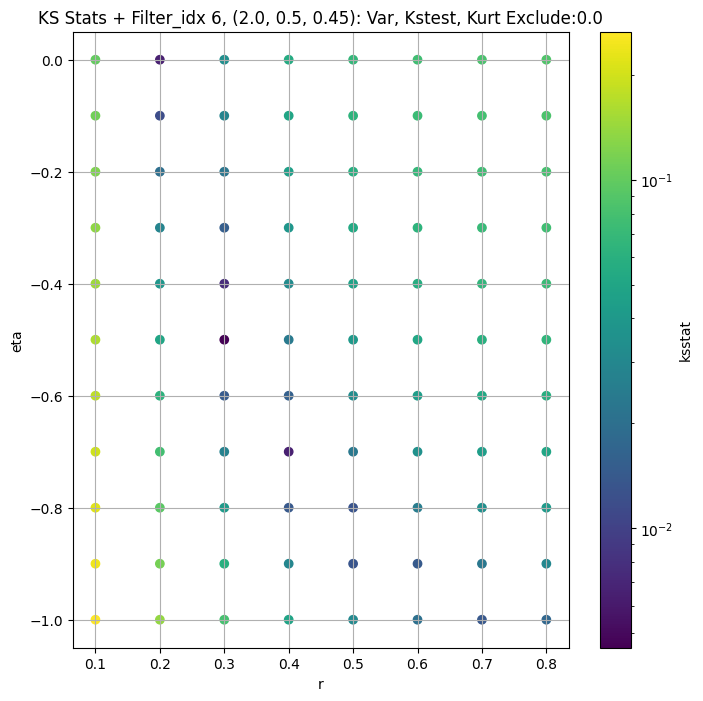

####
Filter_idx, 7: (2.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.004035017300952182 54288.895


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.004213924983677675 51886.4


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.0044116706638392955 50359.734


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.0060856963874135195 47985.934
Number of samples: 100000, Without approximation : 262144000.0


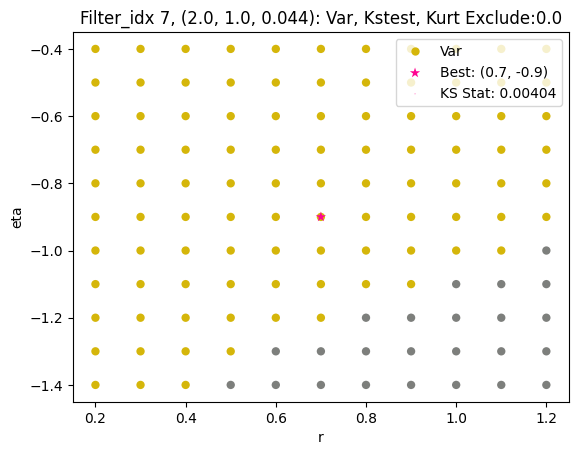

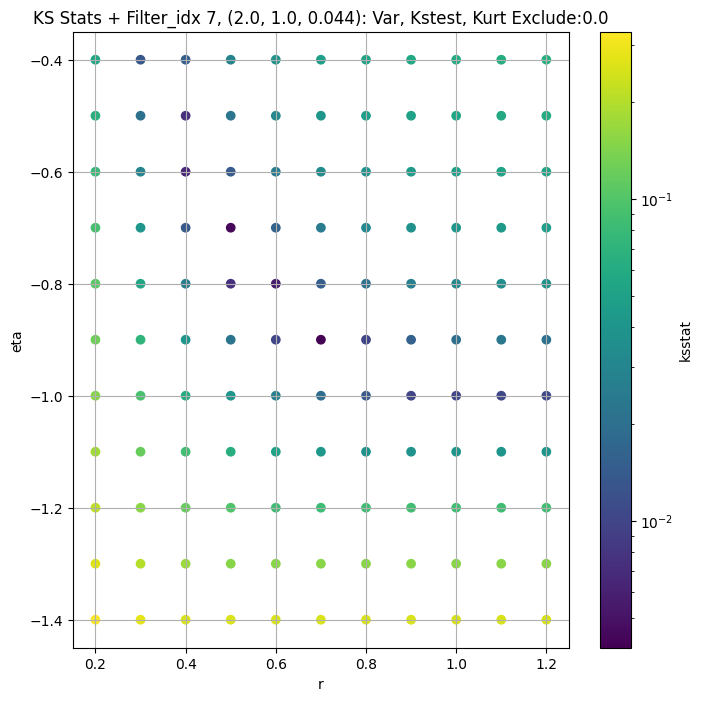

####
Filter_idx, 8: (2.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.0024851532996538334 21606.795


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.004611773277649257 20549.633


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.005751789264000218 19878.465


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.005901523850850333 18846.496
Number of samples: 100000, Without approximation : 262144000.0


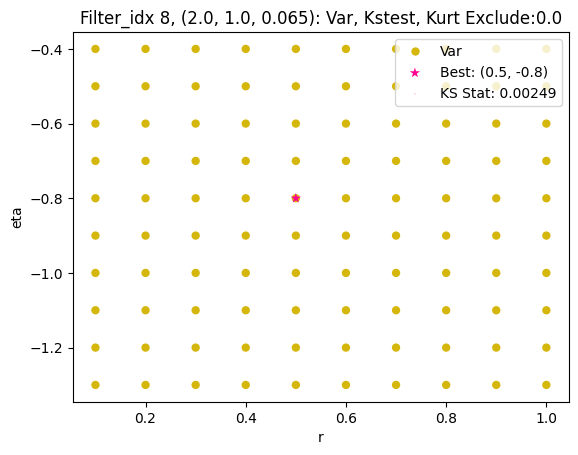

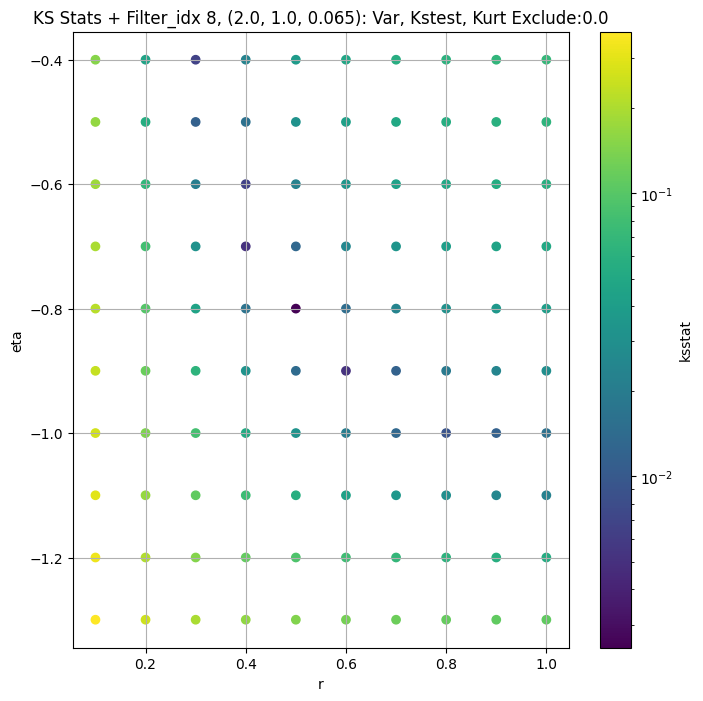

####
Filter_idx, 9: (2.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.003604677993602312 8995.317


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.0049967781654898236 8543.403


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.004436126506644045 8258.021


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.005521554537063711 7818.721
Number of samples: 100000, Without approximation : 262144000.0


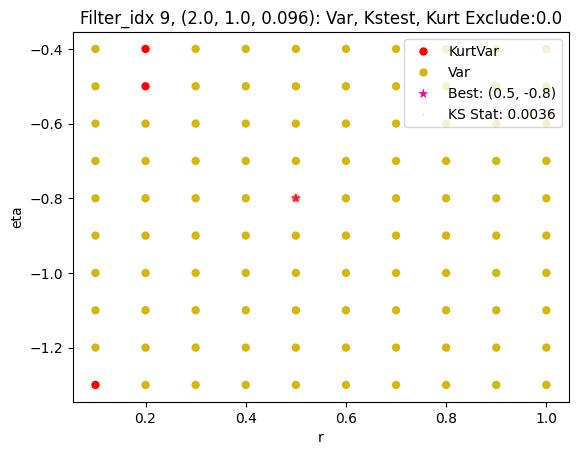

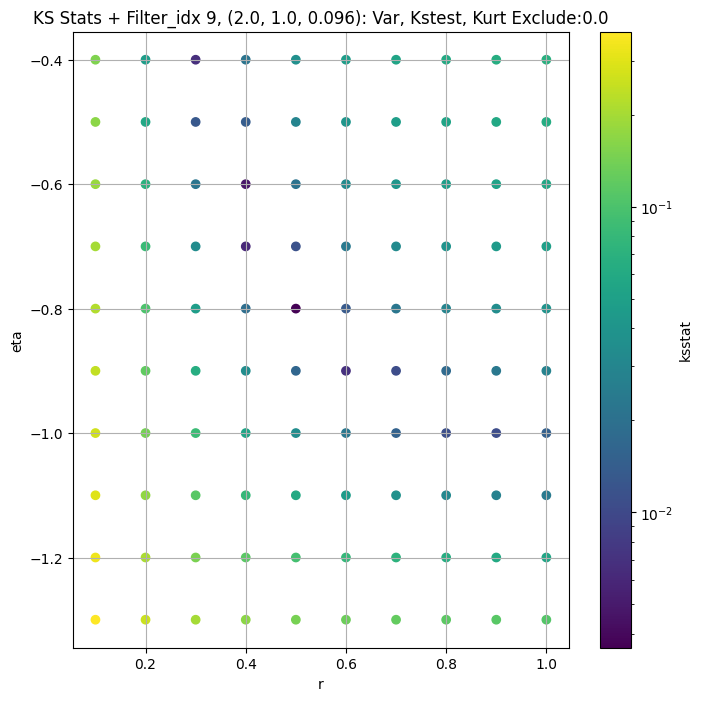

####
Filter_idx, 10: (2.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.0041739504396999805 3820.5479


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.004944654242150182 3613.9602


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.00509985690222492 3489.141


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.005755210652738985 3300.418
Number of samples: 100000, Without approximation : 262144000.0


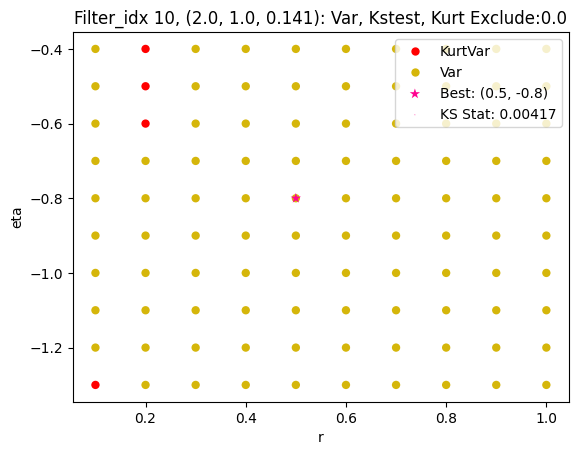

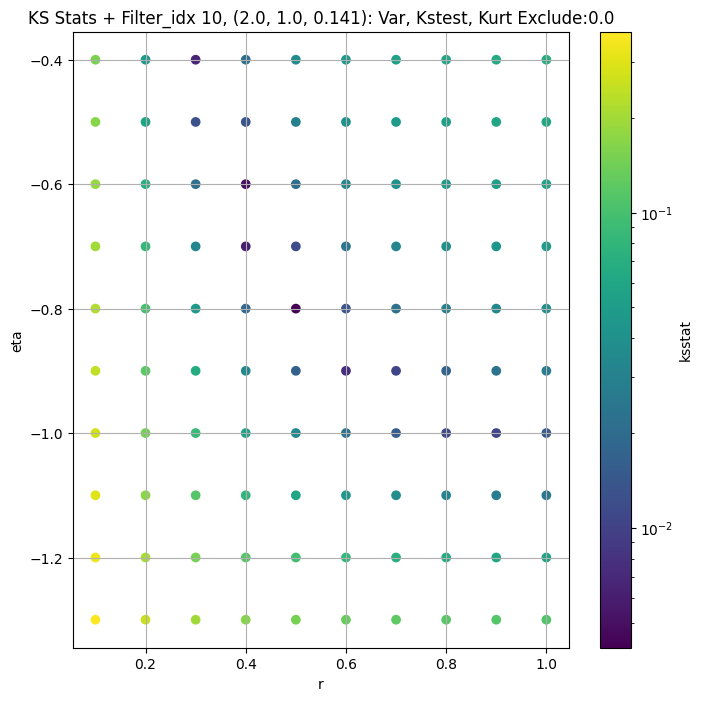

####
Filter_idx, 11: (2.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.003888044921473821 1576.0858


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.004480916193489948 1485.862


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.005330399542876729 1432.3844


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.005485903954179611 1350.9719
Number of samples: 100000, Without approximation : 262144000.0


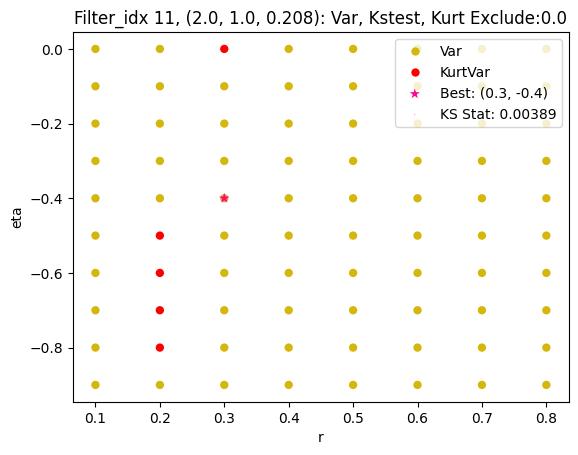

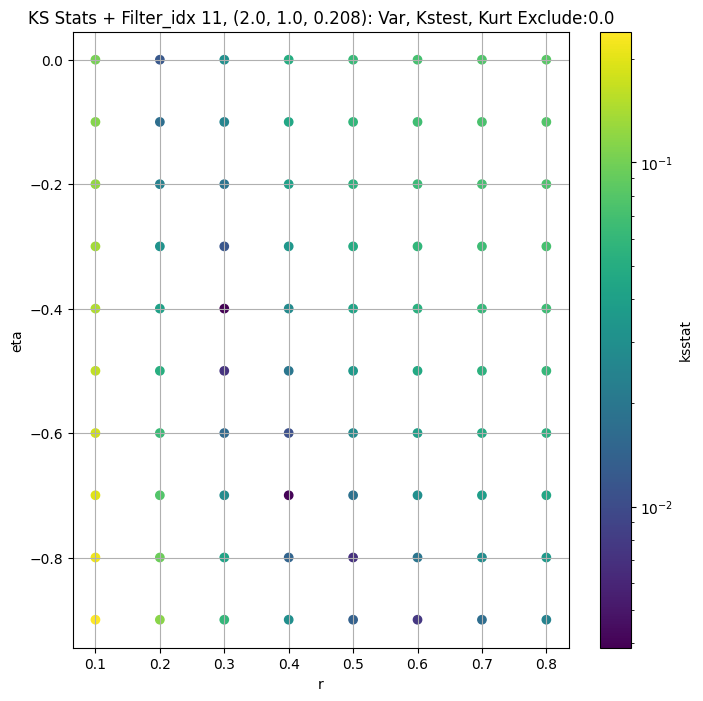

####
Filter_idx, 12: (2.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.0035798859513811454 610.1576


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.004485624706169235 570.01953


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.00501308956578847 547.3313


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.006383243700772034 513.7065
Number of samples: 100000, Without approximation : 262144000.0


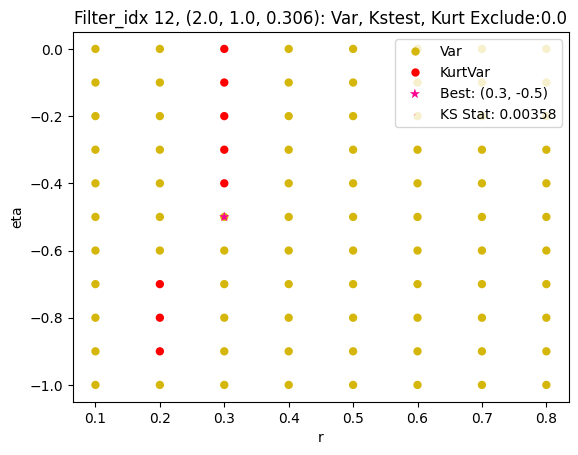

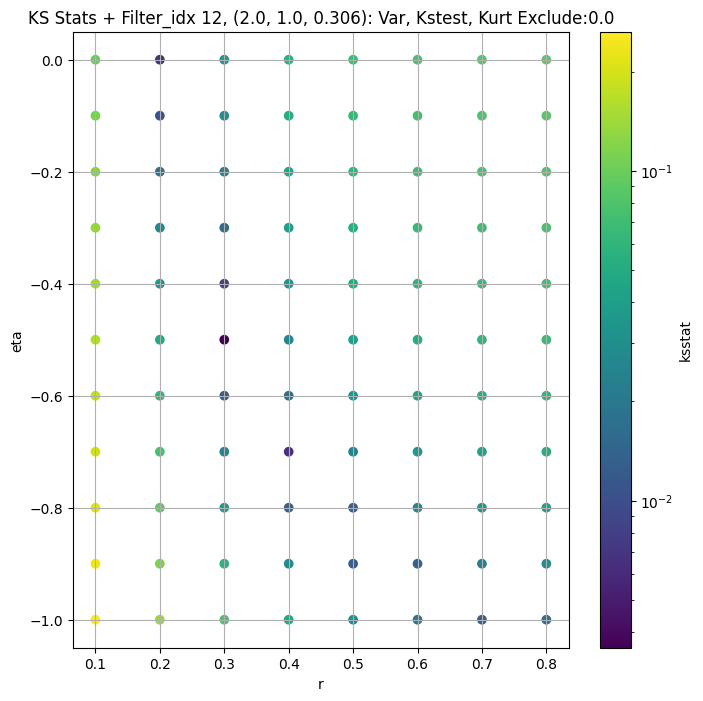

####
Filter_idx, 13: (2.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.00404942243534101 313.63715


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.004119888368967484 289.7517


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.004668013216353739 276.43735


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.005855682080709079 256.81863
Number of samples: 100000, Without approximation : 262144000.0


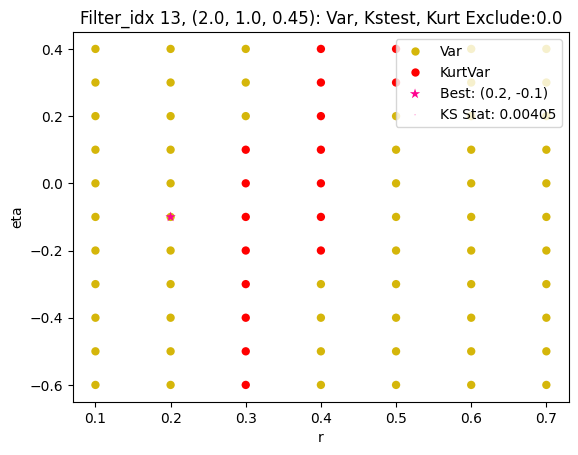

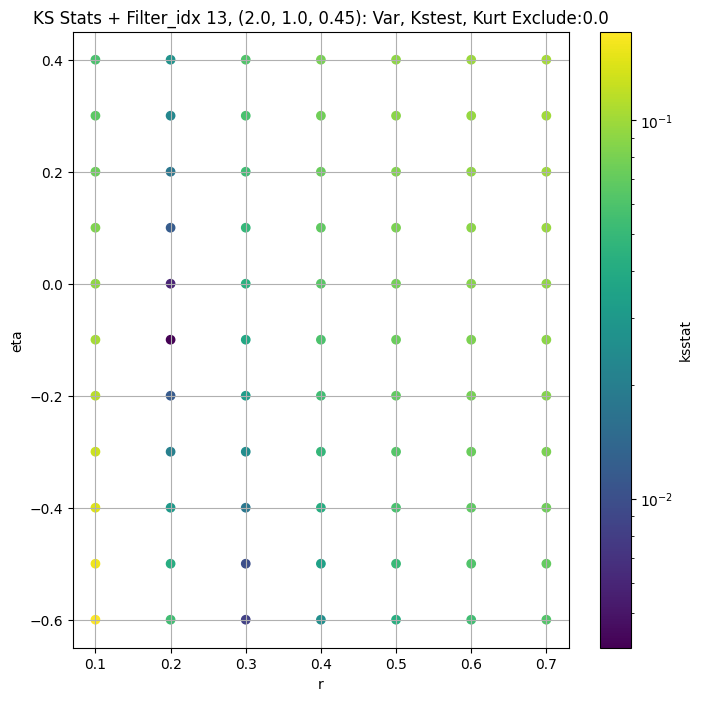

####
Filter_idx, 14: (3.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.004662030212713553 38099.715


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.004992265238830562 36428.527


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.0063868492598248006 35346.83


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.005977312670686685 33637.082
Number of samples: 100000, Without approximation : 262144000.0


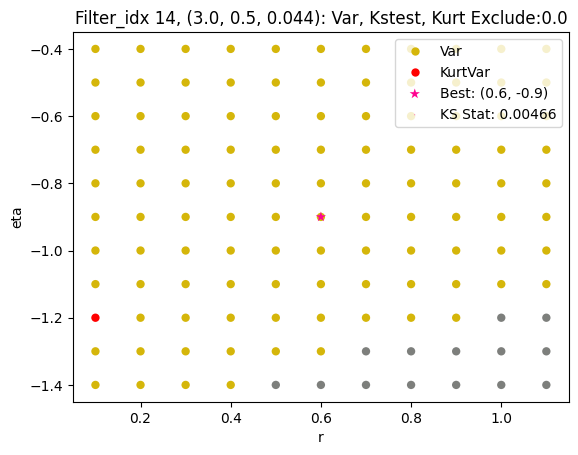

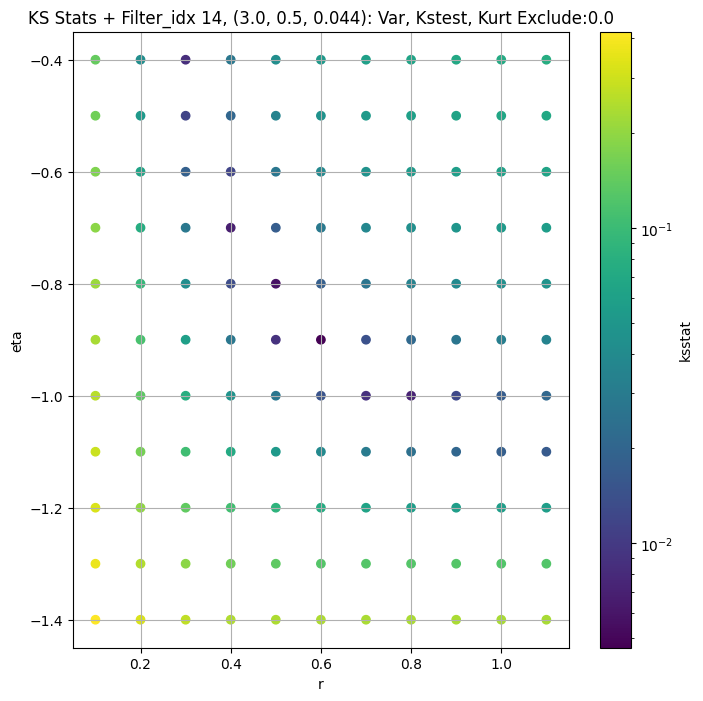

####
Filter_idx, 15: (3.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.0038622133222198027 15911.381


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.00466088560425193 15061.085


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.004774053388363897 14554.416


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.007018074095167304 13779.464
Number of samples: 100000, Without approximation : 262144000.0


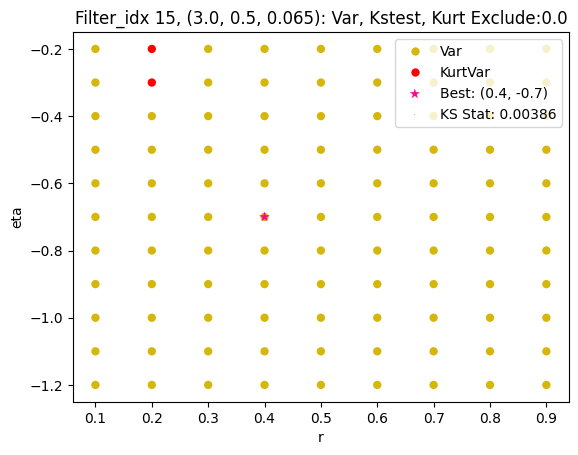

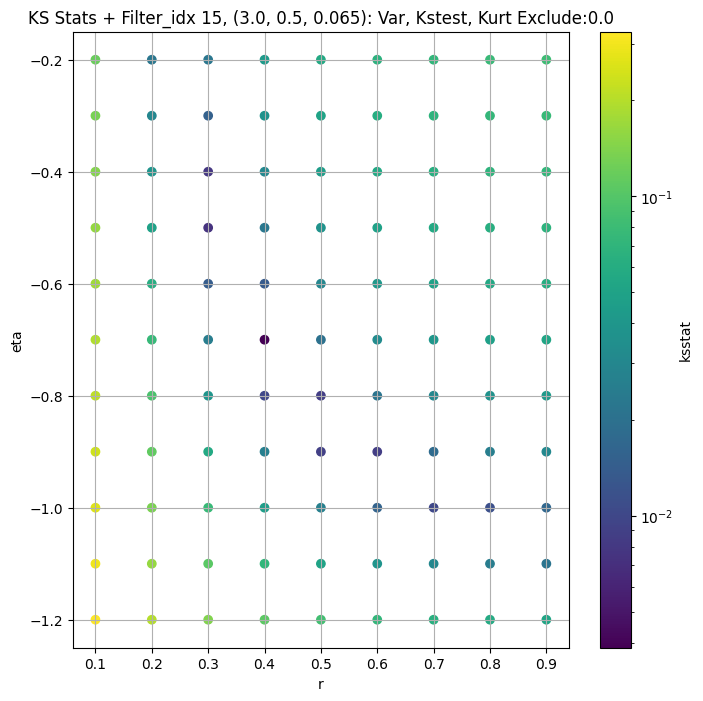

####
Filter_idx, 16: (3.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.005589363917815657 6334.278


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.0051657548157177935 5997.093


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.006752900049516675 5787.9946


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.006257266347678536 5465.189
Number of samples: 100000, Without approximation : 262144000.0


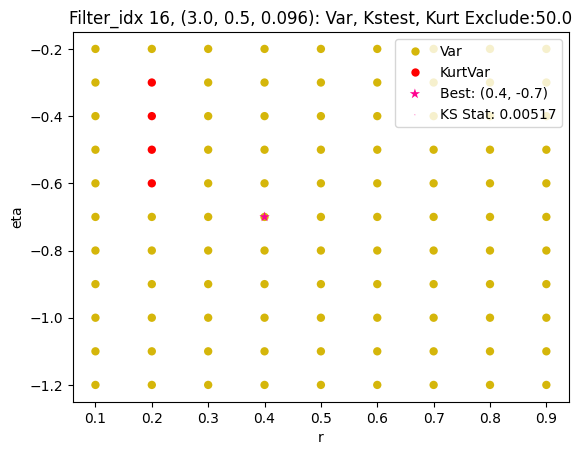

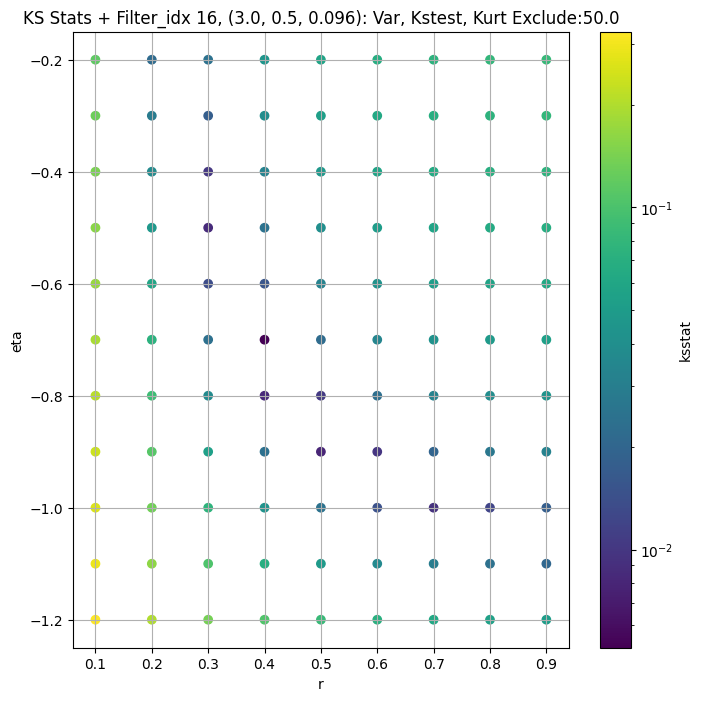

####
Filter_idx, 17: (3.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.005818002674264411 2623.0916


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.006707907727560247 2474.5532


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.006684638985639091 2384.9136


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.006202327378919126 2247.686
Number of samples: 100000, Without approximation : 262144000.0


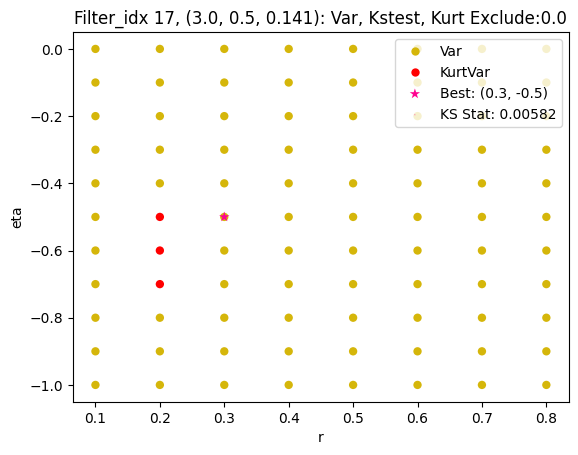

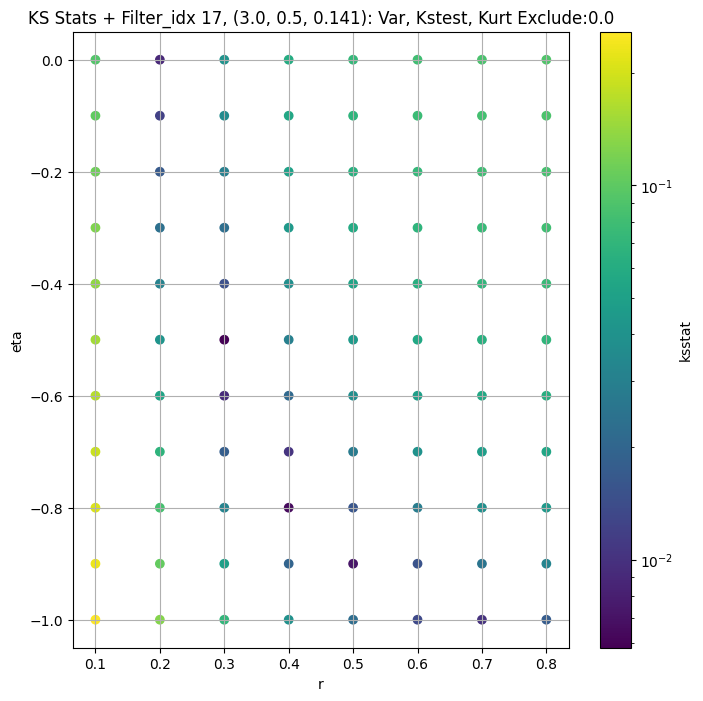

####
Filter_idx, 18: (3.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.004702376994607092 1129.5138


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.006718143388792175 1059.3231


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.007522925822103579 1017.95105


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.008521960463843903 955.7625
Number of samples: 100000, Without approximation : 262144000.0


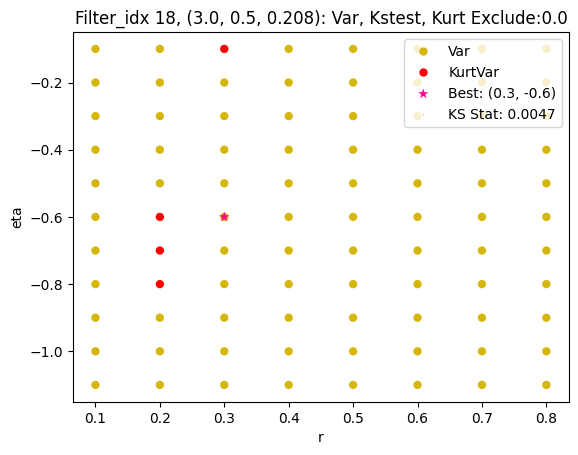

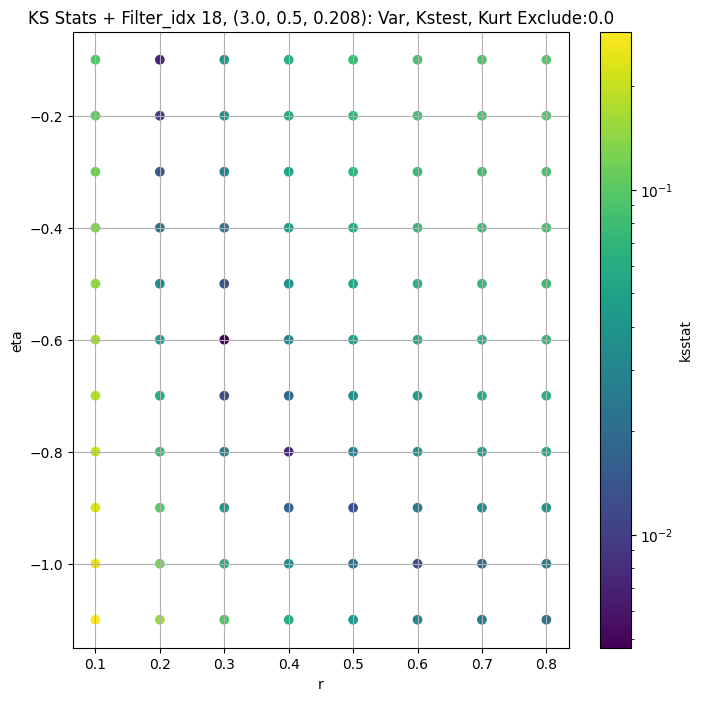

####
Filter_idx, 19: (3.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.004504186396061649 455.46497


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.00559999590989535 422.25647


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.007018740502954701 403.44144


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.007543340396060201 375.34647
Number of samples: 100000, Without approximation : 262144000.0


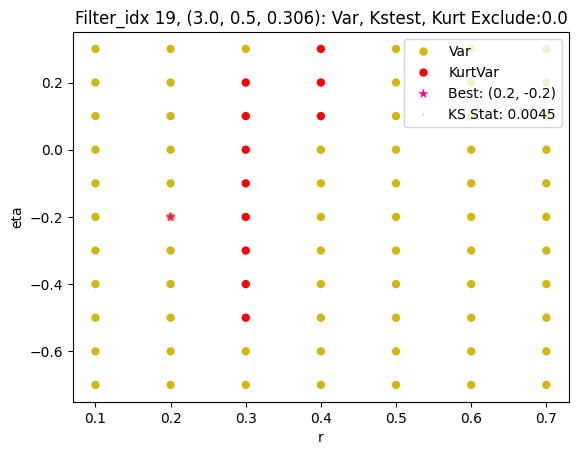

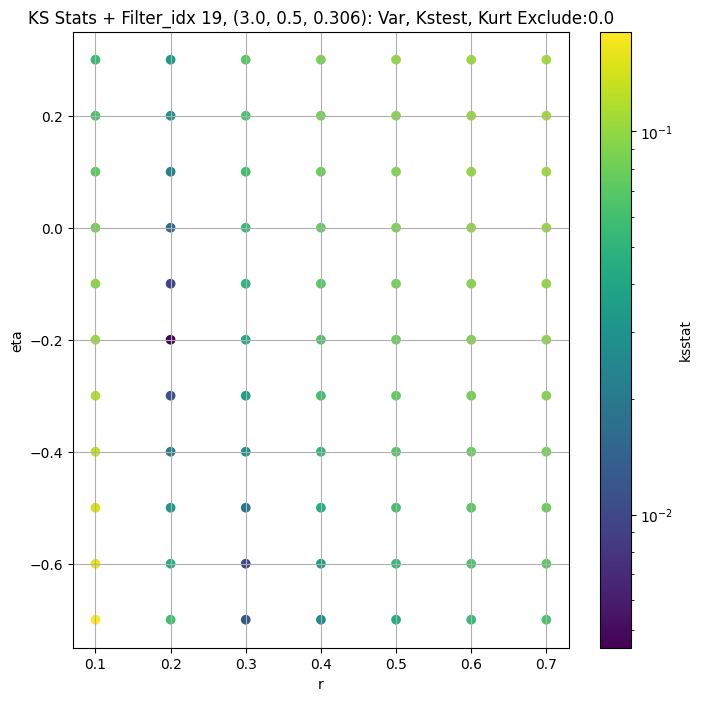

####
Filter_idx, 20: (3.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.0025575952491725396 215.66731


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.0037010772664250527 198.1575


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.005112425052145042 188.29689


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.005743008796174367 173.64551
Number of samples: 100000, Without approximation : 262144000.0


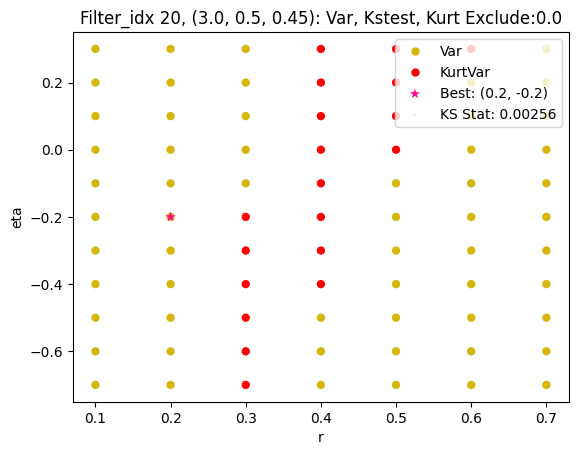

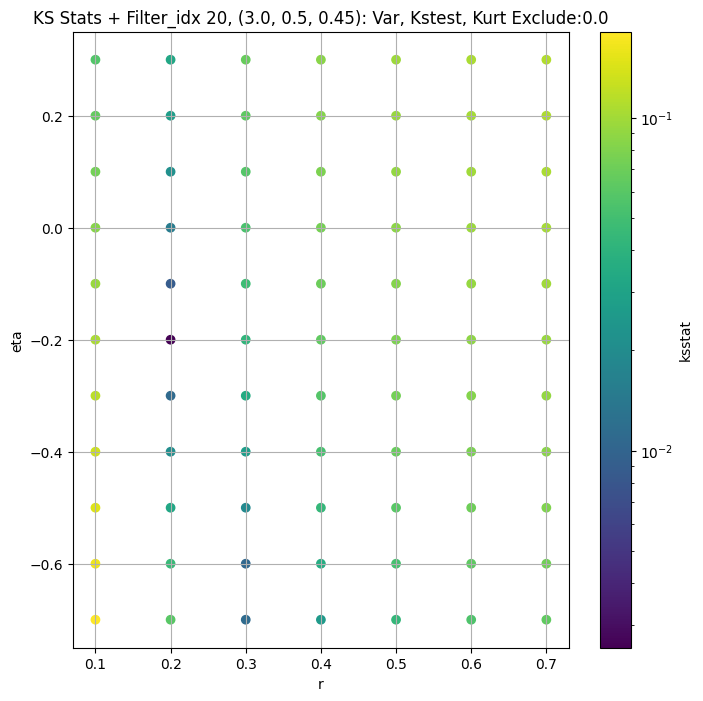

####
Filter_idx, 21: (3.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.004651390189595692 45464.17


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.004272123168021988 42626.777


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.005649773340688752 40912.94


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.005636066723770483 38339.605
Number of samples: 100000, Without approximation : 262144000.0


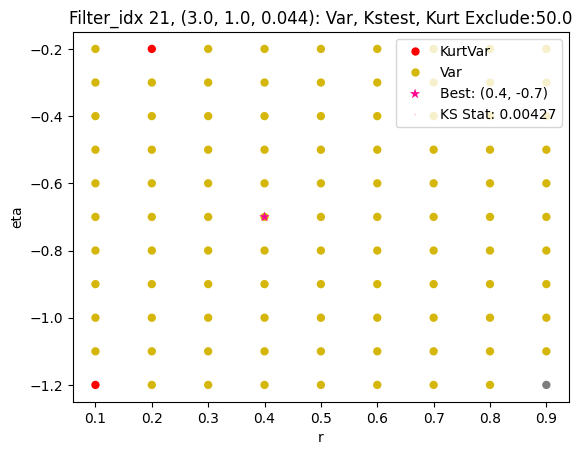

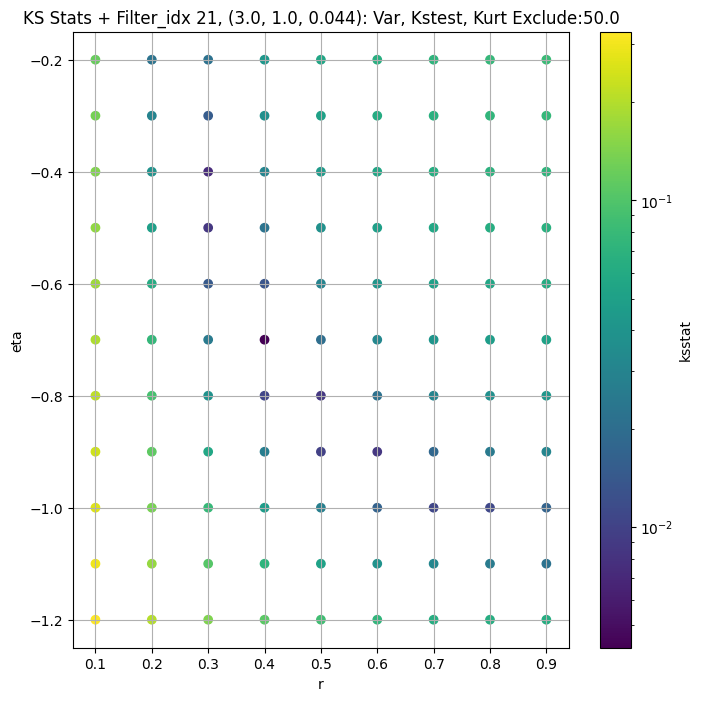

####
Filter_idx, 22: (3.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.005959272494530821 18223.31


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.006468730279649226 17036.908


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.005109964844878287 16327.526


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.005420461298496604 15279.34
Number of samples: 100000, Without approximation : 262144000.0


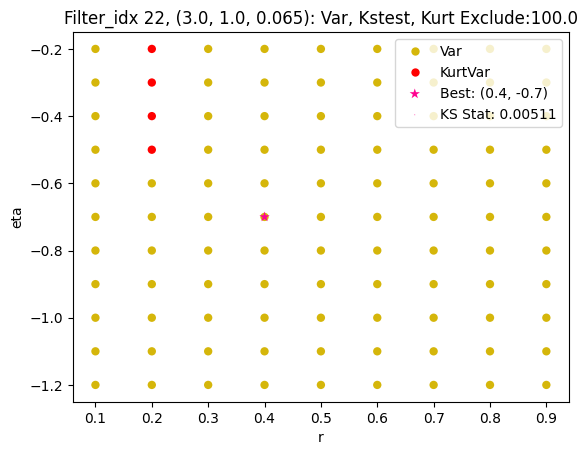

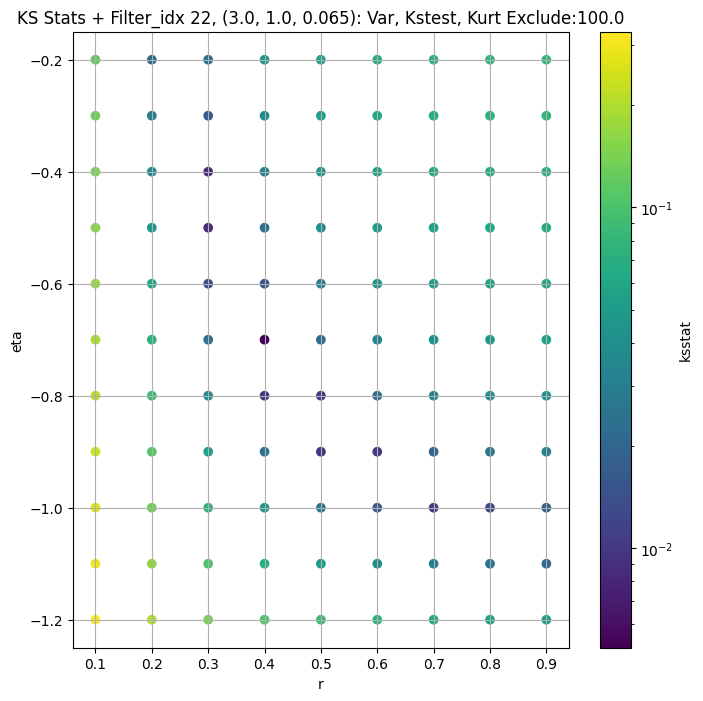

####
Filter_idx, 23: (3.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.00383938855709387 7829.959


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.004499088759862768 7295.7124


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.006271913742489144 6981.3867


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.007467058239363444 6515.425
Number of samples: 100000, Without approximation : 262144000.0


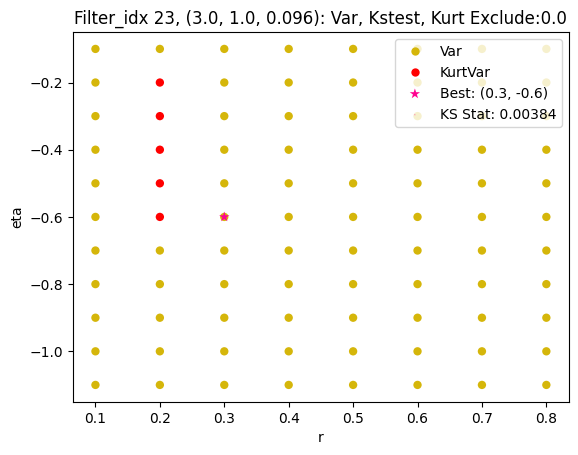

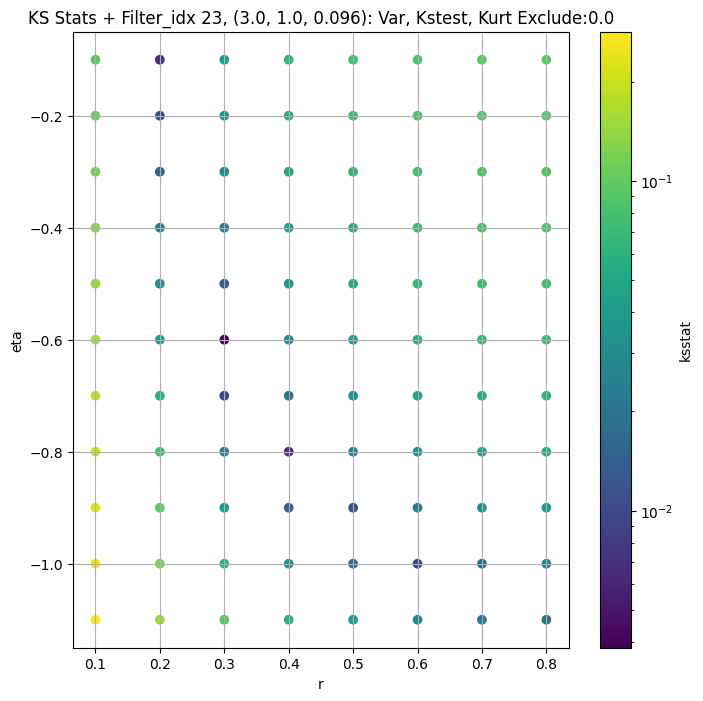

####
Filter_idx, 24: (3.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.0044070446116997175 3101.7693


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.005322980492040441 2869.9678


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.006340590094242038 2736.4858


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.007345888527955424 2542.323
Number of samples: 100000, Without approximation : 262144000.0


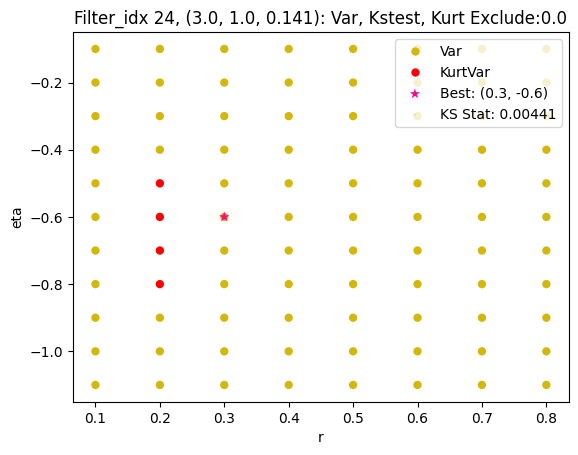

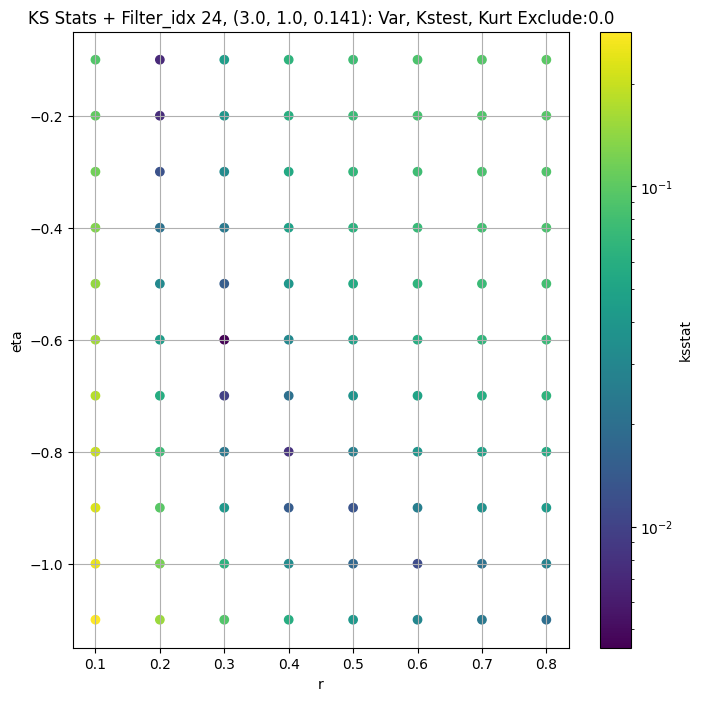

####
Filter_idx, 25: (3.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.004430065136607389 1296.3827


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.00410130428757538 1186.8491


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.006385167371176115 1129.3927


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.007864275076882435 1046.1791
Number of samples: 100000, Without approximation : 262144000.0


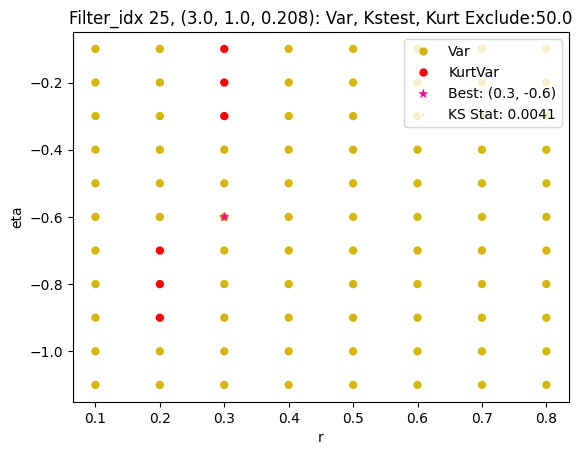

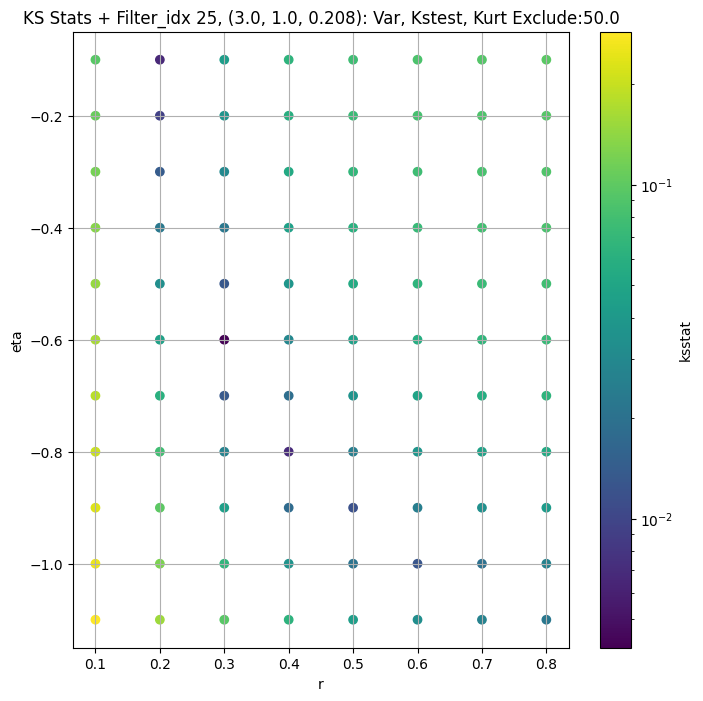

####
Filter_idx, 26: (3.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.004477077206641228 524.2926


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.005539626138657883 477.46835


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.00738133510441602 453.09988


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.007422280496021179 418.69812
Number of samples: 100000, Without approximation : 262144000.0


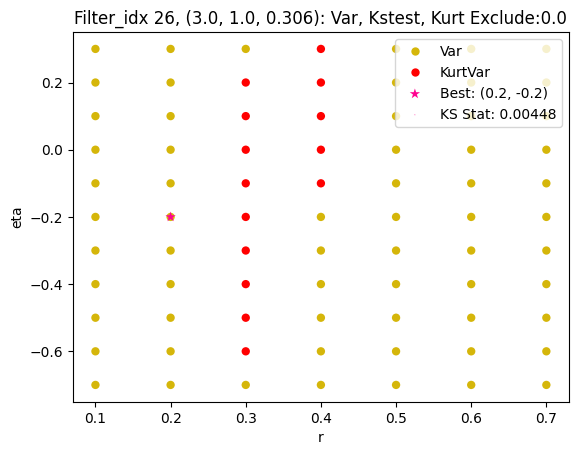

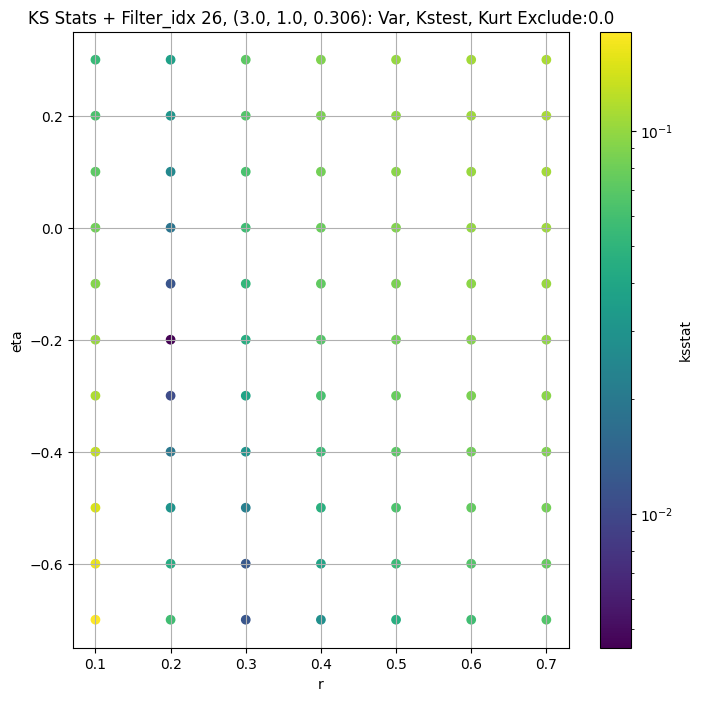

####
Filter_idx, 27: (3.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.0025016216208630926 236.42052


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.004404307481735037 209.56581


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.004585878399310683 196.41385


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.005715993405276287 178.59741
Number of samples: 100000, Without approximation : 262144000.0


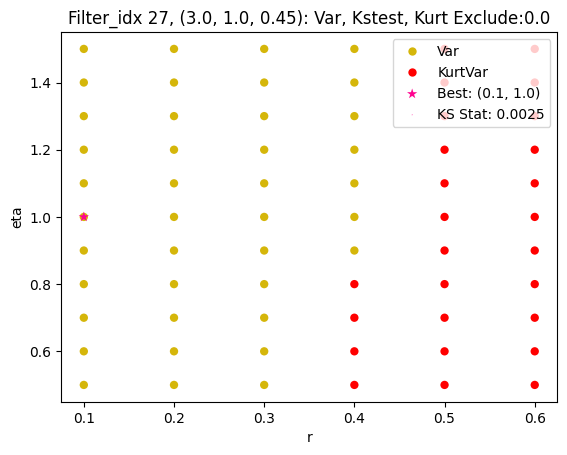

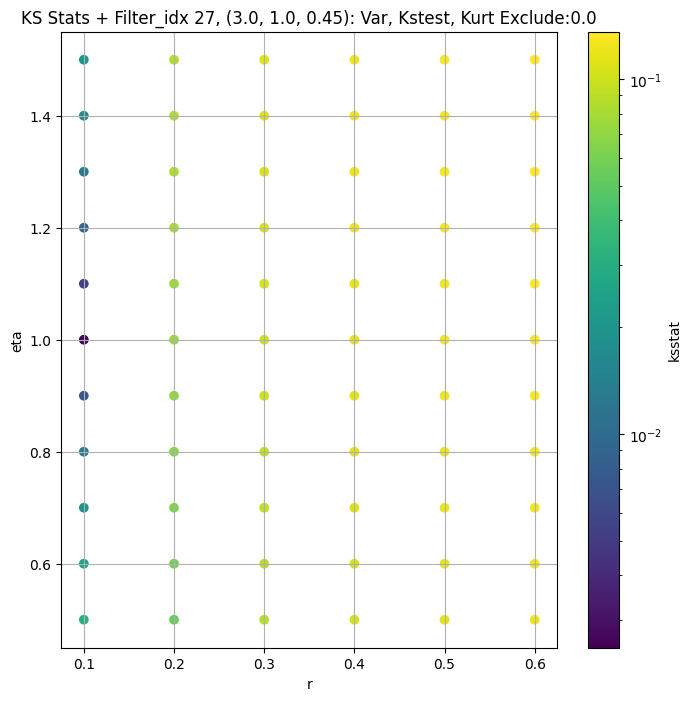

####
Filter_idx, 28: (4.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.0029933969903218616 36045.293


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.004716220014284178 34216.312


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.005701943701036383 33092.992


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.006297888923092569 31360.469
Number of samples: 100000, Without approximation : 262144000.0


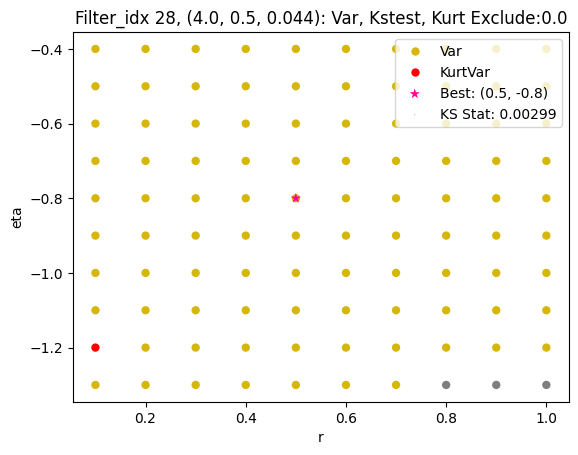

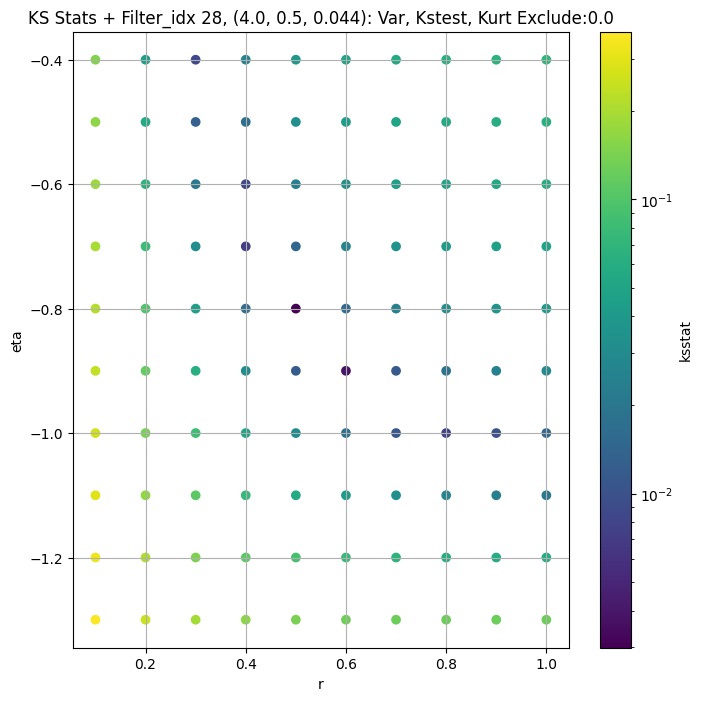

####
Filter_idx, 29: (4.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.0036502010027129606 15223.004


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.004225346568394683 14450.145


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.006107140371523934 13975.565


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.006134228501827432 13242.159
Number of samples: 100000, Without approximation : 262144000.0


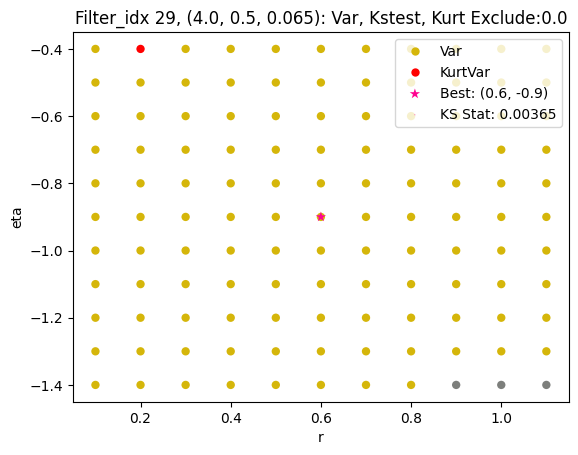

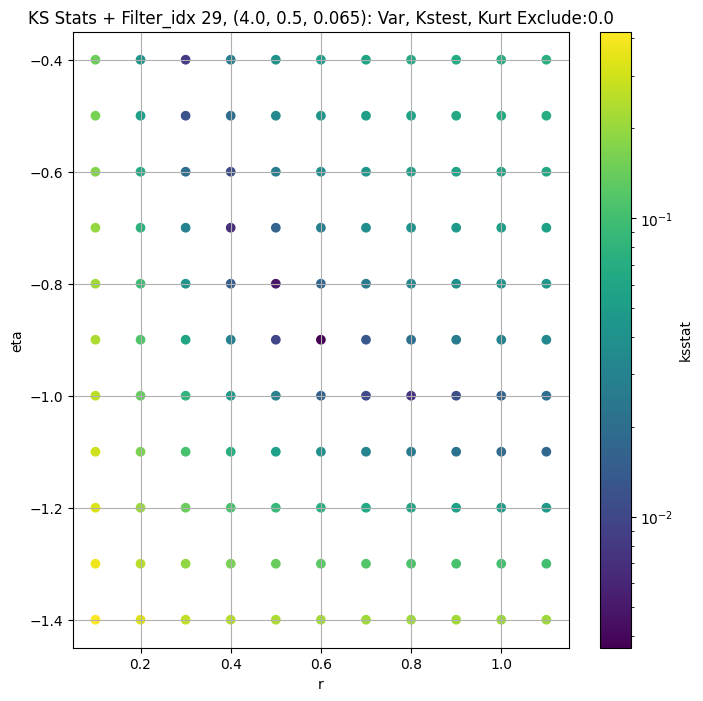

####
Filter_idx, 30: (4.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.004175302782122636 6166.9634


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.0053363550485315825 5835.0444


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.005056183623218691 5633.6113


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.007396881460937532 5325.2734
Number of samples: 100000, Without approximation : 262144000.0


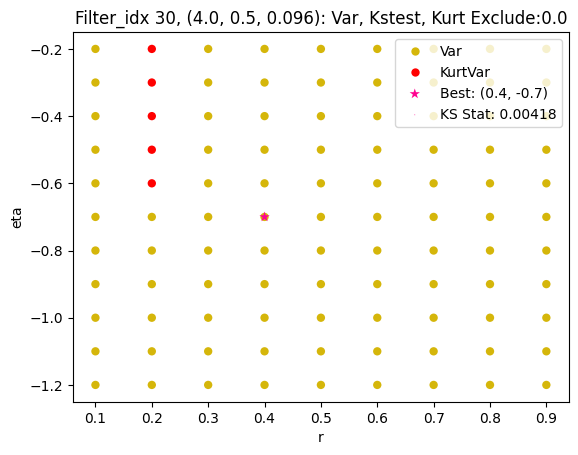

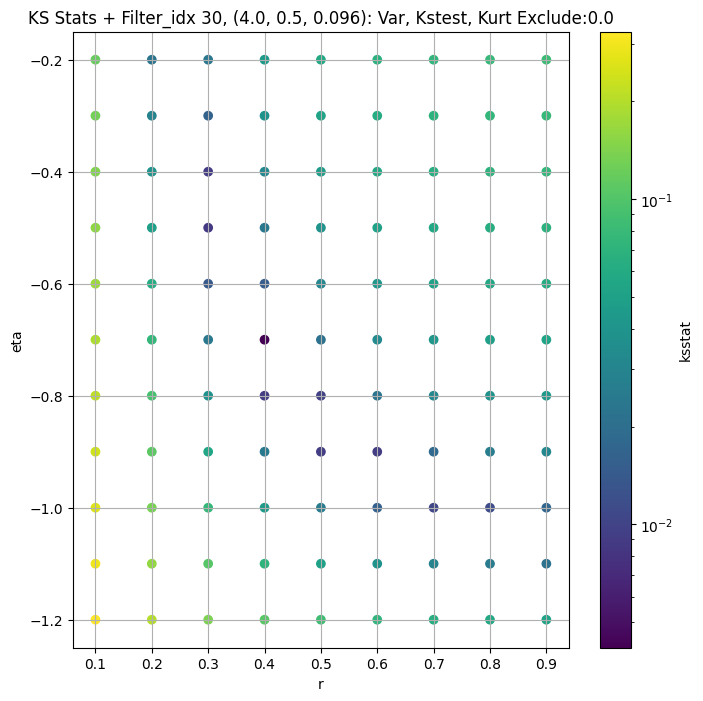

####
Filter_idx, 31: (4.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.005327562503742778 2597.6184


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.007735826398521439 2413.9653


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.0064952732463752355 2318.8503


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.006077854025571372 2176.5557
Number of samples: 100000, Without approximation : 262144000.0


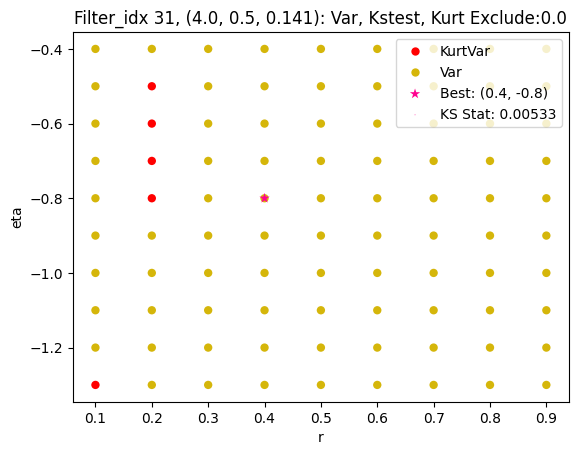

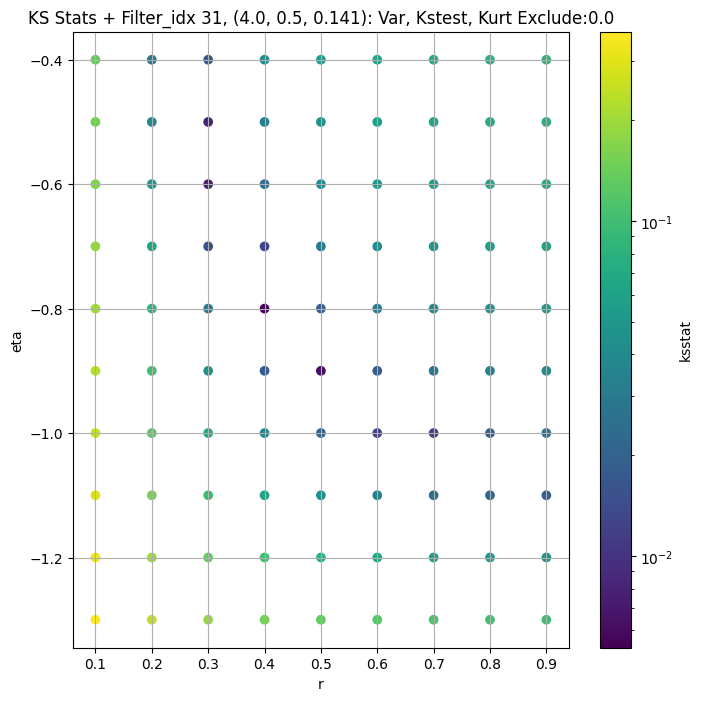

####
Filter_idx, 32: (4.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.004634842810959994 1120.9692


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.006261474712715265 1032.3436


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.007339243944389895 987.251


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.007759325885021373 922.46826
Number of samples: 100000, Without approximation : 262144000.0


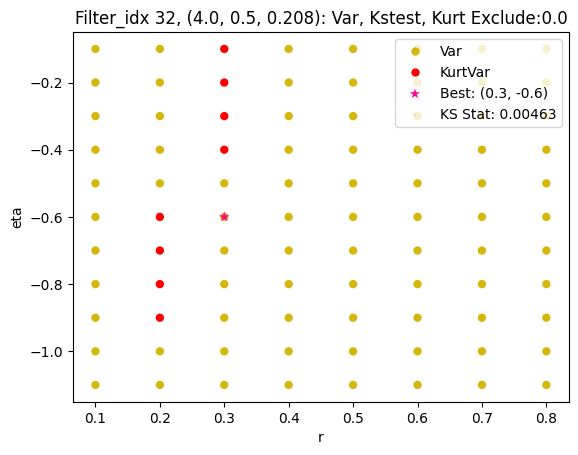

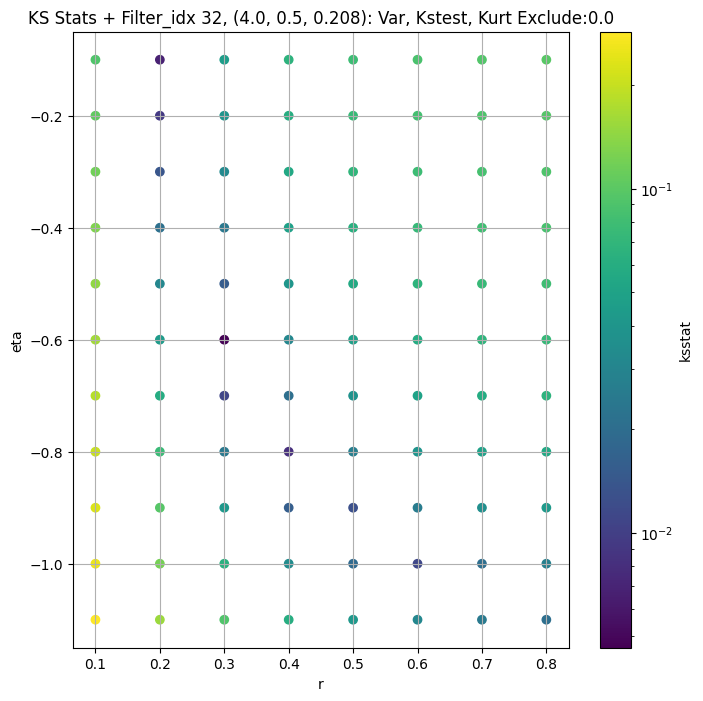

####
Filter_idx, 33: (4.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.005466602115982322 459.00717


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.0065042540274871385 417.92197


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.00624794030275605 397.99948


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.007912073207976877 369.40427
Number of samples: 100000, Without approximation : 262144000.0


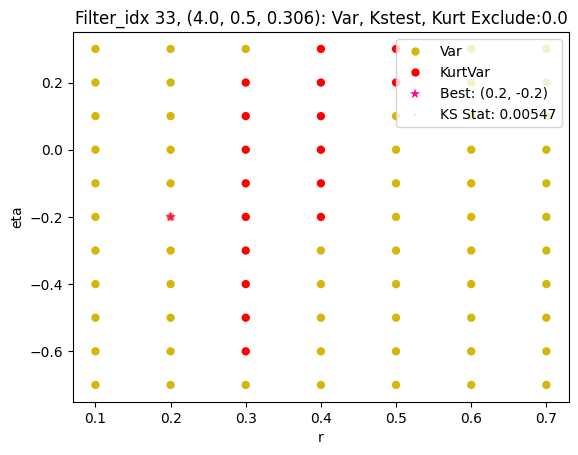

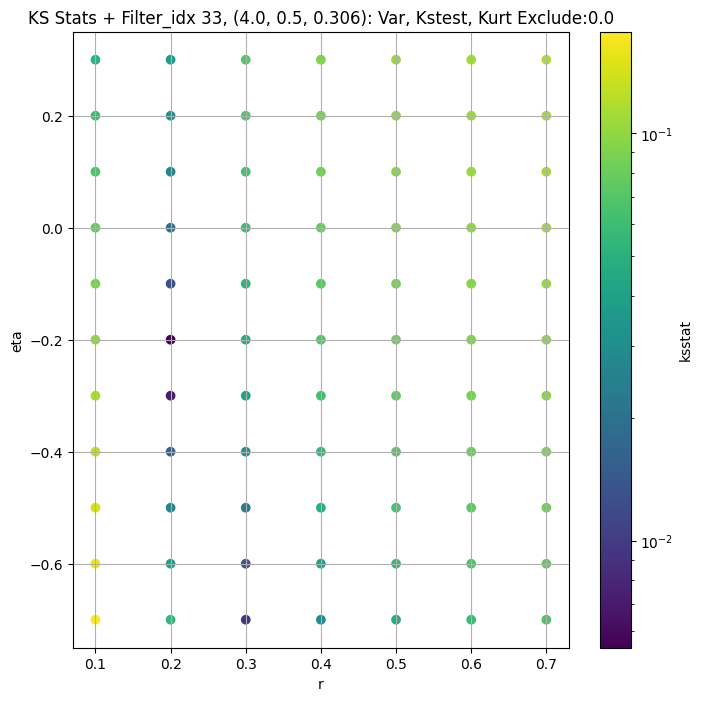

####
Filter_idx, 34: (4.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.004469338519134336 199.43762


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.004881313035034016 181.952


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.004465906278164566 172.91379


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.005777680504779892 159.64507
Number of samples: 100000, Without approximation : 262144000.0


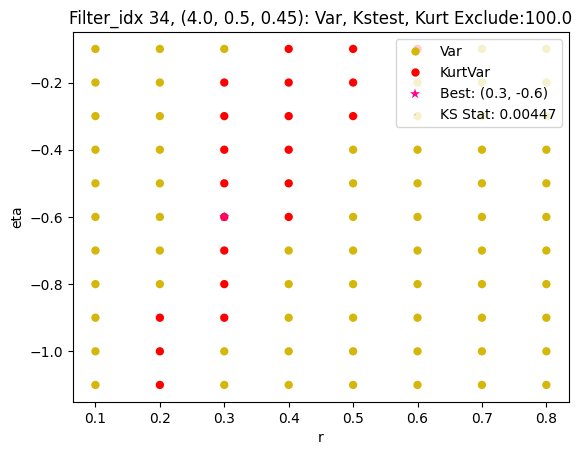

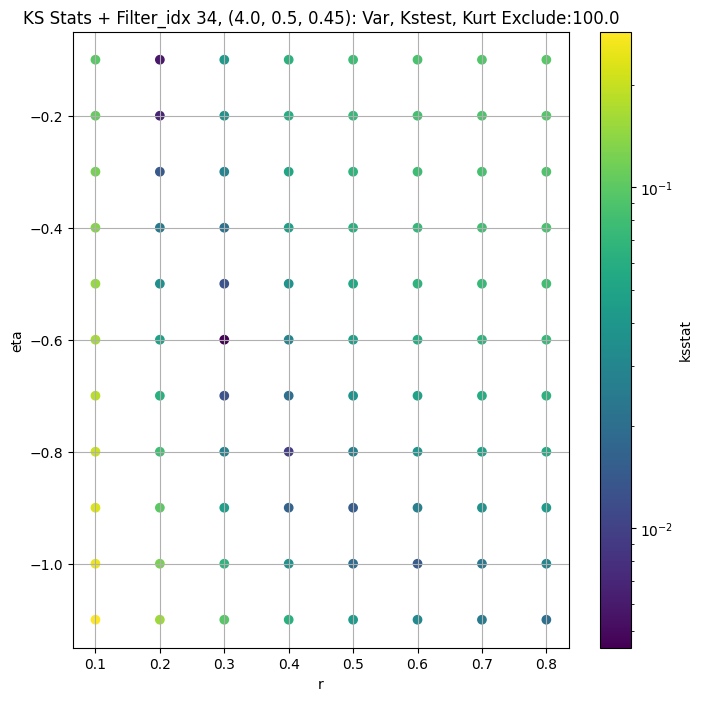

####
Filter_idx, 35: (4.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.0046018769444257646 43595.16


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.004376667231461073 40620.33


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.0038928826709227413 38901.453


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.0045012068823512 36320.56
Number of samples: 100000, Without approximation : 262144000.0


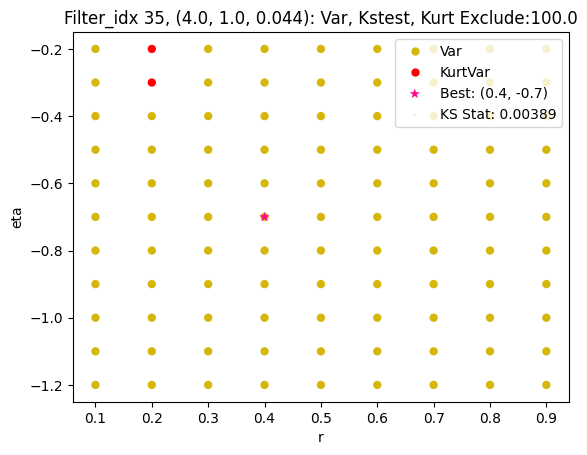

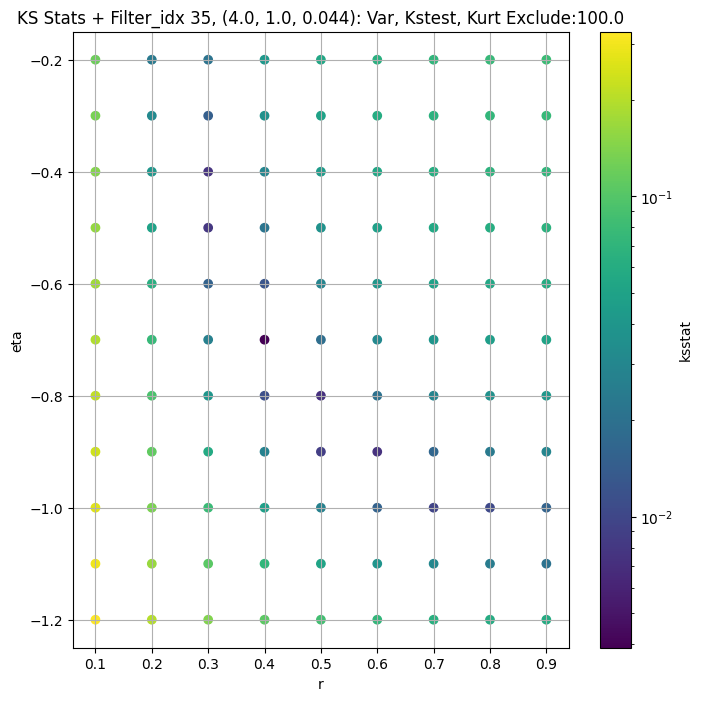

####
Filter_idx, 36: (4.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 0 0.0016753765575957397 18127.322


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 50 0.00472701812127968 16848.295


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 100 0.005227701994206524 16073.905


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 200 0.005820055670072155 14941.999
Number of samples: 100000, Without approximation : 262144000.0


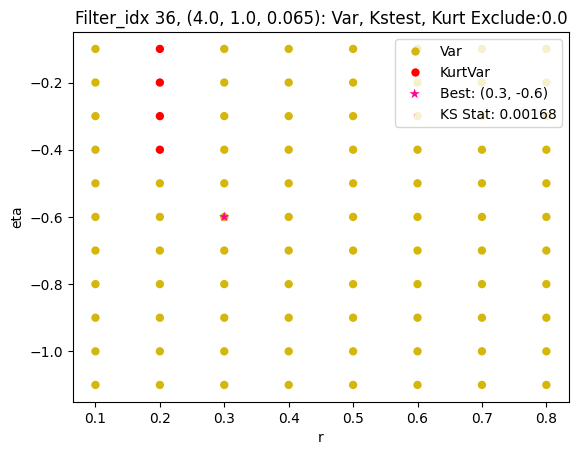

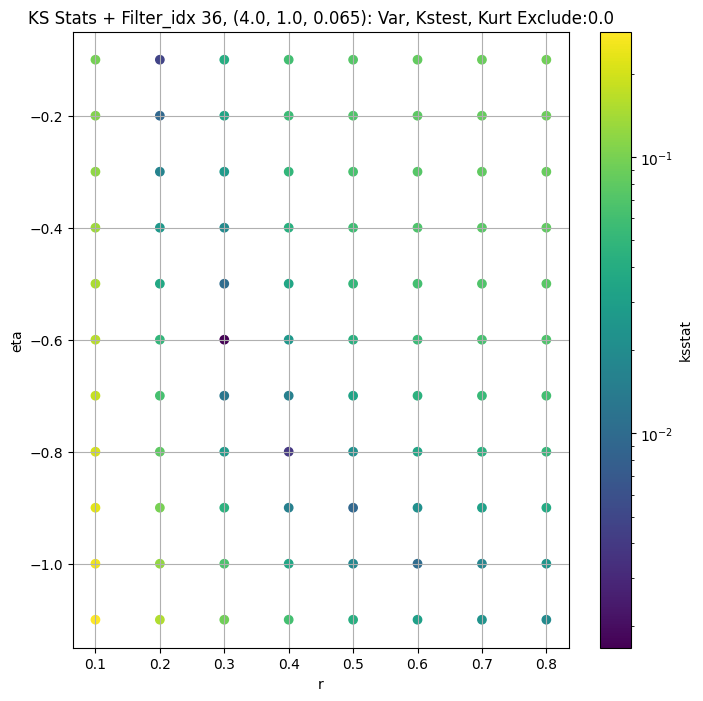

####
Filter_idx, 37: (4.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.002947634400220389 7172.945


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.005410036951031316 6630.3447


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.0045347167412934375 6318.7646


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.00538719687743755 5863.6245
Number of samples: 100000, Without approximation : 262144000.0


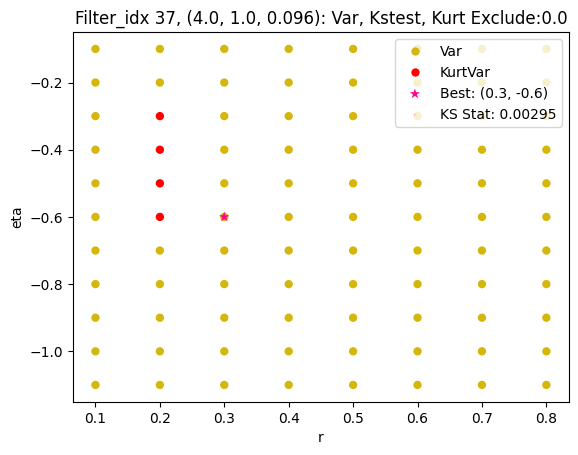

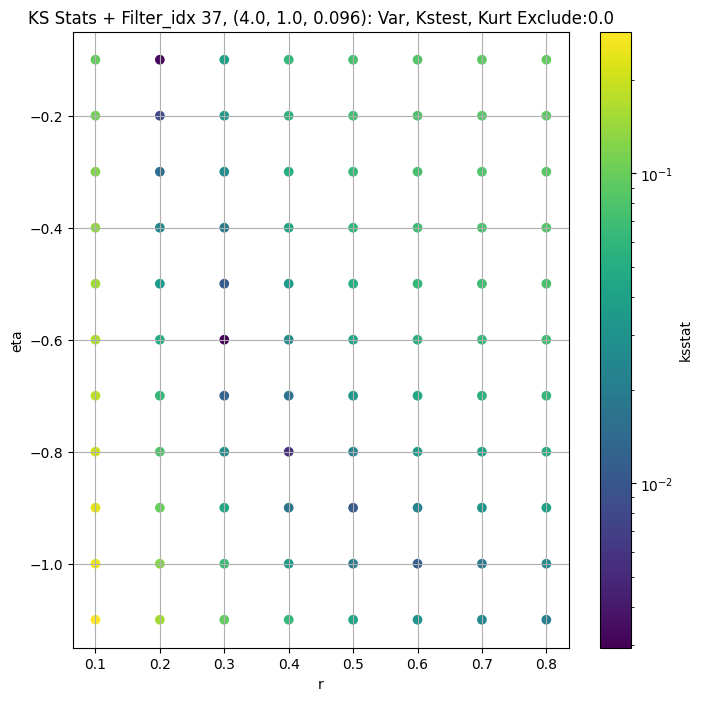

####
Filter_idx, 38: (4.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.003361614682655306 3011.581


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.0031559283087406187 2729.693


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.005847170646804234 2589.3296


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.006711238674837583 2388.9534
Number of samples: 100000, Without approximation : 262144000.0


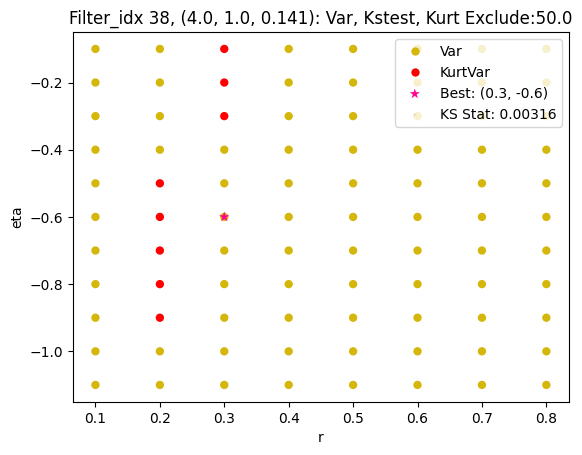

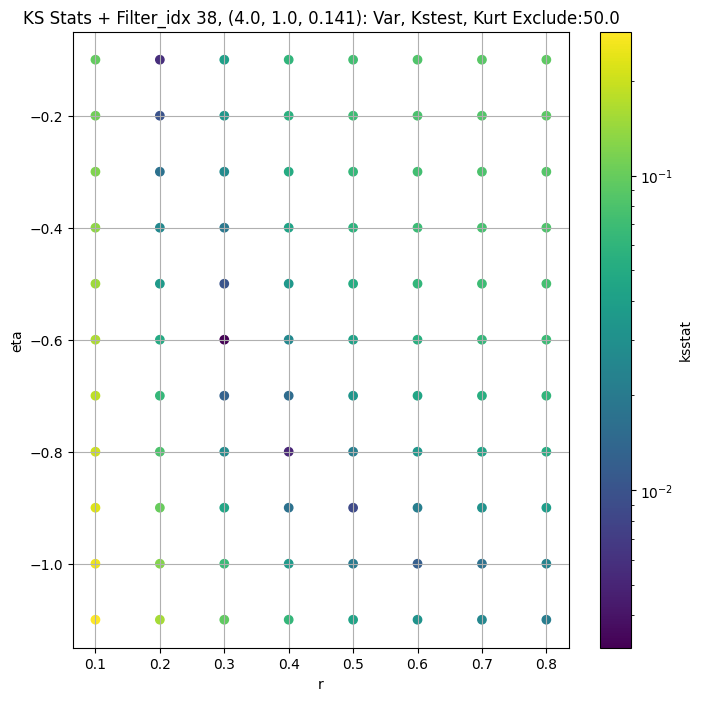

####
Filter_idx, 39: (4.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.002710107227219094 1211.0612


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.00429131106596764 1098.0162


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.005630087962290475 1041.5358


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.006919720488894186 960.7457
Number of samples: 100000, Without approximation : 262144000.0


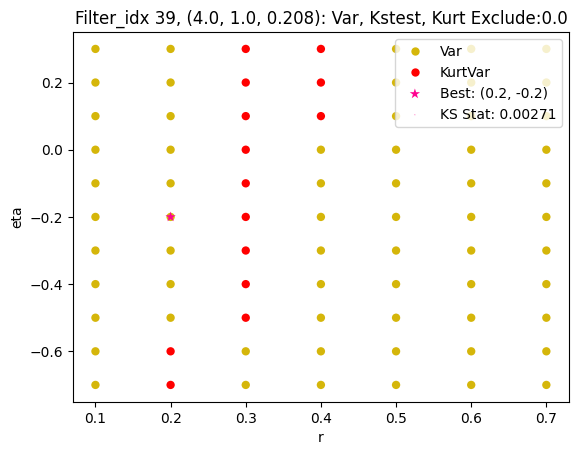

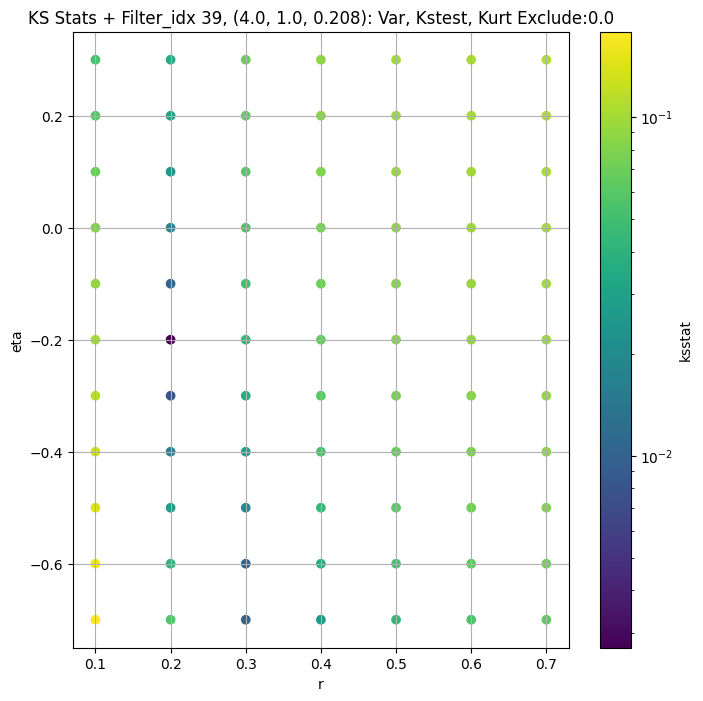

####
Filter_idx, 40: (4.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.003860239162306156 498.97977


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.00418605348029899 445.62836


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.005103290402181104 420.4473


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.0073697116403091956 385.32452
Number of samples: 100000, Without approximation : 262144000.0


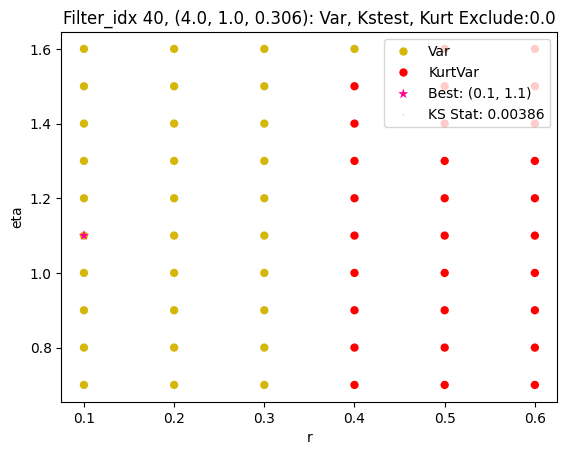

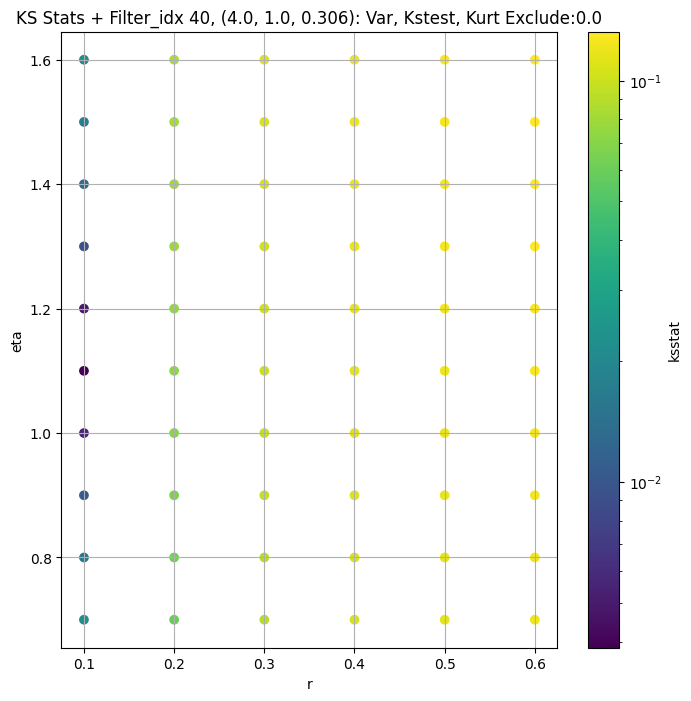

####
Filter_idx, 41: (4.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.0022891938151897717 205.20663


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.002950223854669809 178.22855


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.004290978416477187 166.2289


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.005020972943126478 150.30794
Number of samples: 100000, Without approximation : 262144000.0


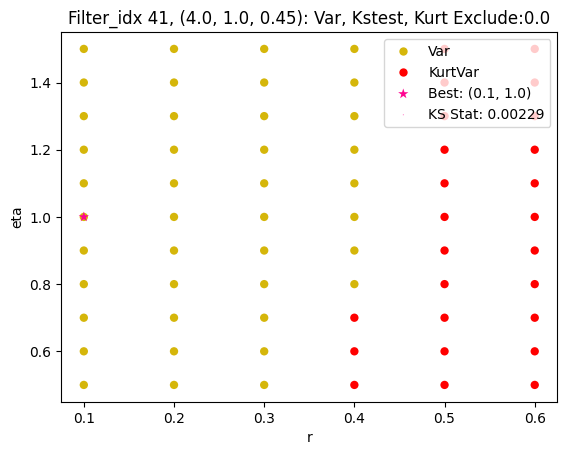

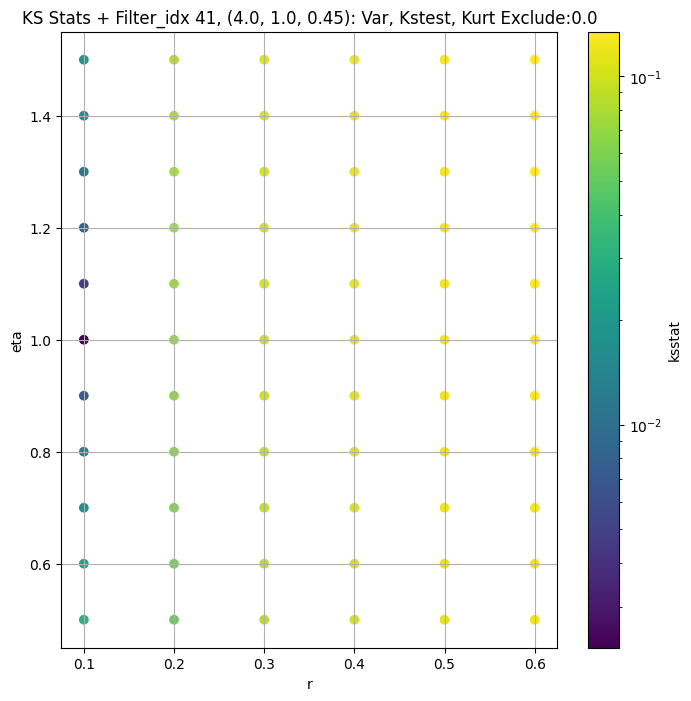

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",38141.09400,29741.96500,47408.02300,5.545877,3.051156,15.768338,262144000.0,"(2.0, 0.5, 0.044)",0.004411,0.7,-0.9,3.645792e+04,0.0,38141.09400,0.000084
1,"(2.0, 0.5, 0.065)",16323.57900,12823.37800,20713.02000,6.197828,3.286204,19.461838,262144000.0,"(2.0, 0.5, 0.065)",0.004968,0.6,-0.9,1.084929e+04,0.0,16323.57900,0.000084
2,"(2.0, 0.5, 0.096)",6576.69800,5205.66200,8263.79100,6.400652,3.229711,17.005306,262144000.0,"(2.0, 0.5, 0.096)",0.004718,0.7,-0.9,5.844751e+03,100.0,6114.58940,0.000084
3,"(2.0, 0.5, 0.141)",2797.85910,2166.36350,3563.50500,7.264324,3.640300,21.403347,262144000.0,"(2.0, 0.5, 0.141)",0.003138,0.5,-0.8,8.326962e+02,0.0,2797.85910,0.000084
4,"(2.0, 0.5, 0.208)",1152.82480,876.24927,1451.83330,8.286530,4.267028,29.099030,262144000.0,"(2.0, 0.5, 0.208)",0.005470,0.4,-0.7,9.911036e+01,0.0,1152.82480,0.000084
5,"(2.0, 0.5, 0.306)",415.59400,313.29500,537.46234,9.865244,4.211713,37.117893,262144000.0,"(2.0, 0.5, 0.306)",0.005197,0.3,-0.5,2.967821e+00,0.0,415.59400,0.000084
6,"(2.0, 0.5, 0.45)",279.85425,209.98505,375.27567,9.890322,4.796311,35.474228,262144000.0,"(2.0, 0.5, 0.45)",0.004549,0.3,-0.5,1.998482e+00,0.0,279.85425,0.000084
7,"(2.0, 1.0, 0.044)",54288.89500,43416.72300,68531.04000,6.410547,3.334382,19.243261,262144000.0,"(2.0, 1.0, 0.044)",0.004035,0.7,-0.9,5.189311e+04,0.0,54288.89500,0.000084
8,"(2.0, 1.0, 0.065)",21606.79500,16645.76000,27949.41000,7.674028,3.695609,25.068642,262144000.0,"(2.0, 1.0, 0.065)",0.002485,0.5,-0.8,6.430594e+03,0.0,21606.79500,0.000084


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()}, {group}: {str(filter_group_map[group])}")
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    # new: add parameter information
    master_df.insert(0, 'params', master_df.index.map(filter_group_map))

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0, (2.0, 0.5, 0.044):


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 0, 0.0 + 100 = 100, ksstat: 0.005053029302715228, var: 35696.36328125


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 0, 0.0 + 75 = 75, ksstat: 0.004534229014484525, var: 36160.8203125


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 0, 0.0 + 50 = 50, ksstat: 0.004259838159010883, var: 36672.796875


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 0, 0.0 + 25 = 25, ksstat: 0.003951286016869282, var: 37263.94921875


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 0, 0.0 + 0 = 0, ksstat: 0.003975627227019052, var: 38141.09375
Number of samples: 100000, Without approximation : 262144000.0


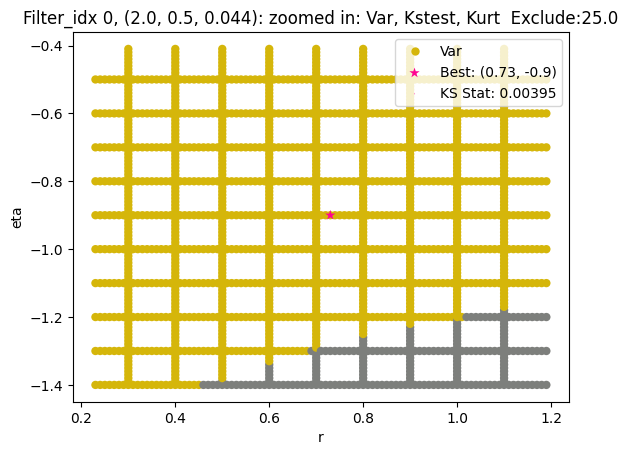

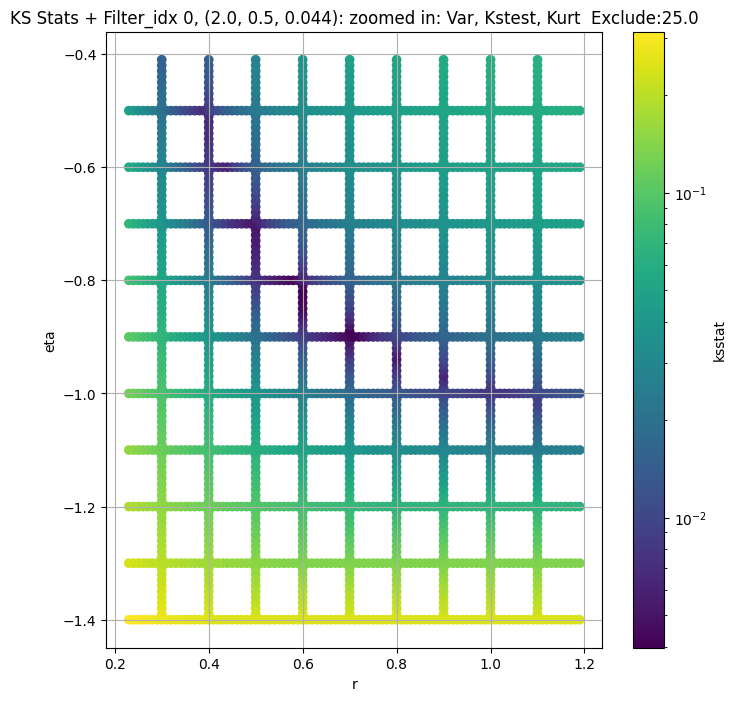

Filter_idx 1, (2.0, 0.5, 0.065):


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 1, 0.0 + 100 = 100, ksstat: 0.004521056014669393, var: 15204.6005859375


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 1, 0.0 + 75 = 75, ksstat: 0.004313510106947138, var: 15418.064453125


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 1, 0.0 + 50 = 50, ksstat: 0.00399802453308943, var: 15653.87109375


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 1, 0.0 + 25 = 25, ksstat: 0.003574837157855587, var: 15924.7509765625


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 1, 0.0 + 0 = 0, ksstat: 0.003216238805741456, var: 16323.5791015625
Number of samples: 100000, Without approximation : 262144000.0


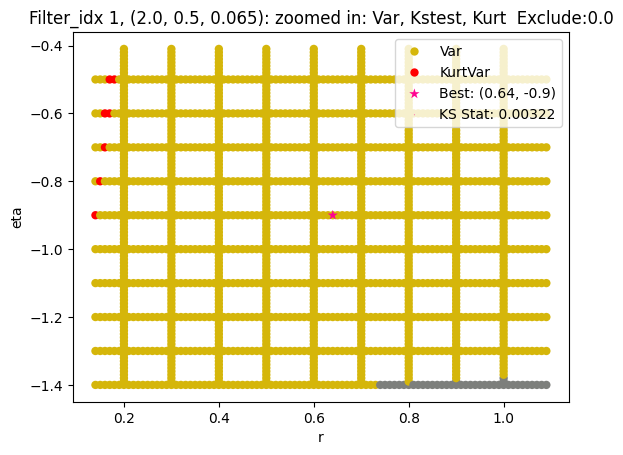

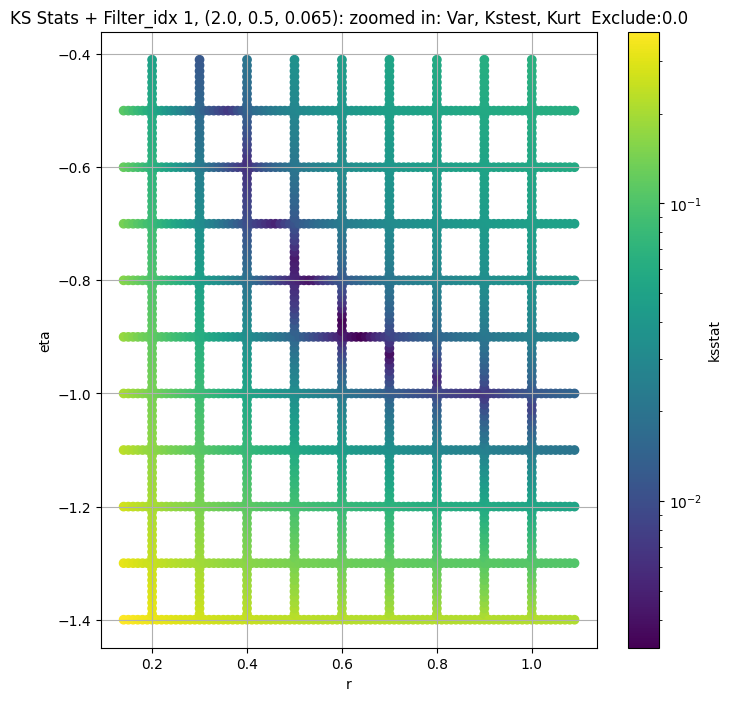

Filter_idx 2, (2.0, 0.5, 0.096):


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 2, 100.0 + 100 = 200, ksstat: 0.005514739608562434, var: 5823.11572265625


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 2, 100.0 + 75 = 175, ksstat: 0.0053352312456089734, var: 5889.67578125


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 2, 100.0 + 50 = 150, ksstat: 0.005049859569616122, var: 5959.93505859375


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 2, 100.0 + 25 = 125, ksstat: 0.0045760089805033655, var: 6034.59619140625


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 2, 100.0 + 0 = 100, ksstat: 0.004596808366686966, var: 6114.58935546875


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 2, 100.0 + -25 = 75, ksstat: 0.004179987772675586, var: 6201.509765625


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 2, 100.0 + -50 = 50, ksstat: 0.0038127076248141156, var: 6298.10498046875


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 2, 100.0 + -75 = 25, ksstat: 0.0036767109441291357, var: 6410.25537109375


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 2, 100.0 + -100 = 0, ksstat: 0.003171188875270625, var: 6576.6982421875
Number of samples: 100000, Without approximation : 262144000.0


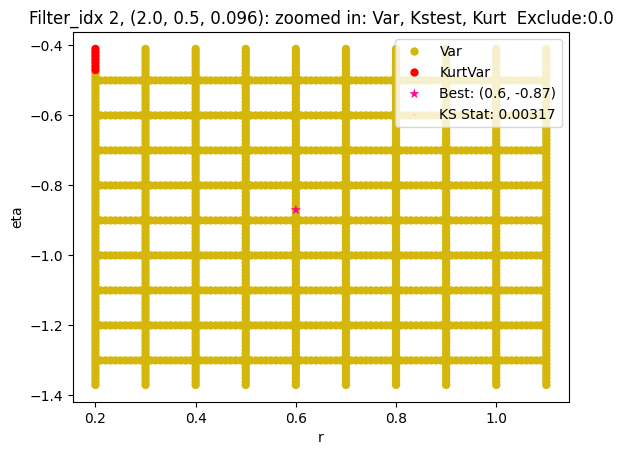

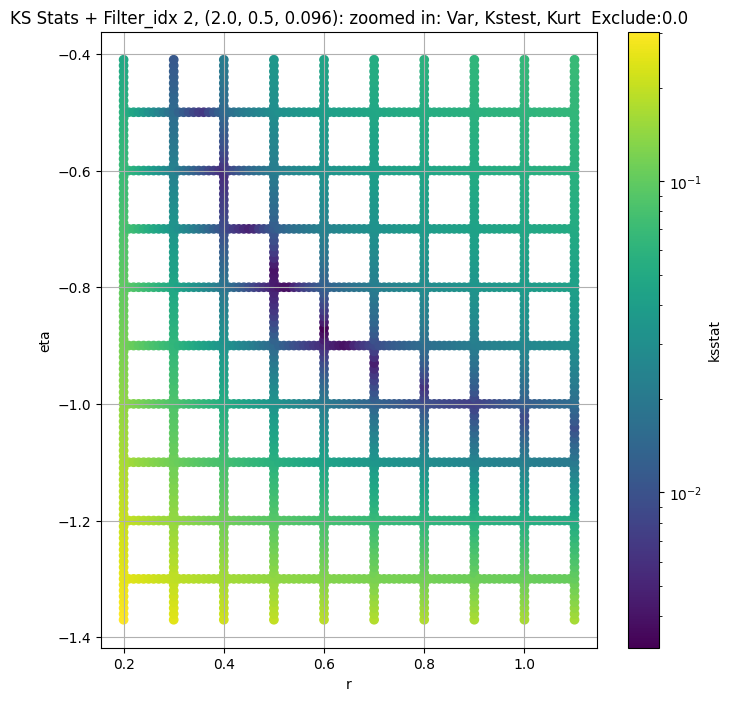

Filter_idx 3, (2.0, 0.5, 0.141):


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 3, 0.0 + 100 = 100, ksstat: 0.00436866013767917, var: 2583.4033203125


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 3, 0.0 + 75 = 75, ksstat: 0.004387482704191092, var: 2623.139404296875


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 3, 0.0 + 50 = 50, ksstat: 0.0038728507012282254, var: 2667.4716796875


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 3, 0.0 + 25 = 25, ksstat: 0.003856477127278546, var: 2719.300048828125


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 3, 0.0 + 0 = 0, ksstat: 0.00313804141267926, var: 2797.859130859375
Number of samples: 100000, Without approximation : 262144000.0


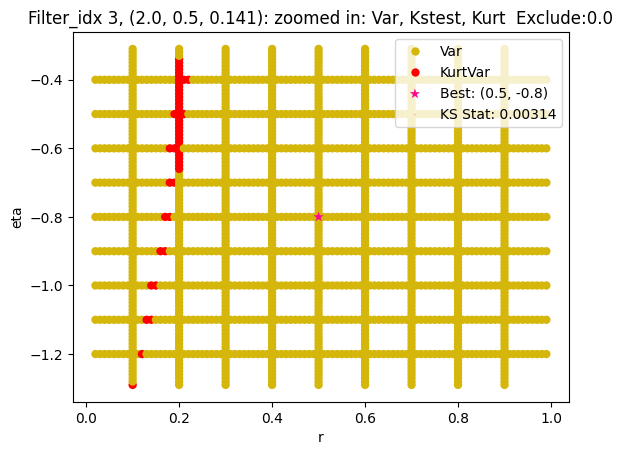

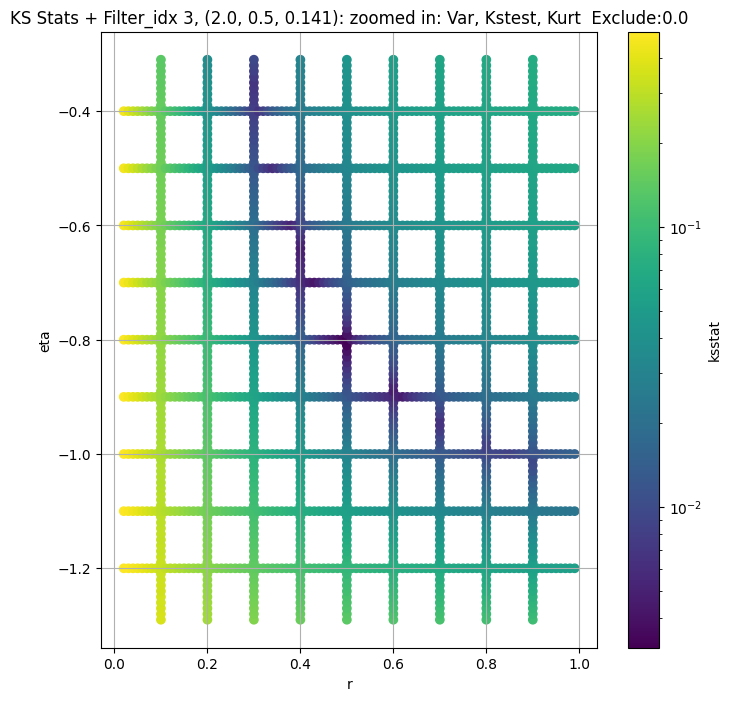

Filter_idx 4, (2.0, 0.5, 0.208):


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 4, 0.0 + 100 = 100, ksstat: 0.005798226567707752, var: 1056.982177734375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 4, 0.0 + 75 = 75, ksstat: 0.005348339108442242, var: 1074.3546142578125


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 4, 0.0 + 50 = 50, ksstat: 0.004688416393451744, var: 1093.903076171875


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 4, 0.0 + 25 = 25, ksstat: 0.004537316624351029, var: 1117.0828857421875


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 4, 0.0 + 0 = 0, ksstat: 0.004319664186543171, var: 1152.8248291015625
Number of samples: 100000, Without approximation : 262144000.0


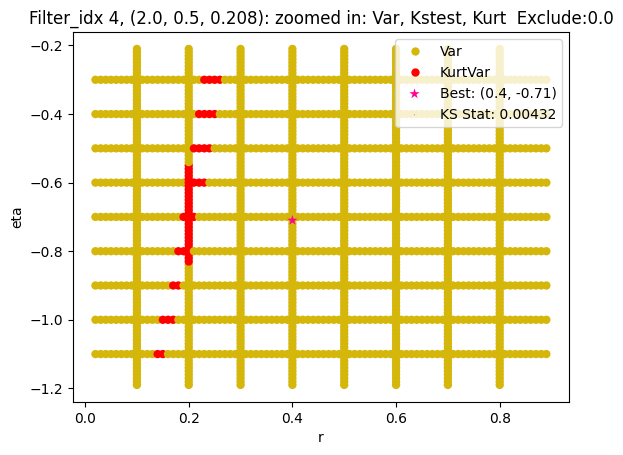

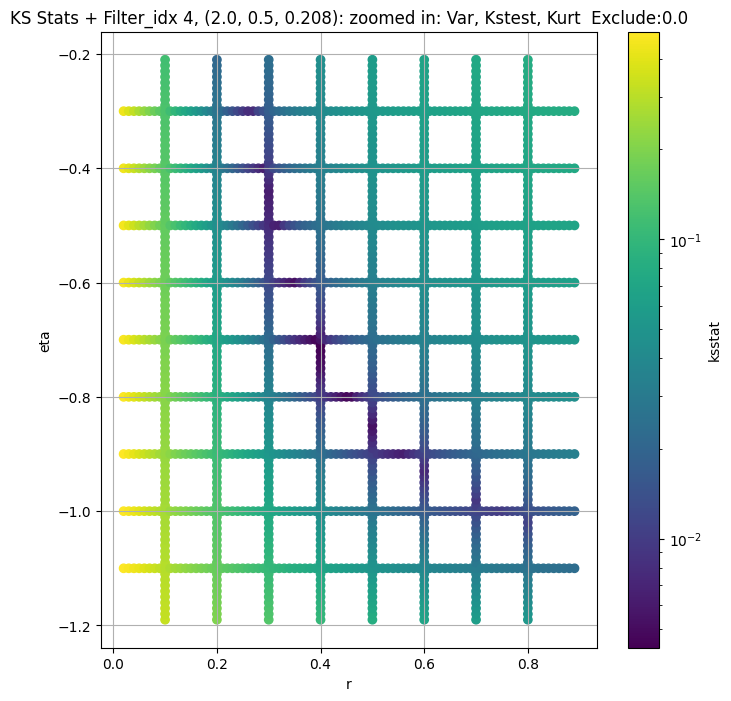

Filter_idx 5, (2.0, 0.5, 0.306):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 0.0 + 100 = 100, ksstat: 0.004825353050629914, var: 376.9702453613281


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 0.0 + 75 = 75, ksstat: 0.0043751074905602205, var: 383.8885498046875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 0.0 + 50 = 50, ksstat: 0.004113338091665919, var: 391.7129211425781


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 0.0 + 25 = 25, ksstat: 0.003671466607219044, var: 400.9562683105469


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 0.0 + 0 = 0, ksstat: 0.0034853678497327456, var: 415.593994140625
Number of samples: 100000, Without approximation : 262144000.0


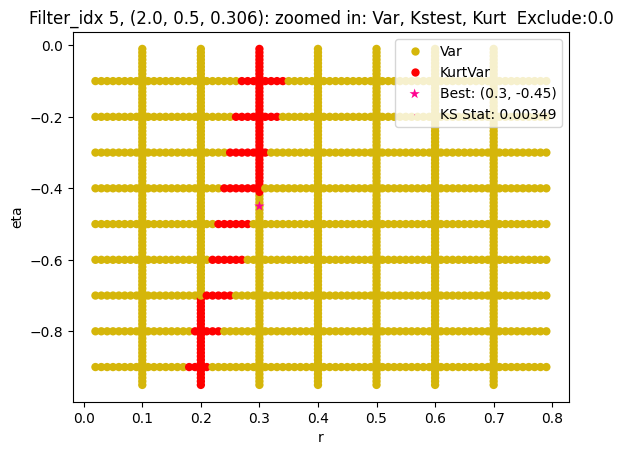

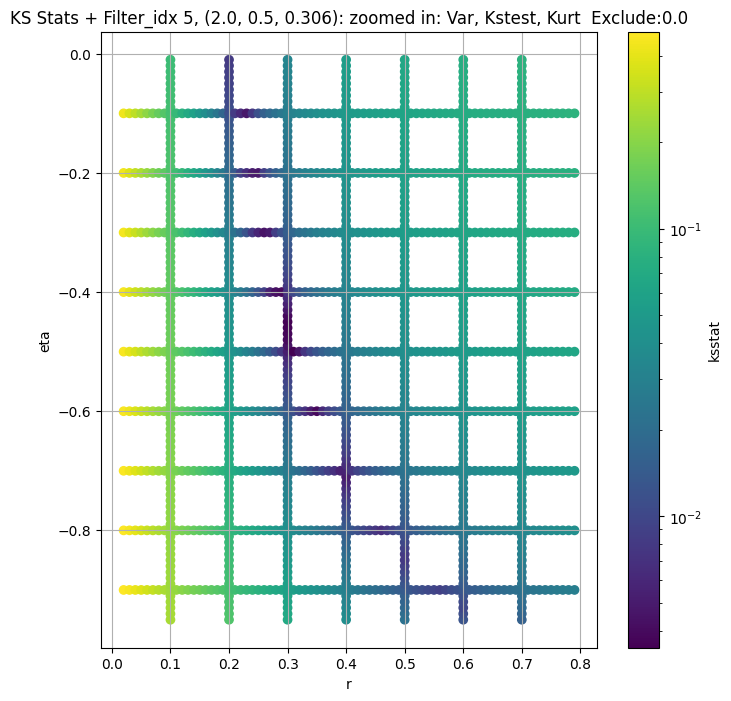

Filter_idx 6, (2.0, 0.5, 0.45):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 6, 0.0 + 100 = 100, ksstat: 0.004592247069457156, var: 254.04837036132812


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 6, 0.0 + 75 = 75, ksstat: 0.00419425645226057, var: 258.7204284667969


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 6, 0.0 + 50 = 50, ksstat: 0.003965618512257629, var: 263.9735412597656


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 6, 0.0 + 25 = 25, ksstat: 0.003653671474202591, var: 270.1492614746094


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 6, 0.0 + 0 = 0, ksstat: 0.002920597837291254, var: 279.854248046875
Number of samples: 100000, Without approximation : 262144000.0


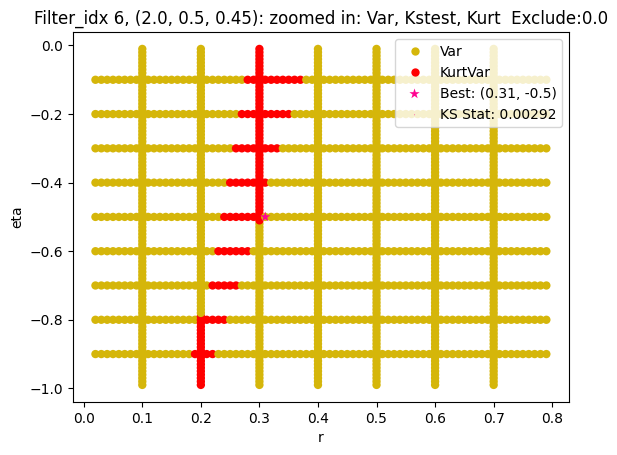

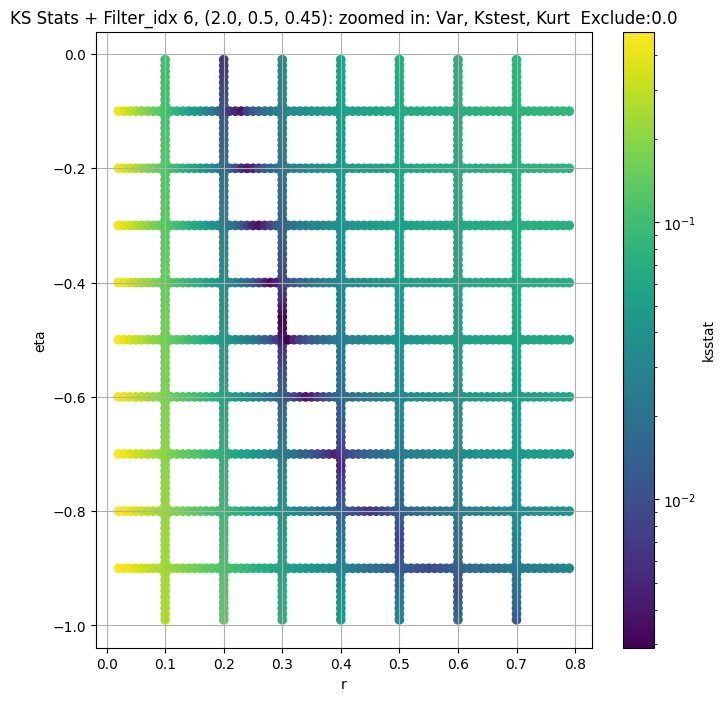

Filter_idx 7, (2.0, 1.0, 0.044):


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 7, 0.0 + 100 = 100, ksstat: 0.004125092286939691, var: 50359.734375


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 7, 0.0 + 75 = 75, ksstat: 0.0037113657563141444, var: 51079.109375


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 7, 0.0 + 50 = 50, ksstat: 0.0033088615217948814, var: 51886.3984375


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 7, 0.0 + 25 = 25, ksstat: 0.003302997848804723, var: 52834.41015625


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 7, 0.0 + 0 = 0, ksstat: 0.0024895714505809435, var: 54288.89453125
Number of samples: 100000, Without approximation : 262144000.0


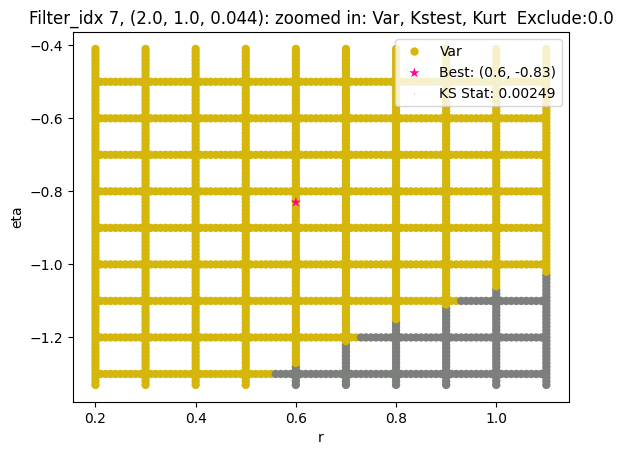

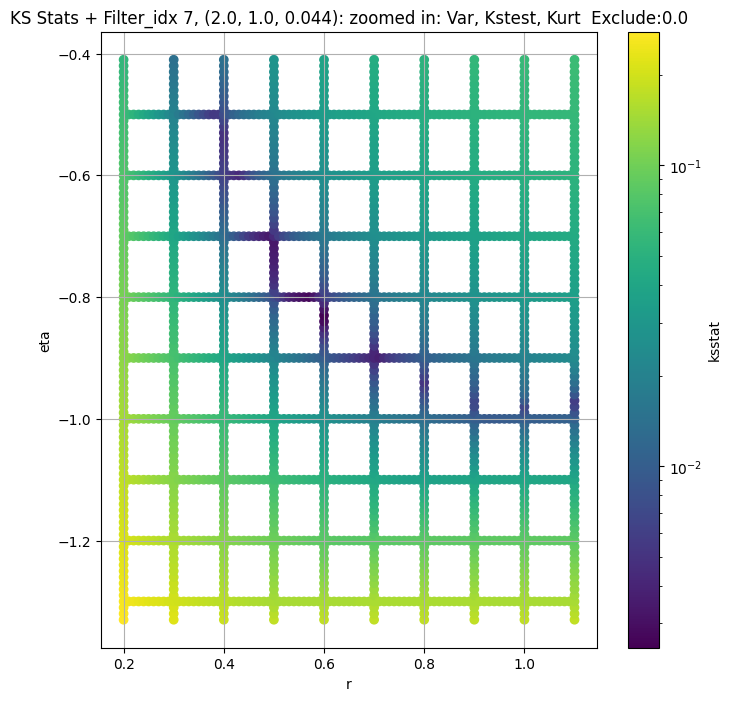

Filter_idx 8, (2.0, 1.0, 0.065):


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 8, 0.0 + 100 = 100, ksstat: 0.004098171893586855, var: 19878.46484375


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 8, 0.0 + 75 = 75, ksstat: 0.003907141020697336, var: 20193.95703125


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 8, 0.0 + 50 = 50, ksstat: 0.003399052194925721, var: 20549.6328125


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 8, 0.0 + 25 = 25, ksstat: 0.0032967742490655275, var: 20968.712890625


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 8, 0.0 + 0 = 0, ksstat: 0.0024851532996538334, var: 21606.794921875
Number of samples: 100000, Without approximation : 262144000.0


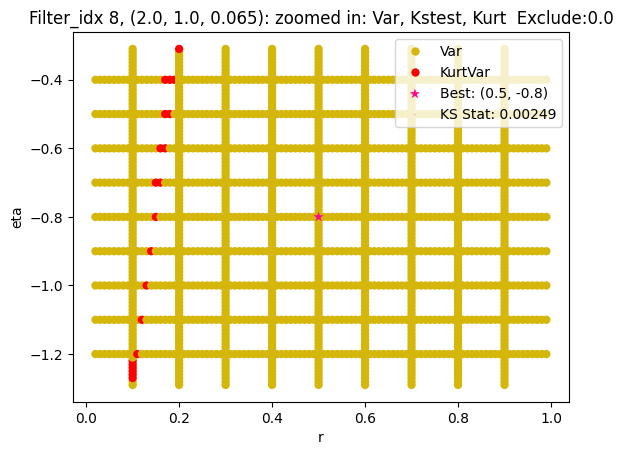

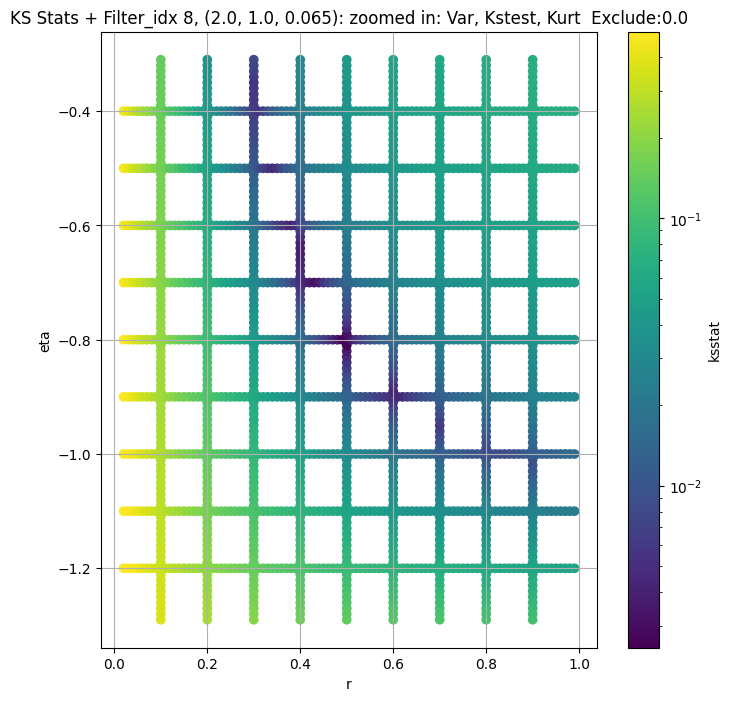

Filter_idx 9, (2.0, 1.0, 0.096):


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 9, 0.0 + 100 = 100, ksstat: 0.004036924152905685, var: 8258.021484375


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 9, 0.0 + 75 = 75, ksstat: 0.0034708487659932605, var: 8392.2509765625


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 9, 0.0 + 50 = 50, ksstat: 0.003303351286292888, var: 8543.4033203125


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 9, 0.0 + 25 = 25, ksstat: 0.002658331945900372, var: 8721.4560546875


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 9, 0.0 + 0 = 0, ksstat: 0.002502236754903131, var: 8995.3173828125
Number of samples: 100000, Without approximation : 262144000.0


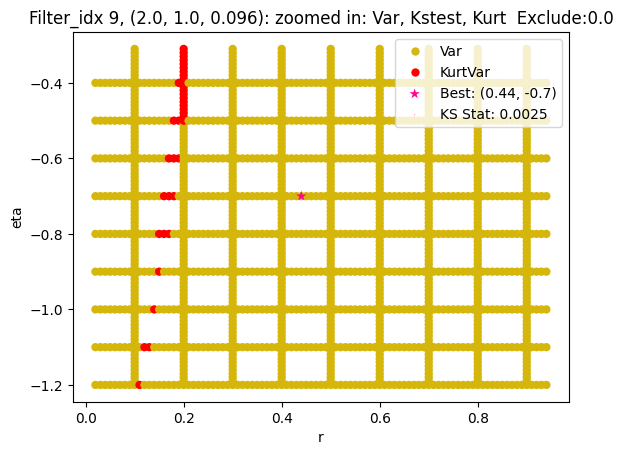

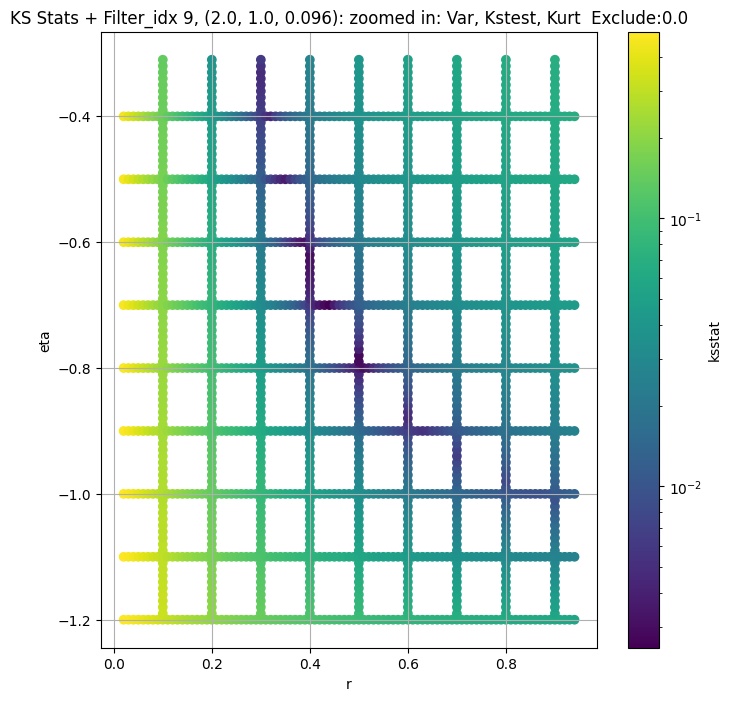

Filter_idx 10, (2.0, 1.0, 0.141):


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 10, 0.0 + 100 = 100, ksstat: 0.0036990993672844086, var: 3489.14111328125


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 10, 0.0 + 75 = 75, ksstat: 0.003375049104204081, var: 3547.531494140625


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 10, 0.0 + 50 = 50, ksstat: 0.003021238680277649, var: 3613.960205078125


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 10, 0.0 + 25 = 25, ksstat: 0.002711476815172753, var: 3693.3212890625


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 10, 0.0 + 0 = 0, ksstat: 0.0019596533028614083, var: 3820.5478515625
Number of samples: 100000, Without approximation : 262144000.0


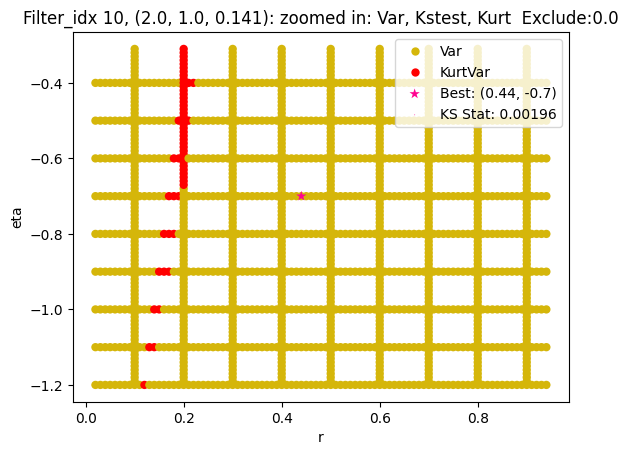

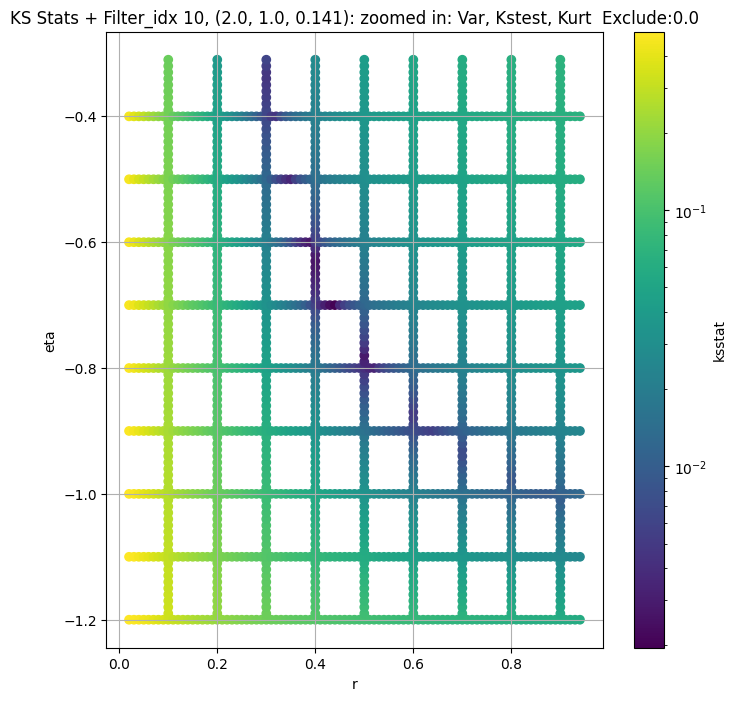

Filter_idx 11, (2.0, 1.0, 0.208):


  0%|          | 0/1269 [00:00<?, ?it/s]

Finding Minimum after computing 1269 CDFs
filter_idx 11, 0.0 + 100 = 100, ksstat: 0.004221926997710339, var: 1432.3843994140625


  0%|          | 0/1269 [00:00<?, ?it/s]

Finding Minimum after computing 1269 CDFs
filter_idx 11, 0.0 + 75 = 75, ksstat: 0.003760018363198052, var: 1457.4189453125


  0%|          | 0/1269 [00:00<?, ?it/s]

Finding Minimum after computing 1269 CDFs
filter_idx 11, 0.0 + 50 = 50, ksstat: 0.003802249531901114, var: 1485.862060546875


  0%|          | 0/1269 [00:00<?, ?it/s]

Finding Minimum after computing 1269 CDFs
filter_idx 11, 0.0 + 25 = 25, ksstat: 0.003296910911624318, var: 1520.086181640625


  0%|          | 0/1269 [00:00<?, ?it/s]

Finding Minimum after computing 1269 CDFs
filter_idx 11, 0.0 + 0 = 0, ksstat: 0.0026674977912806153, var: 1576.0858154296875
Number of samples: 100000, Without approximation : 262144000.0


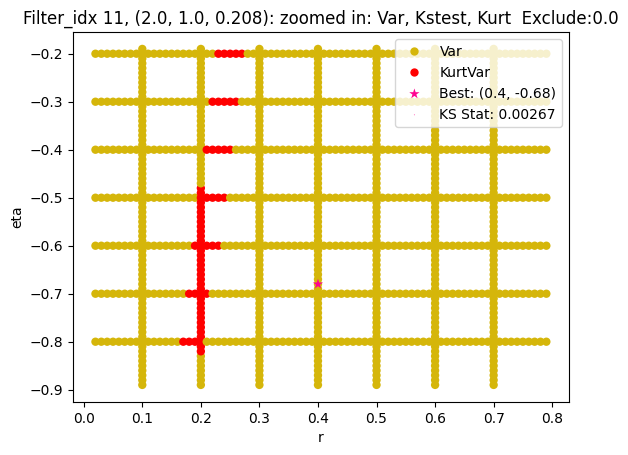

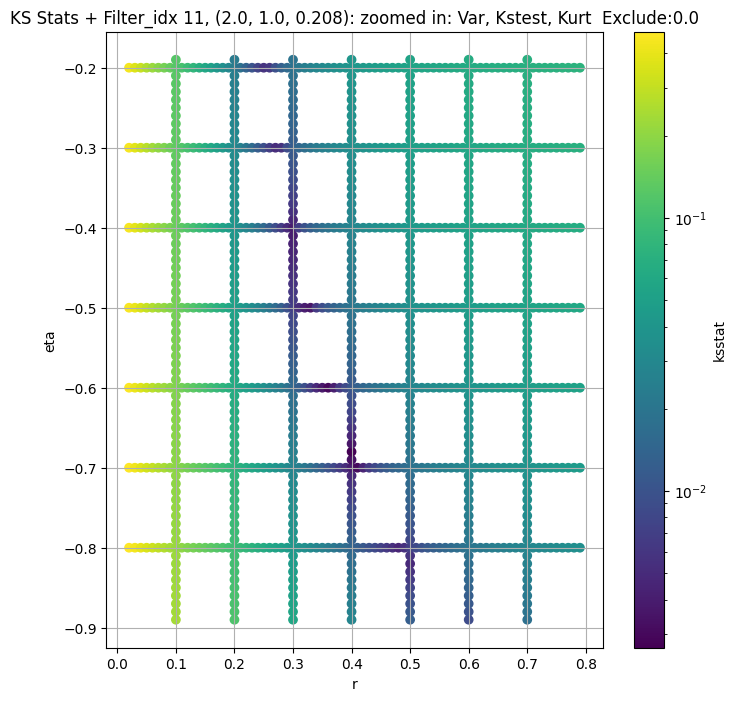

Filter_idx 12, (2.0, 1.0, 0.306):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 0.0 + 100 = 100, ksstat: 0.00422891445045237, var: 547.331298828125


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 0.0 + 75 = 75, ksstat: 0.003735714260207579, var: 557.8760375976562


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 0.0 + 50 = 50, ksstat: 0.0033622203095493575, var: 570.01953125


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 0.0 + 25 = 25, ksstat: 0.0032230156022828305, var: 584.8878173828125


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 0.0 + 0 = 0, ksstat: 0.002440994080633224, var: 610.1575927734375
Number of samples: 100000, Without approximation : 262144000.0


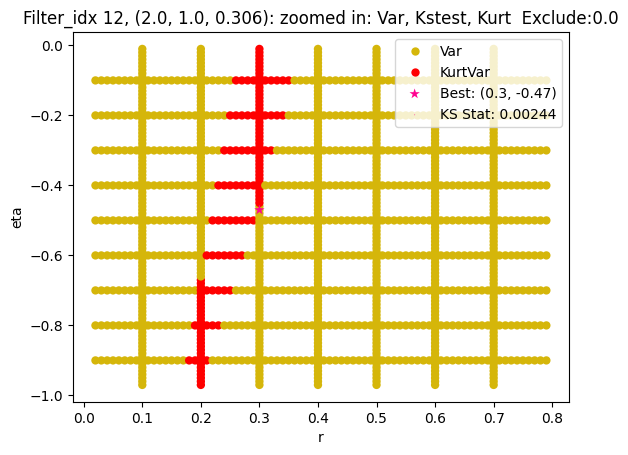

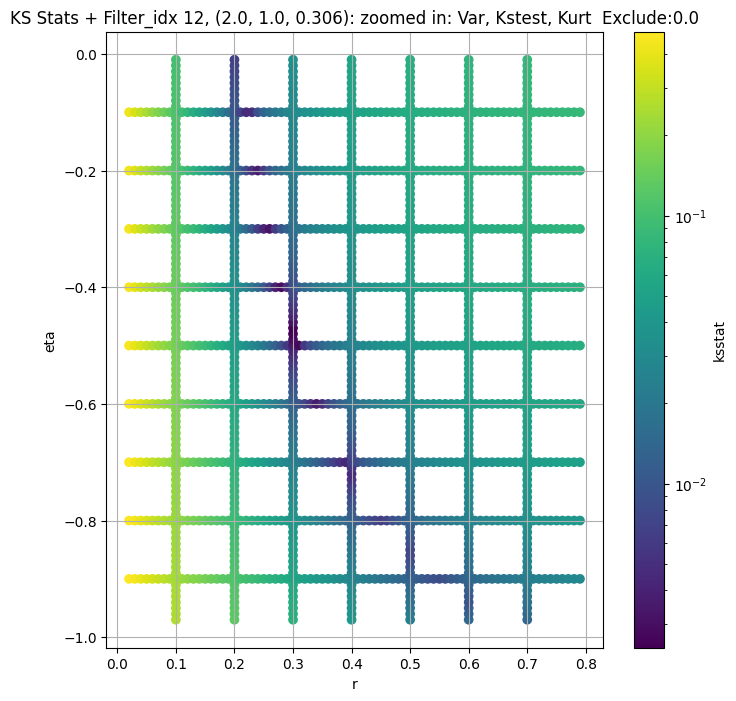

Filter_idx 13, (2.0, 1.0, 0.45):


  0%|          | 0/999 [00:00<?, ?it/s]

Finding Minimum after computing 999 CDFs
filter_idx 13, 0.0 + 100 = 100, ksstat: 0.00407079509085341, var: 276.4373474121094


  0%|          | 0/999 [00:00<?, ?it/s]

Finding Minimum after computing 999 CDFs
filter_idx 13, 0.0 + 75 = 75, ksstat: 0.0036170339712834794, var: 282.6234436035156


  0%|          | 0/999 [00:00<?, ?it/s]

Finding Minimum after computing 999 CDFs
filter_idx 13, 0.0 + 50 = 50, ksstat: 0.003328509566747795, var: 289.751708984375


  0%|          | 0/999 [00:00<?, ?it/s]

Finding Minimum after computing 999 CDFs
filter_idx 13, 0.0 + 25 = 25, ksstat: 0.003317392253979645, var: 298.4965515136719


  0%|          | 0/999 [00:00<?, ?it/s]

Finding Minimum after computing 999 CDFs
filter_idx 13, 0.0 + 0 = 0, ksstat: 0.002234551488390947, var: 313.63714599609375
Number of samples: 100000, Without approximation : 262144000.0


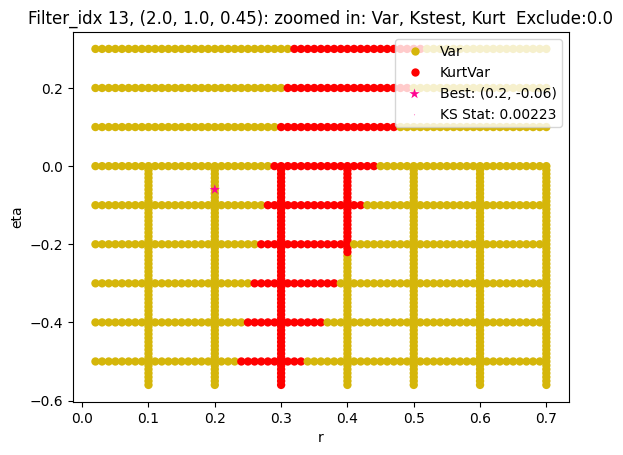

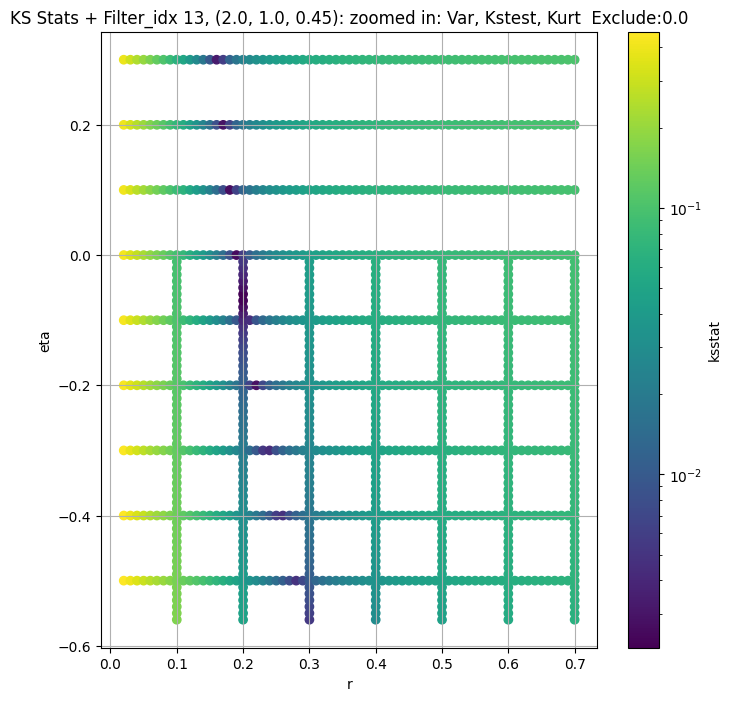

Filter_idx 14, (3.0, 0.5, 0.044):


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 14, 0.0 + 100 = 100, ksstat: 0.004790855405350625, var: 35346.828125


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 14, 0.0 + 75 = 75, ksstat: 0.004584422461311521, var: 35858.53125


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 14, 0.0 + 50 = 50, ksstat: 0.004022213427796413, var: 36428.52734375


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 14, 0.0 + 25 = 25, ksstat: 0.004030169589290478, var: 37089.6640625


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 14, 0.0 + 0 = 0, ksstat: 0.0032551202329217654, var: 38099.71484375
Number of samples: 100000, Without approximation : 262144000.0


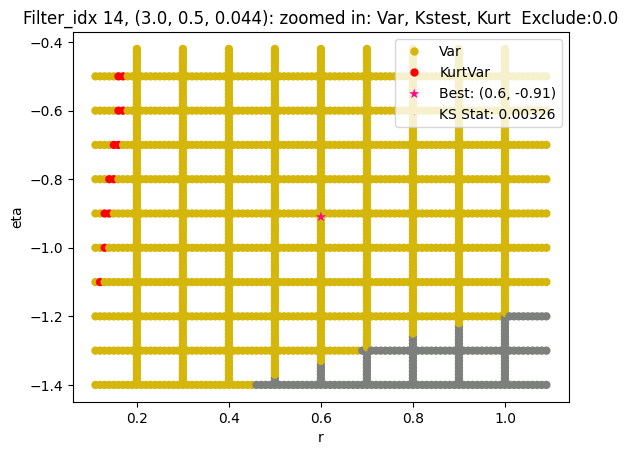

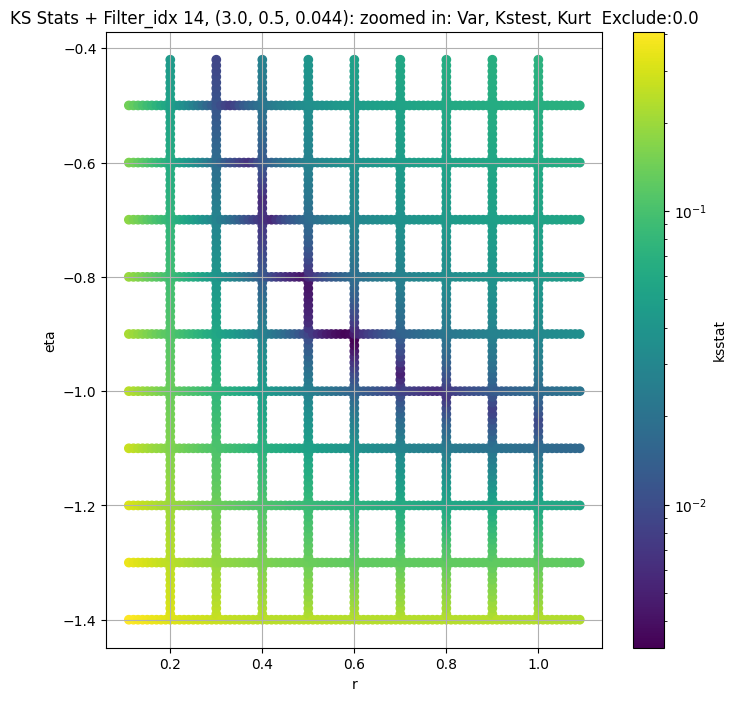

Filter_idx 15, (3.0, 0.5, 0.065):


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 15, 0.0 + 100 = 100, ksstat: 0.004550306956915162, var: 14554.416015625


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 15, 0.0 + 75 = 75, ksstat: 0.004452002656434972, var: 14791.9521484375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 15, 0.0 + 50 = 50, ksstat: 0.00439127297792067, var: 15061.0849609375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 15, 0.0 + 25 = 25, ksstat: 0.0037224650269253035, var: 15387.2861328125


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 15, 0.0 + 0 = 0, ksstat: 0.0030556157815340226, var: 15911.380859375
Number of samples: 100000, Without approximation : 262144000.0


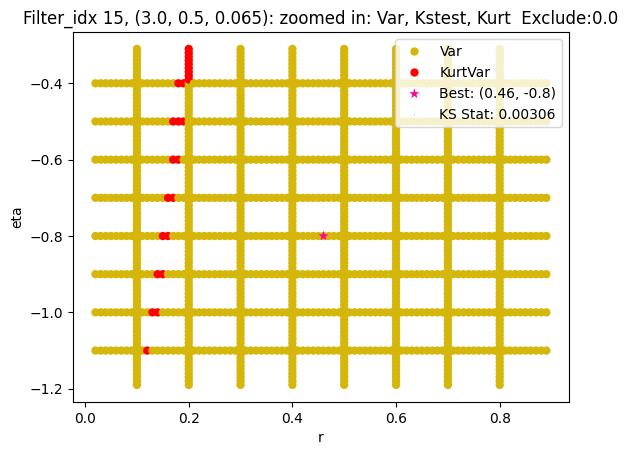

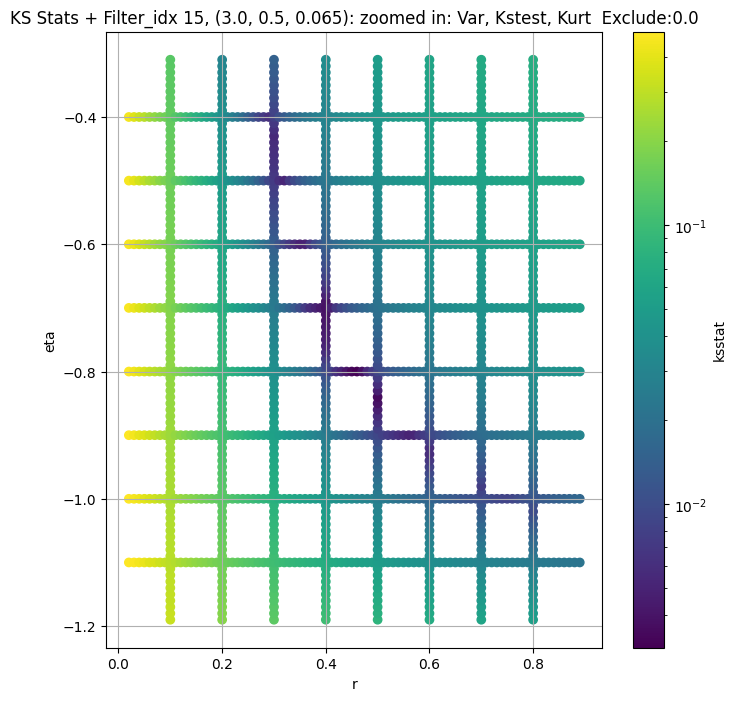

Filter_idx 16, (3.0, 0.5, 0.096):


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 16, 50.0 + 100 = 150, ksstat: 0.005290142352633309, var: 5615.60791015625


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 16, 50.0 + 75 = 125, ksstat: 0.004899220138841254, var: 5698.44580078125


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 16, 50.0 + 50 = 100, ksstat: 0.004517666262297659, var: 5787.99462890625


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 16, 50.0 + 25 = 75, ksstat: 0.004565834551711001, var: 5886.318359375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 16, 50.0 + 0 = 50, ksstat: 0.003939097077080622, var: 5997.0927734375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 16, 50.0 + -25 = 25, ksstat: 0.0037990877100002596, var: 6128.33544921875


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 16, 50.0 + -50 = 0, ksstat: 0.0032087104651030707, var: 6334.27783203125
Number of samples: 100000, Without approximation : 262144000.0


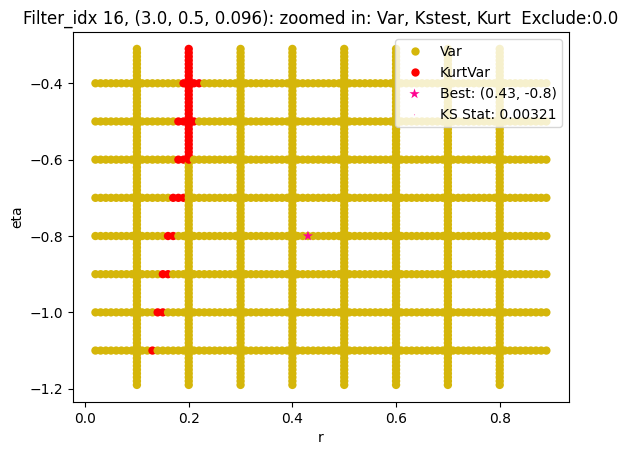

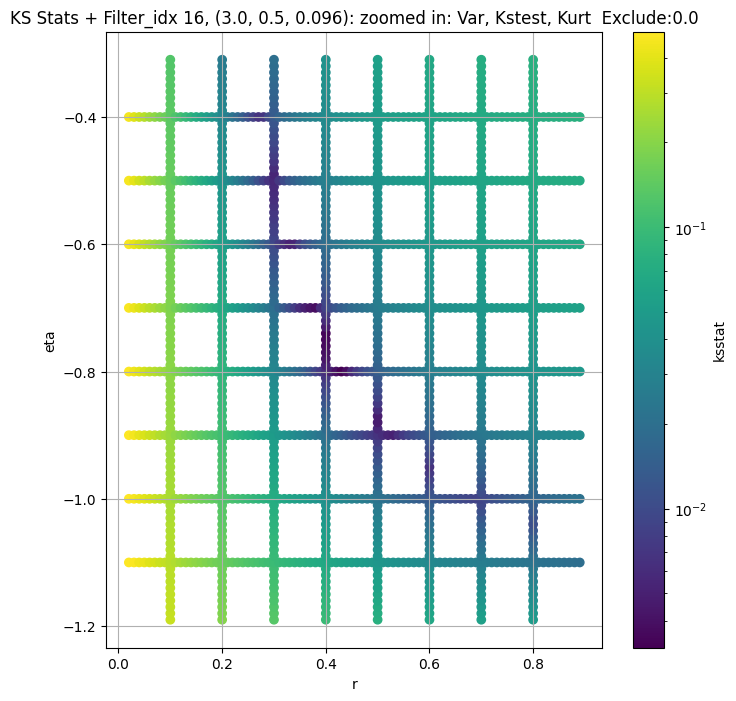

Filter_idx 17, (3.0, 0.5, 0.141):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 17, 0.0 + 100 = 100, ksstat: 0.005120470866602944, var: 2384.91357421875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 17, 0.0 + 75 = 75, ksstat: 0.004520818096998232, var: 2426.969482421875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 17, 0.0 + 50 = 50, ksstat: 0.004523811200281891, var: 2474.55322265625


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 17, 0.0 + 25 = 25, ksstat: 0.003912826071525877, var: 2531.4013671875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 17, 0.0 + 0 = 0, ksstat: 0.0034261008070443078, var: 2623.091552734375
Number of samples: 100000, Without approximation : 262144000.0


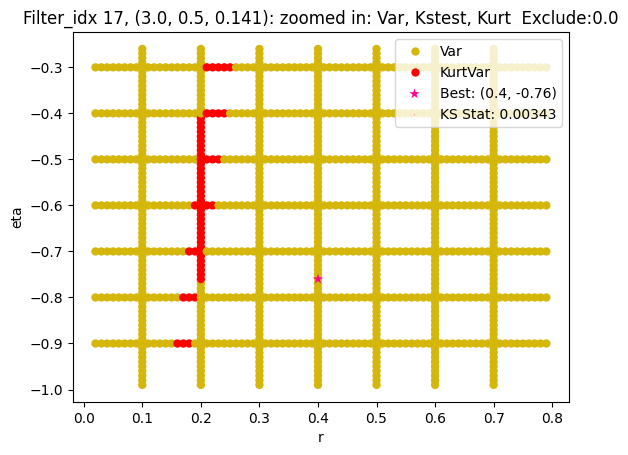

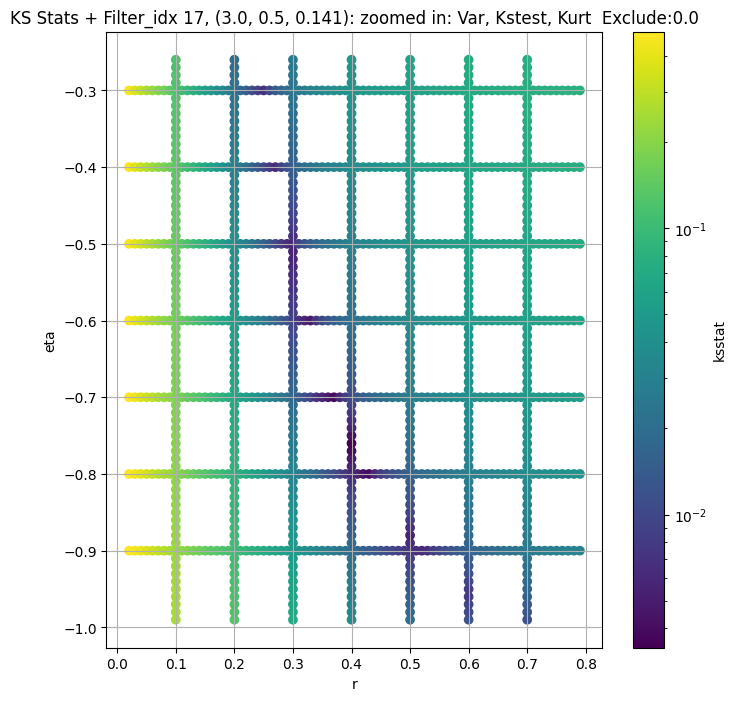

Filter_idx 18, (3.0, 0.5, 0.208):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 18, 0.0 + 100 = 100, ksstat: 0.005748969117845282, var: 1017.9510498046875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 18, 0.0 + 75 = 75, ksstat: 0.005417274683583384, var: 1037.267822265625


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 18, 0.0 + 50 = 50, ksstat: 0.0055520203227440446, var: 1059.3231201171875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 18, 0.0 + 25 = 25, ksstat: 0.004828465912936508, var: 1085.9359130859375


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 18, 0.0 + 0 = 0, ksstat: 0.004660091207739636, var: 1129.5137939453125
Number of samples: 100000, Without approximation : 262144000.0


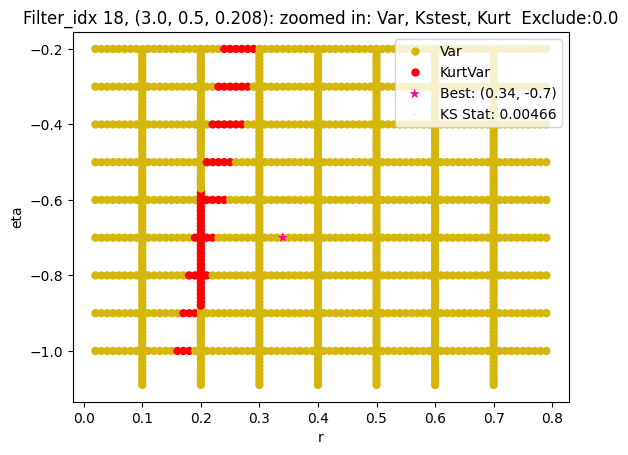

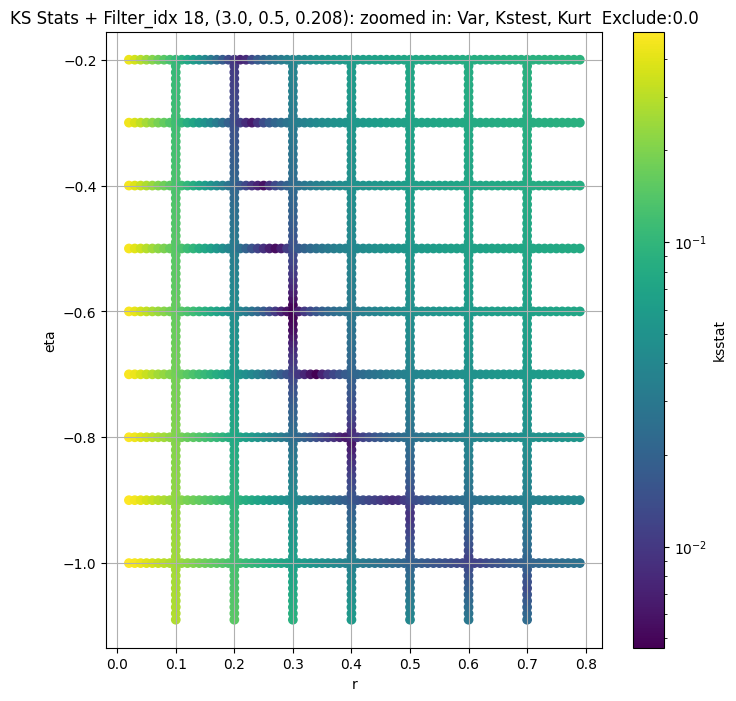

Filter_idx 19, (3.0, 0.5, 0.306):


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 19, 0.0 + 100 = 100, ksstat: 0.0054346347492722005, var: 403.4414367675781


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 19, 0.0 + 75 = 75, ksstat: 0.0049491510651027415, var: 412.2124328613281


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 19, 0.0 + 50 = 50, ksstat: 0.004886105882039707, var: 422.2564697265625


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 19, 0.0 + 25 = 25, ksstat: 0.004842786570393276, var: 434.492431640625


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 19, 0.0 + 0 = 0, ksstat: 0.00414776097858674, var: 455.4649658203125
Number of samples: 100000, Without approximation : 262144000.0


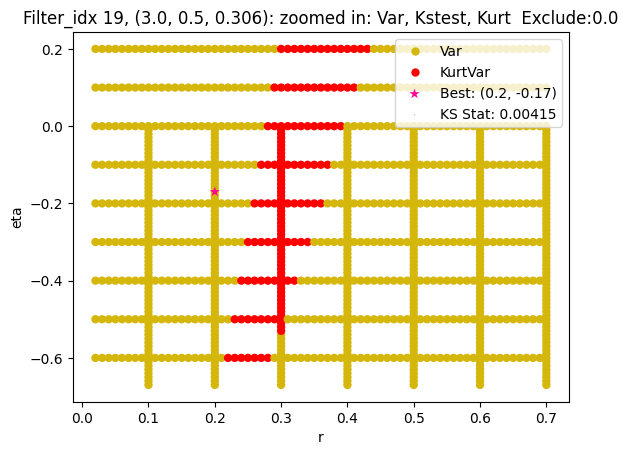

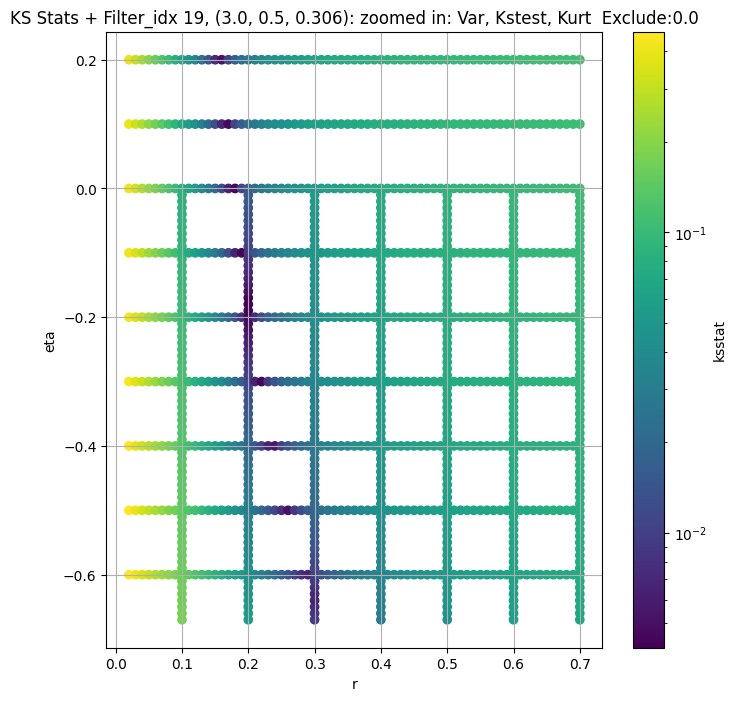

Filter_idx 20, (3.0, 0.5, 0.45):


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 20, 0.0 + 100 = 100, ksstat: 0.003731887474432316, var: 188.29689025878906


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 20, 0.0 + 75 = 75, ksstat: 0.003775233750951821, var: 192.90487670898438


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 20, 0.0 + 50 = 50, ksstat: 0.003307985374039757, var: 198.15750122070312


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 20, 0.0 + 25 = 25, ksstat: 0.0029634772947592786, var: 204.4617462158203


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 20, 0.0 + 0 = 0, ksstat: 0.0025575952491725396, var: 215.6673126220703
Number of samples: 100000, Without approximation : 262144000.0


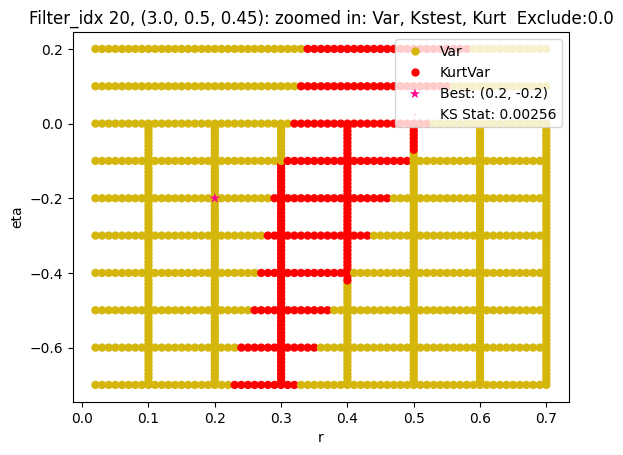

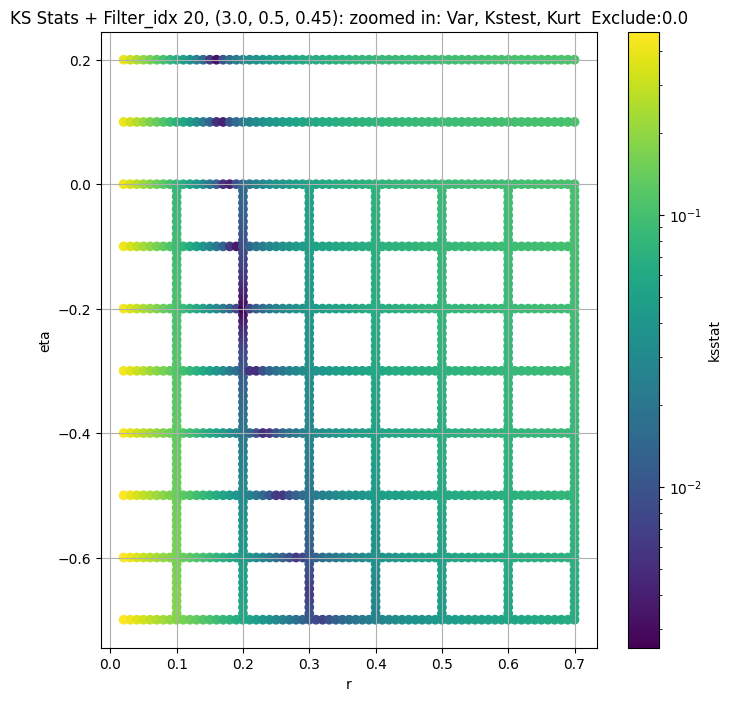

Filter_idx 21, (3.0, 1.0, 0.044):


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 21, 50.0 + 100 = 150, ksstat: 0.004338249455604626, var: 39525.3125


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 21, 50.0 + 75 = 125, ksstat: 0.004452629139048869, var: 40188.84765625


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 21, 50.0 + 50 = 100, ksstat: 0.004112792293455181, var: 40912.94140625


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 21, 50.0 + 25 = 75, ksstat: 0.0034008838994007418, var: 41715.23828125


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 21, 50.0 + 0 = 50, ksstat: 0.0033024448957964317, var: 42626.77734375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 21, 50.0 + -25 = 25, ksstat: 0.0031383718450601616, var: 43716.890625


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 21, 50.0 + -50 = 0, ksstat: 0.002264268914394574, var: 45464.171875
Number of samples: 100000, Without approximation : 262144000.0


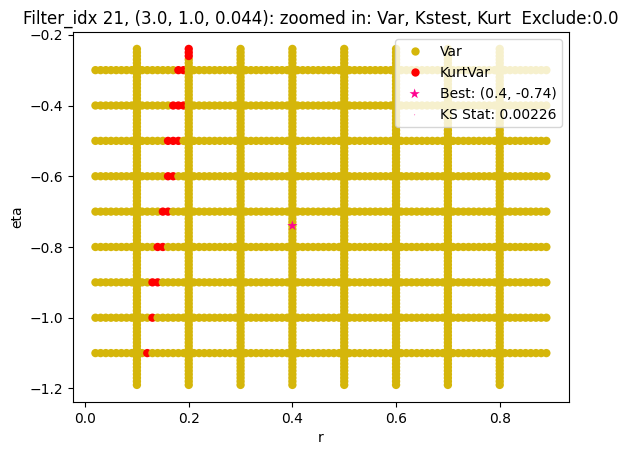

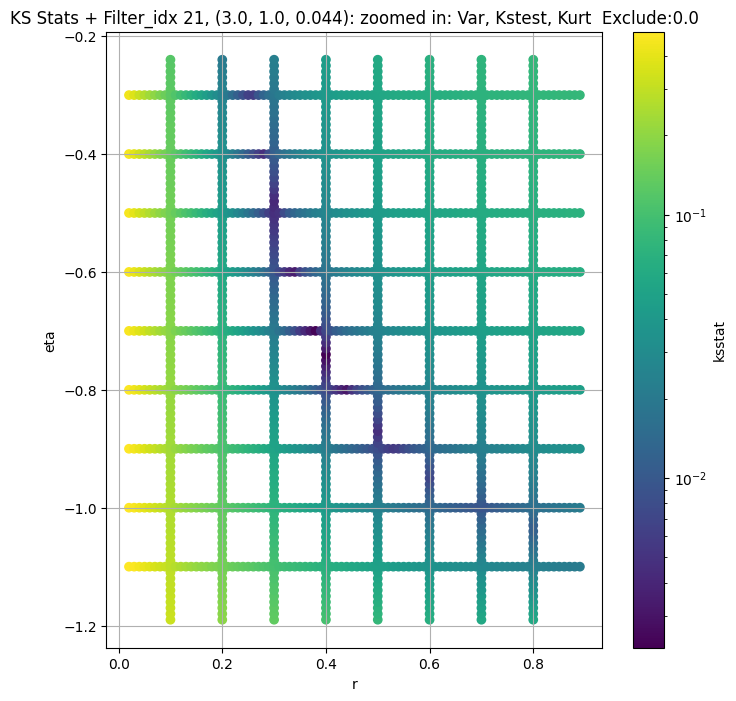

Filter_idx 22, (3.0, 1.0, 0.065):


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 100.0 + 100 = 200, ksstat: 0.005195514660939926, var: 15279.33984375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 100.0 + 75 = 175, ksstat: 0.005192983654660699, var: 15512.3642578125


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 100.0 + 50 = 150, ksstat: 0.004962178158112951, var: 15761.7802734375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 100.0 + 25 = 125, ksstat: 0.0043822196952298595, var: 16031.7158203125


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 100.0 + 0 = 100, ksstat: 0.004170884036041045, var: 16327.5263671875


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 100.0 + -25 = 75, ksstat: 0.003711194340396913, var: 16657.775390625


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 100.0 + -50 = 50, ksstat: 0.0035456991731459553, var: 17036.908203125


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 100.0 + -75 = 25, ksstat: 0.0029867192788178842, var: 17492.072265625


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 100.0 + -100 = 0, ksstat: 0.002540931970378857, var: 18223.310546875
Number of samples: 100000, Without approximation : 262144000.0


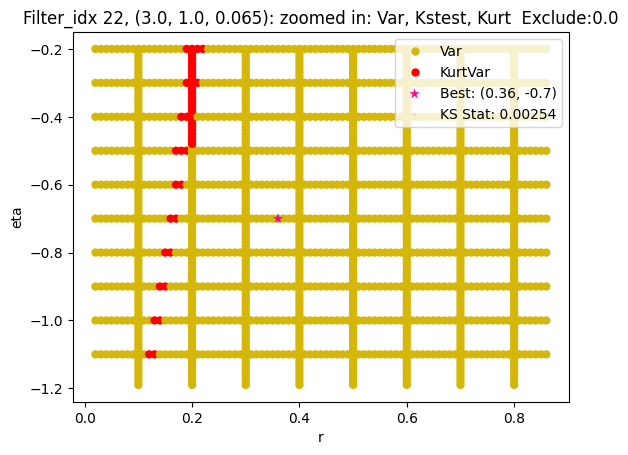

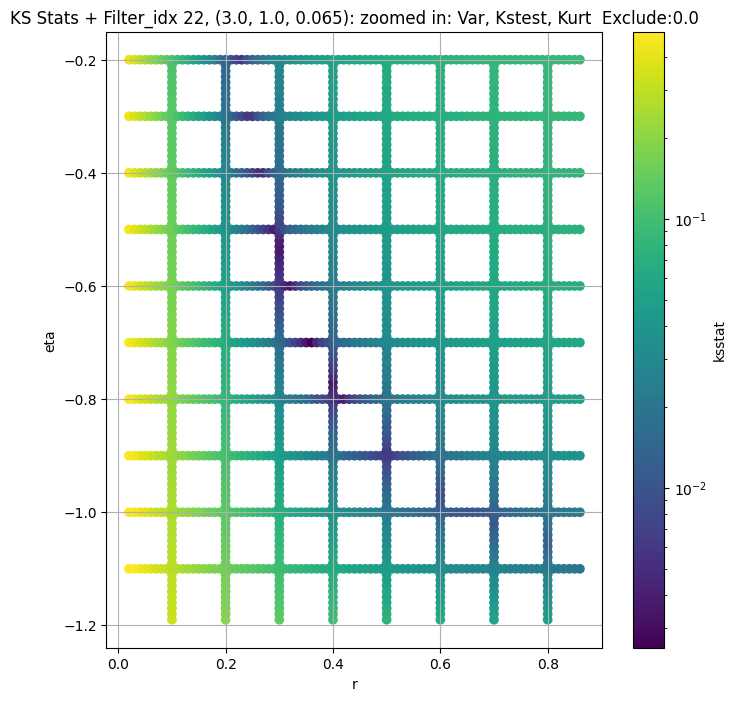

Filter_idx 23, (3.0, 1.0, 0.096):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 23, 0.0 + 100 = 100, ksstat: 0.005104725640201924, var: 6981.38671875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 23, 0.0 + 75 = 75, ksstat: 0.004595211875404903, var: 7127.99609375


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 23, 0.0 + 50 = 50, ksstat: 0.003955636829423133, var: 7295.71240234375


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 23, 0.0 + 25 = 25, ksstat: 0.004017576497548747, var: 7498.07080078125


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 23, 0.0 + 0 = 0, ksstat: 0.0035293457870418793, var: 7829.958984375
Number of samples: 100000, Without approximation : 262144000.0


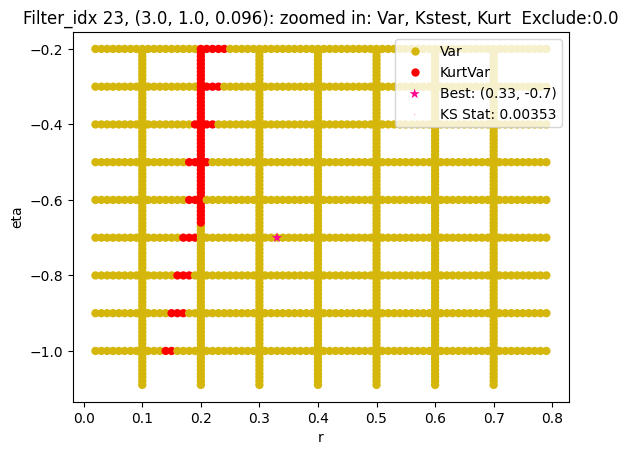

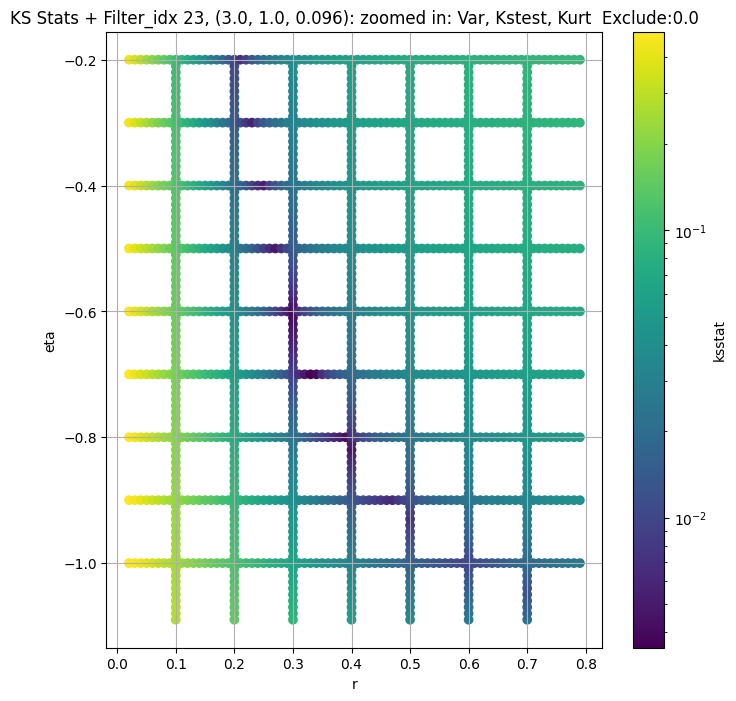

Filter_idx 24, (3.0, 1.0, 0.141):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 24, 0.0 + 100 = 100, ksstat: 0.00412668236301017, var: 2736.48583984375


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 24, 0.0 + 75 = 75, ksstat: 0.0040272793597037615, var: 2798.465576171875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 24, 0.0 + 50 = 50, ksstat: 0.003521649514994181, var: 2869.9677734375


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 24, 0.0 + 25 = 25, ksstat: 0.0036185574941484666, var: 2957.2021484375


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 24, 0.0 + 0 = 0, ksstat: 0.0031253620603827748, var: 3101.769287109375
Number of samples: 100000, Without approximation : 262144000.0


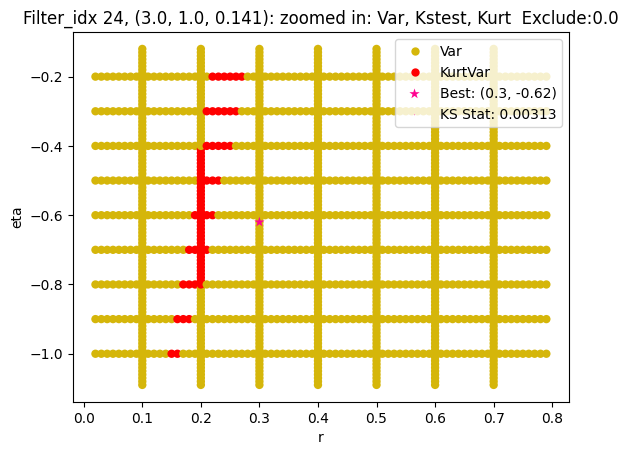

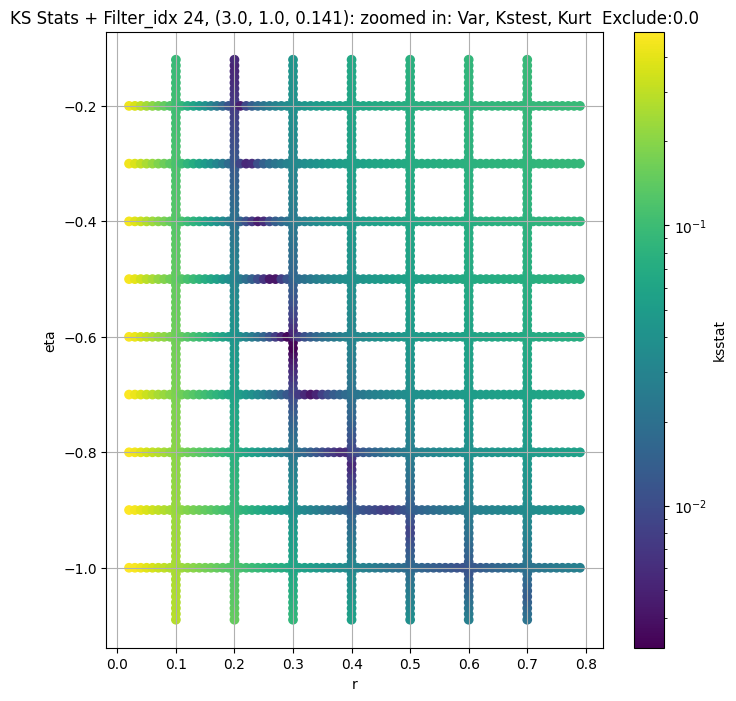

Filter_idx 25, (3.0, 1.0, 0.208):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 25, 50.0 + 100 = 150, ksstat: 0.005393275192564051, var: 1084.2095947265625


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 25, 50.0 + 75 = 125, ksstat: 0.004880067725060819, var: 1105.68994140625


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 25, 50.0 + 50 = 100, ksstat: 0.004879461787149986, var: 1129.3927001953125


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 25, 50.0 + 25 = 75, ksstat: 0.004411356099899809, var: 1156.0147705078125


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 25, 50.0 + 0 = 50, ksstat: 0.0038904652982189036, var: 1186.84912109375


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 25, 50.0 + -25 = 25, ksstat: 0.004036170583924192, var: 1225.262451171875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 25, 50.0 + -50 = 0, ksstat: 0.0039350992983683275, var: 1296.3826904296875
Number of samples: 100000, Without approximation : 262144000.0


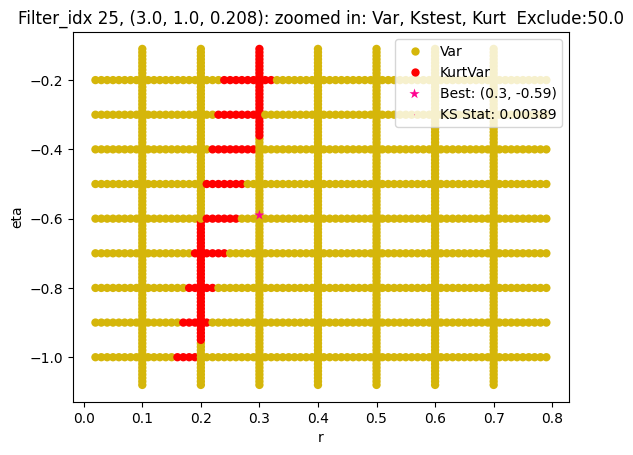

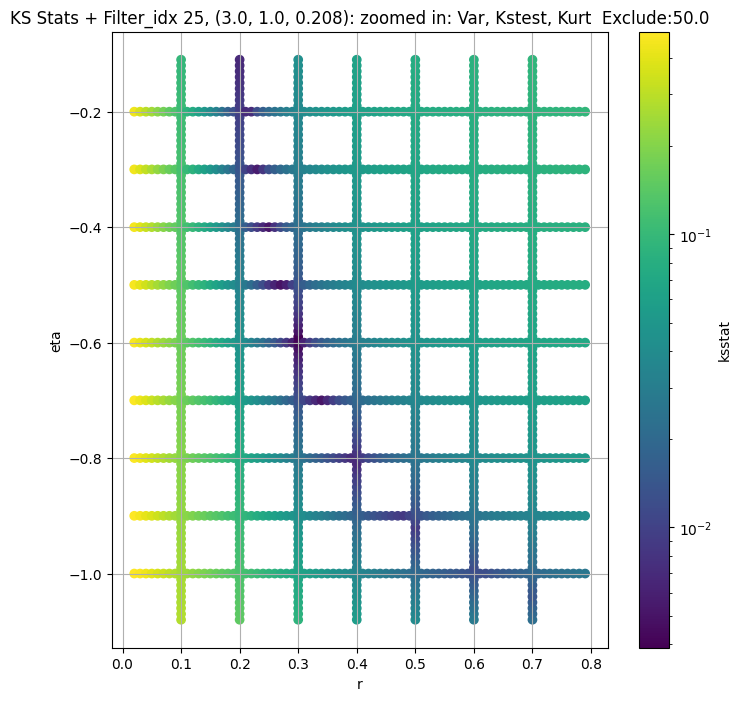

Filter_idx 26, (3.0, 1.0, 0.306):


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 26, 0.0 + 100 = 100, ksstat: 0.005227200721120262, var: 453.0998840332031


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 26, 0.0 + 75 = 75, ksstat: 0.0055388288165005364, var: 464.2977600097656


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 26, 0.0 + 50 = 50, ksstat: 0.00484370885284835, var: 477.4683532714844


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 26, 0.0 + 25 = 25, ksstat: 0.004563190898767222, var: 494.0532531738281


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 26, 0.0 + 0 = 0, ksstat: 0.003991273844058174, var: 524.2926025390625
Number of samples: 100000, Without approximation : 262144000.0


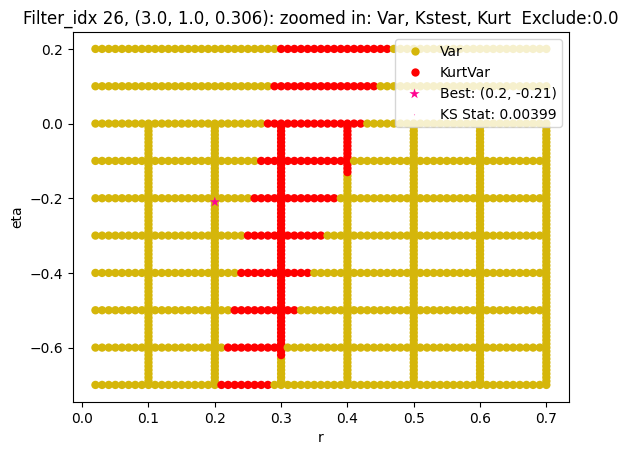

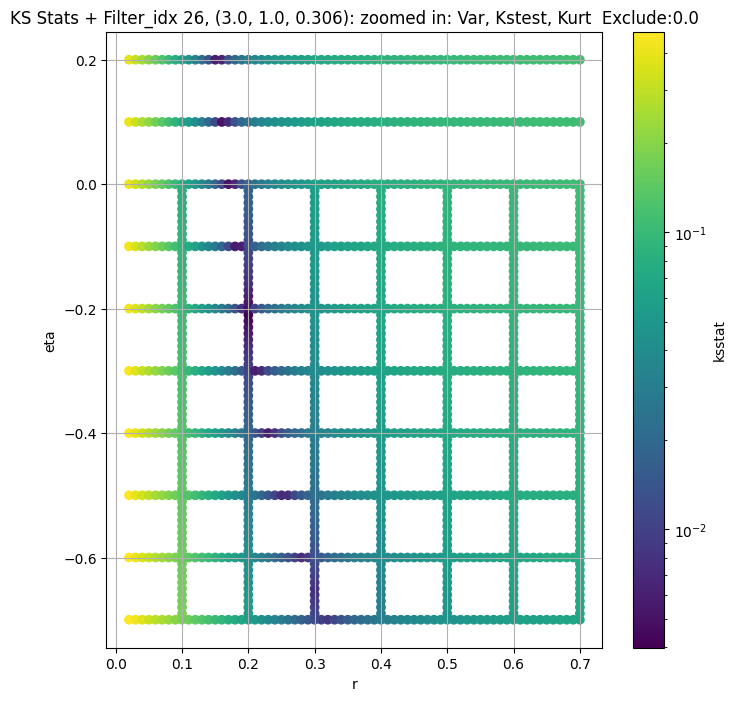

Filter_idx 27, (3.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 0.0 + 100 = 100, ksstat: 0.005264470922849002, var: 196.41384887695312


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 0.0 + 75 = 75, ksstat: 0.004859944291792928, var: 202.40277099609375


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 0.0 + 50 = 50, ksstat: 0.004323991069382874, var: 209.56581115722656


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 0.0 + 25 = 25, ksstat: 0.003326950632207004, var: 218.74673461914062


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 0.0 + 0 = 0, ksstat: 0.0025016216208630926, var: 236.42051696777344
Number of samples: 100000, Without approximation : 262144000.0


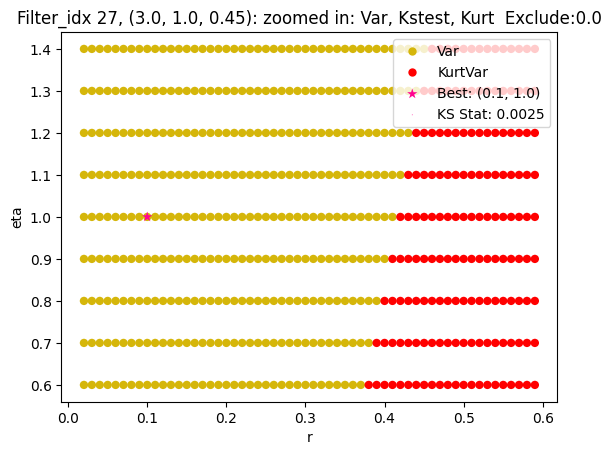

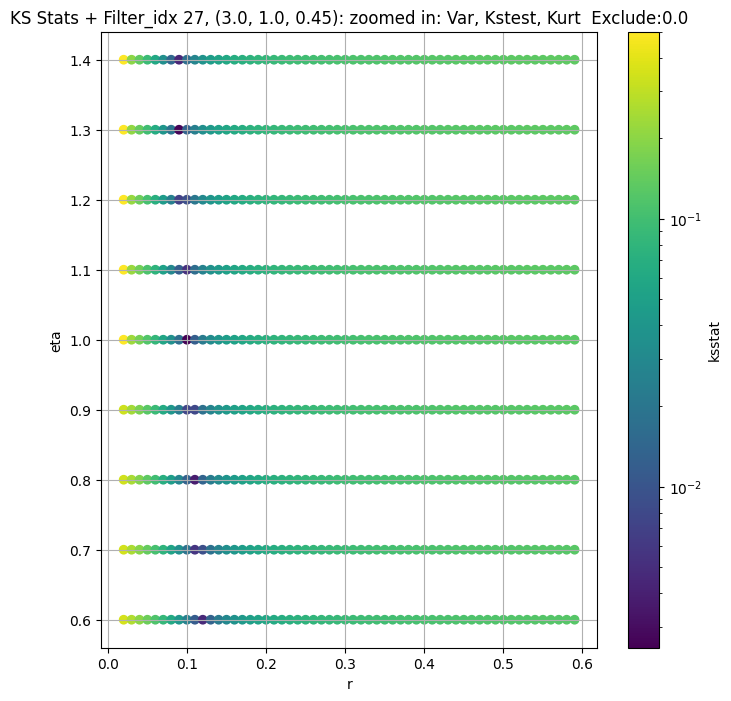

Filter_idx 28, (4.0, 0.5, 0.044):


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 28, 0.0 + 100 = 100, ksstat: 0.004028752595177432, var: 33092.9921875


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 28, 0.0 + 75 = 75, ksstat: 0.003699965787876569, var: 33620.81640625


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 28, 0.0 + 50 = 50, ksstat: 0.0032590753453417554, var: 34216.3125


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 28, 0.0 + 25 = 25, ksstat: 0.0028449652791787683, var: 34922.41796875


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 28, 0.0 + 0 = 0, ksstat: 0.0029933969903218616, var: 36045.29296875
Number of samples: 100000, Without approximation : 262144000.0


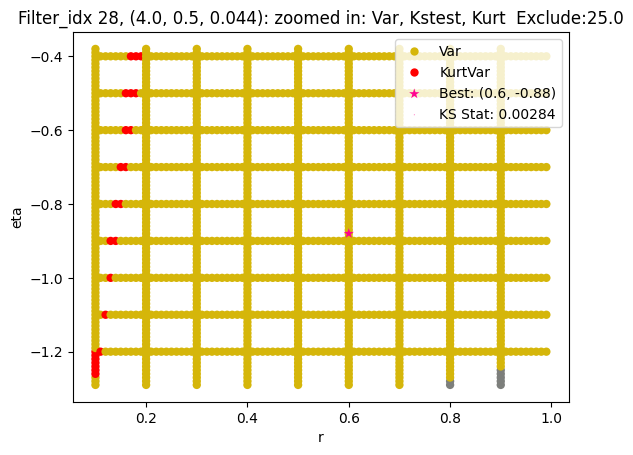

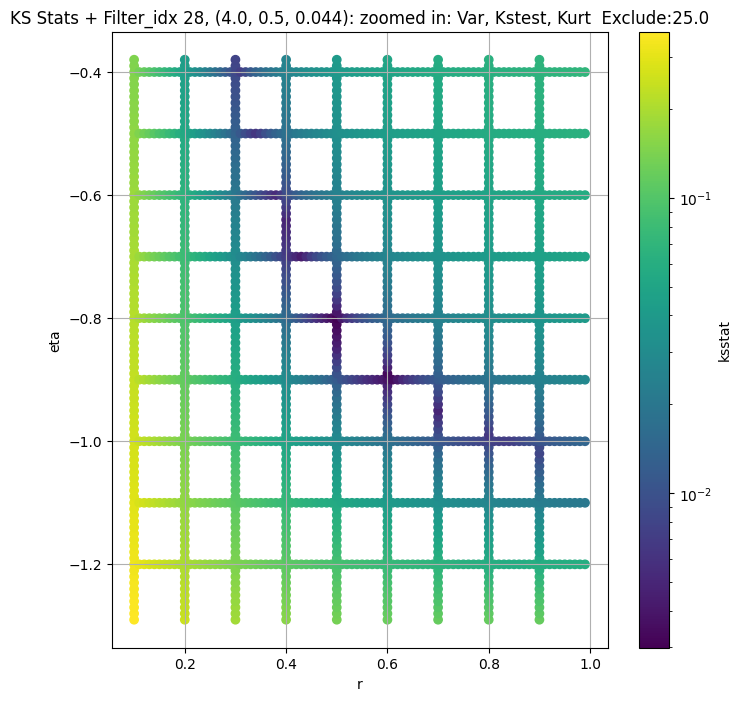

Filter_idx 29, (4.0, 0.5, 0.065):


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 29, 0.0 + 100 = 100, ksstat: 0.004087299449909133, var: 13975.5654296875


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 29, 0.0 + 75 = 75, ksstat: 0.004002003769951856, var: 14199.0517578125


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 29, 0.0 + 50 = 50, ksstat: 0.0033975791142869527, var: 14450.14453125


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 29, 0.0 + 25 = 25, ksstat: 0.003151205097706833, var: 14744.9365234375


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 29, 0.0 + 0 = 0, ksstat: 0.0033805708243197508, var: 15223.00390625
Number of samples: 100000, Without approximation : 262144000.0


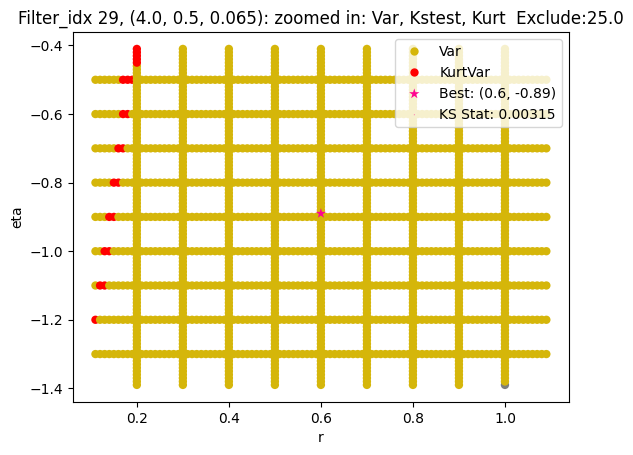

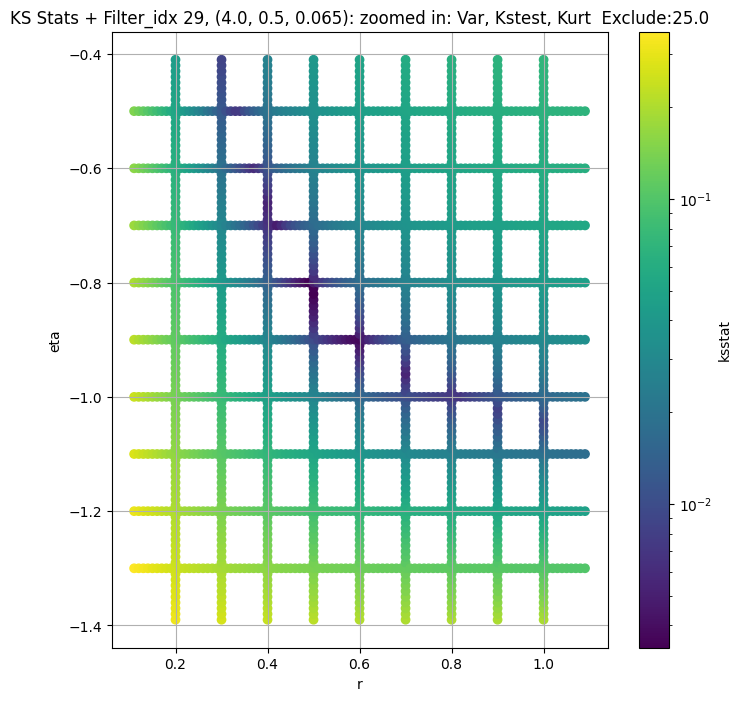

Filter_idx 30, (4.0, 0.5, 0.096):


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 30, 0.0 + 100 = 100, ksstat: 0.004602801885881802, var: 5633.611328125


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 30, 0.0 + 75 = 75, ksstat: 0.004784193758686772, var: 5728.2685546875


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 30, 0.0 + 50 = 50, ksstat: 0.004567381426599487, var: 5835.04443359375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 30, 0.0 + 25 = 25, ksstat: 0.003729805555298782, var: 5962.01708984375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 30, 0.0 + 0 = 0, ksstat: 0.003194578082991173, var: 6166.96337890625
Number of samples: 100000, Without approximation : 262144000.0


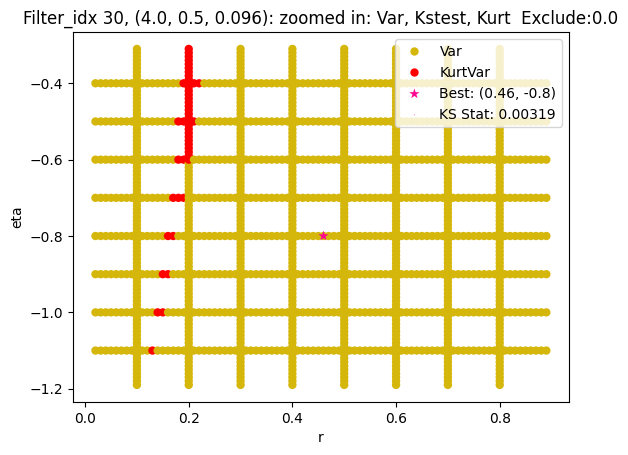

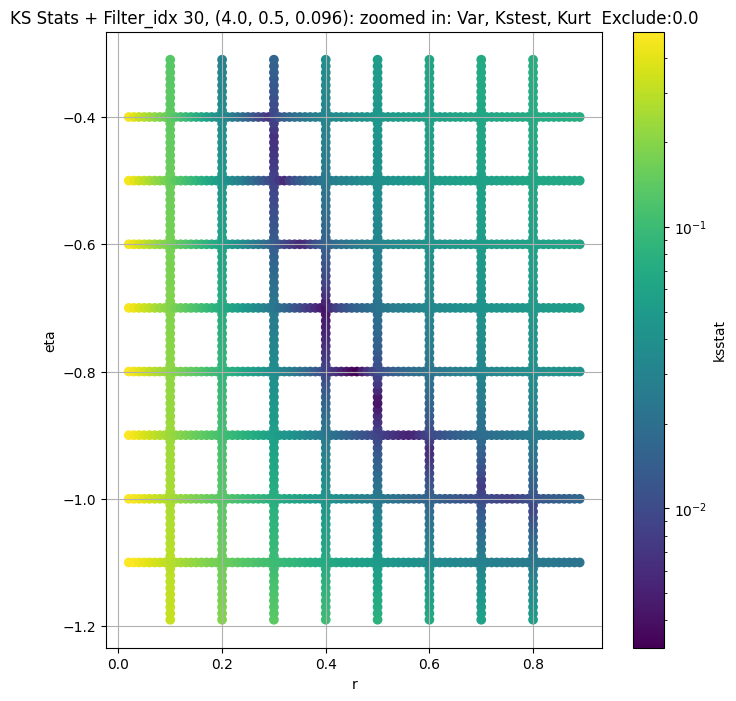

Filter_idx 31, (4.0, 0.5, 0.141):


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 31, 0.0 + 100 = 100, ksstat: 0.004894565305637588, var: 2318.850341796875


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 31, 0.0 + 75 = 75, ksstat: 0.004384527599740284, var: 2363.263671875


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 31, 0.0 + 50 = 50, ksstat: 0.004510359846715689, var: 2413.96533203125


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 31, 0.0 + 25 = 25, ksstat: 0.0038221238622443976, var: 2475.55908203125


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 31, 0.0 + 0 = 0, ksstat: 0.003661155247037251, var: 2597.618408203125
Number of samples: 100000, Without approximation : 262144000.0


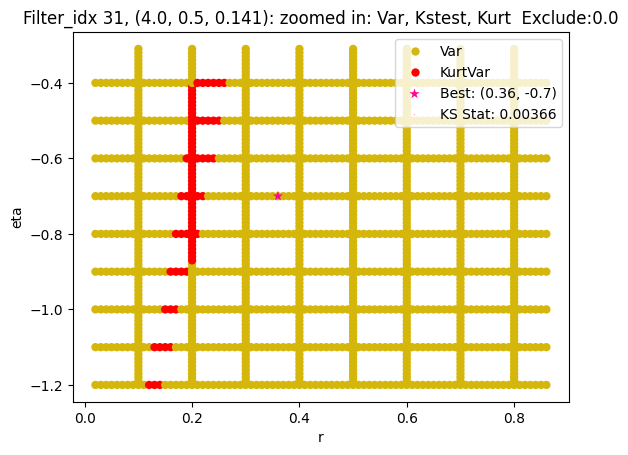

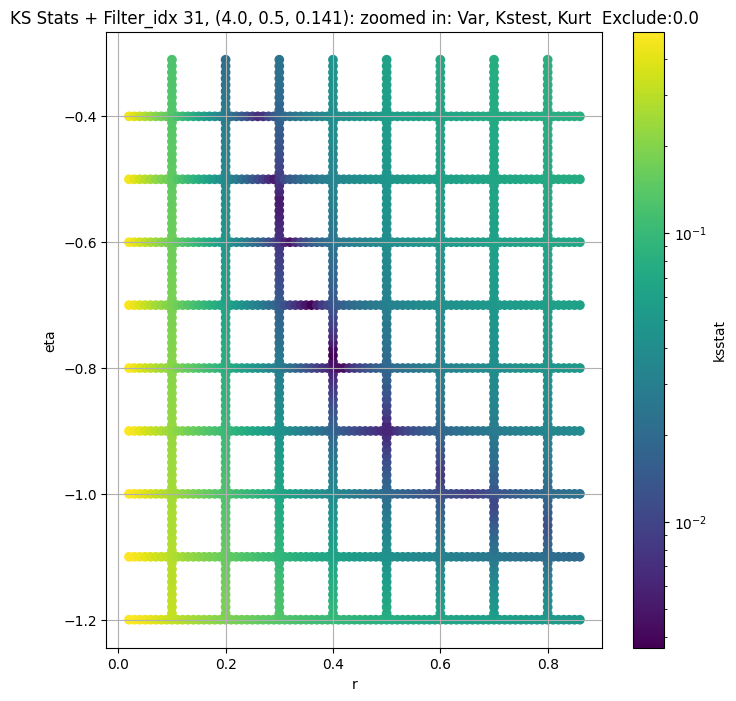

Filter_idx 32, (4.0, 0.5, 0.208):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 0.0 + 100 = 100, ksstat: 0.00546672112470703, var: 987.2509765625


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 0.0 + 75 = 75, ksstat: 0.00495603971919778, var: 1008.0459594726562


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 0.0 + 50 = 50, ksstat: 0.005183290870799384, var: 1032.3436279296875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 0.0 + 25 = 25, ksstat: 0.004813914326182445, var: 1062.6646728515625


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 0.0 + 0 = 0, ksstat: 0.003857231592458654, var: 1120.96923828125
Number of samples: 100000, Without approximation : 262144000.0


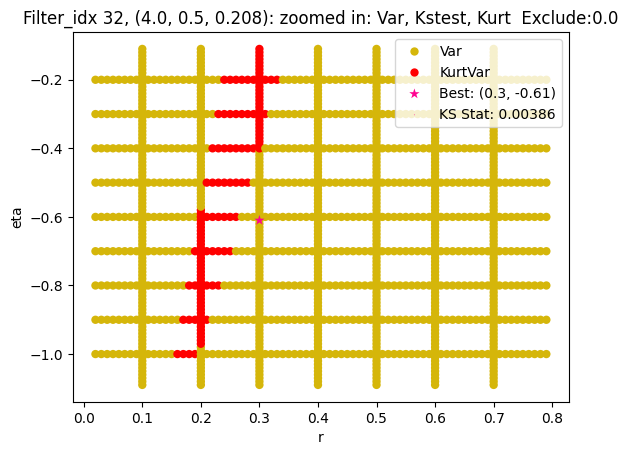

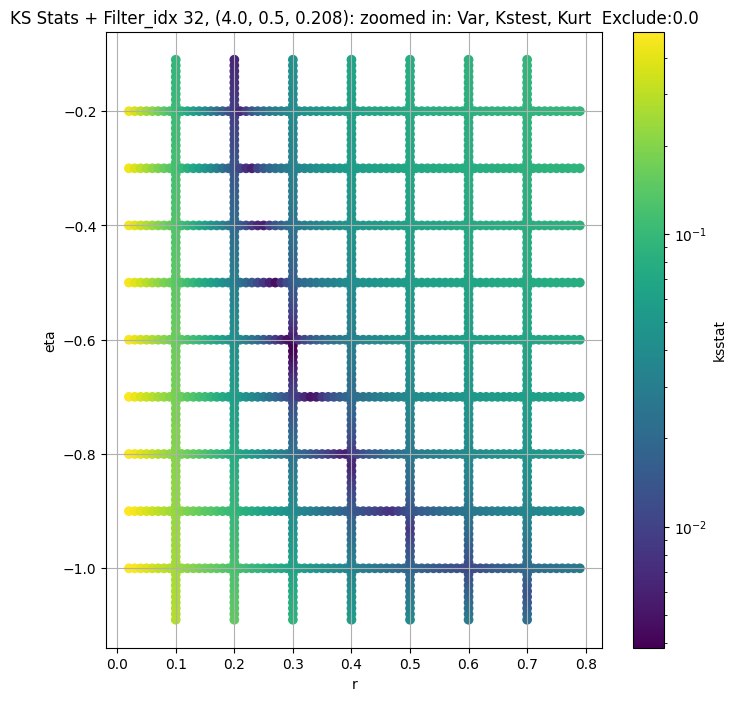

Filter_idx 33, (4.0, 0.5, 0.306):


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 33, 0.0 + 100 = 100, ksstat: 0.0054504235917379185, var: 397.9994812011719


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 33, 0.0 + 75 = 75, ksstat: 0.005378804418559313, var: 407.1924743652344


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 33, 0.0 + 50 = 50, ksstat: 0.0046709906043382945, var: 417.9219665527344


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 33, 0.0 + 25 = 25, ksstat: 0.0045845783554562605, var: 431.3316955566406


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 33, 0.0 + 0 = 0, ksstat: 0.0041755079507627135, var: 459.0071716308594
Number of samples: 100000, Without approximation : 262144000.0


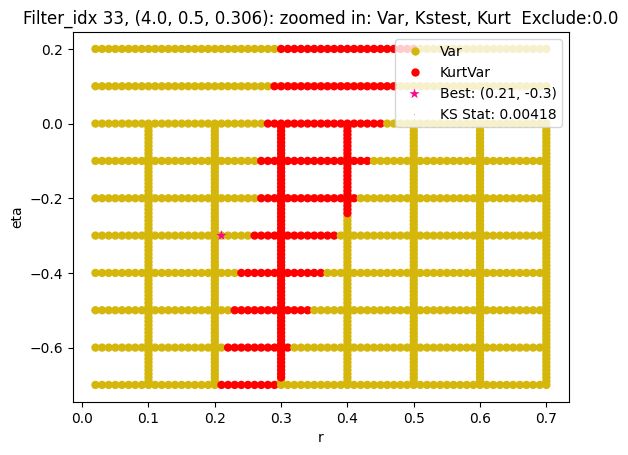

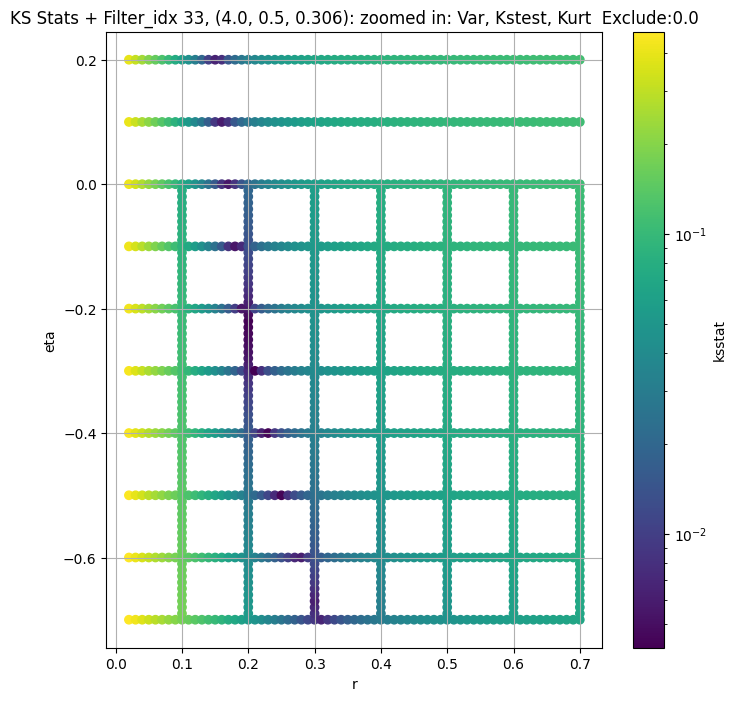

Filter_idx 34, (4.0, 0.5, 0.45):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 34, 100.0 + 100 = 200, ksstat: 0.005558590426410284, var: 159.6450653076172


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 34, 100.0 + 75 = 175, ksstat: 0.005298635672741803, var: 162.58224487304688


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 34, 100.0 + 50 = 150, ksstat: 0.00516650353512893, var: 165.7393035888672


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 34, 100.0 + 25 = 125, ksstat: 0.004631554219404976, var: 169.16159057617188


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 34, 100.0 + 0 = 100, ksstat: 0.004465906278164566, var: 172.91378784179688


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 34, 100.0 + -25 = 75, ksstat: 0.003961907718944634, var: 177.10382080078125


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 34, 100.0 + -50 = 50, ksstat: 0.003766395036893244, var: 181.95199584960938


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 34, 100.0 + -75 = 25, ksstat: 0.0035237607244661476, var: 187.91217041015625


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 34, 100.0 + -100 = 0, ksstat: 0.0025924215140820106, var: 199.4376220703125
Number of samples: 100000, Without approximation : 262144000.0


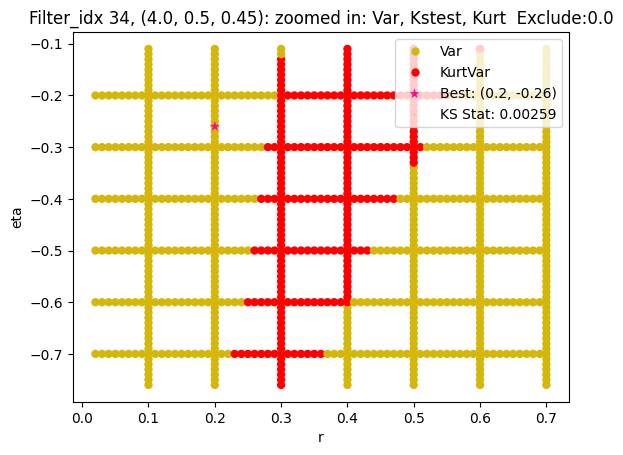

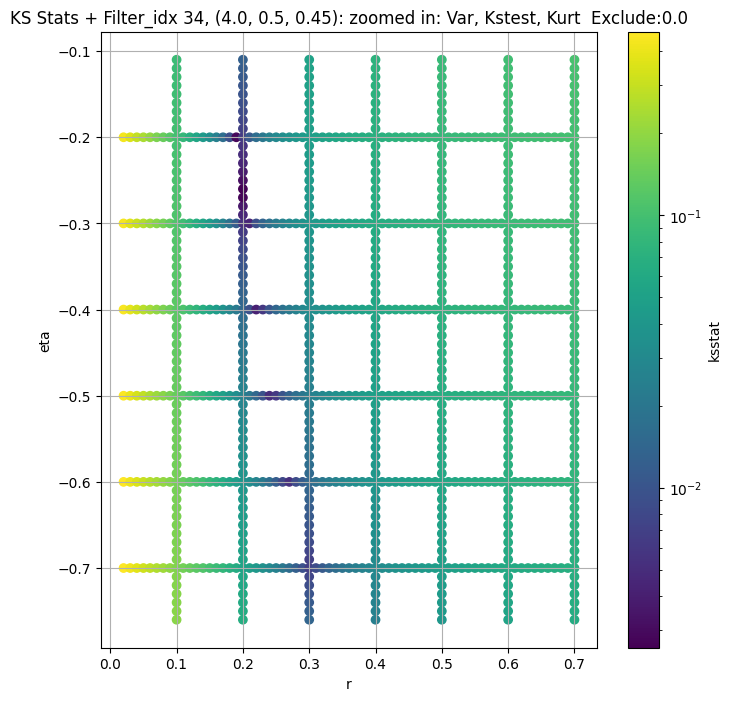

Filter_idx 35, (4.0, 1.0, 0.044):


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 35, 100.0 + 100 = 200, ksstat: 0.004447093369011168, var: 36320.55859375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 35, 100.0 + 75 = 175, ksstat: 0.004063651437520188, var: 36895.61328125


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 35, 100.0 + 50 = 150, ksstat: 0.0037281160421340775, var: 37511.62109375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 35, 100.0 + 25 = 125, ksstat: 0.003537952949295823, var: 38176.55859375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 35, 100.0 + 0 = 100, ksstat: 0.0030231778389360232, var: 38901.453125


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 35, 100.0 + -25 = 75, ksstat: 0.0026854802903661934, var: 39705.2109375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 35, 100.0 + -50 = 50, ksstat: 0.0021518919324429175, var: 40620.328125


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 35, 100.0 + -75 = 25, ksstat: 0.0017772778945202503, var: 41718.48828125


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 35, 100.0 + -100 = 0, ksstat: 0.0016590870699954852, var: 43595.16015625
Number of samples: 100000, Without approximation : 262144000.0


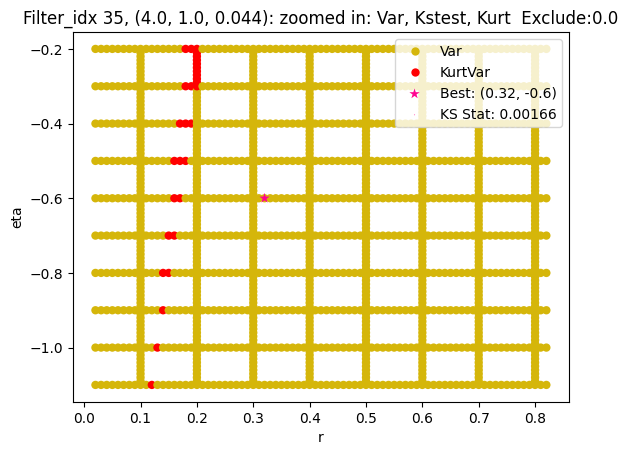

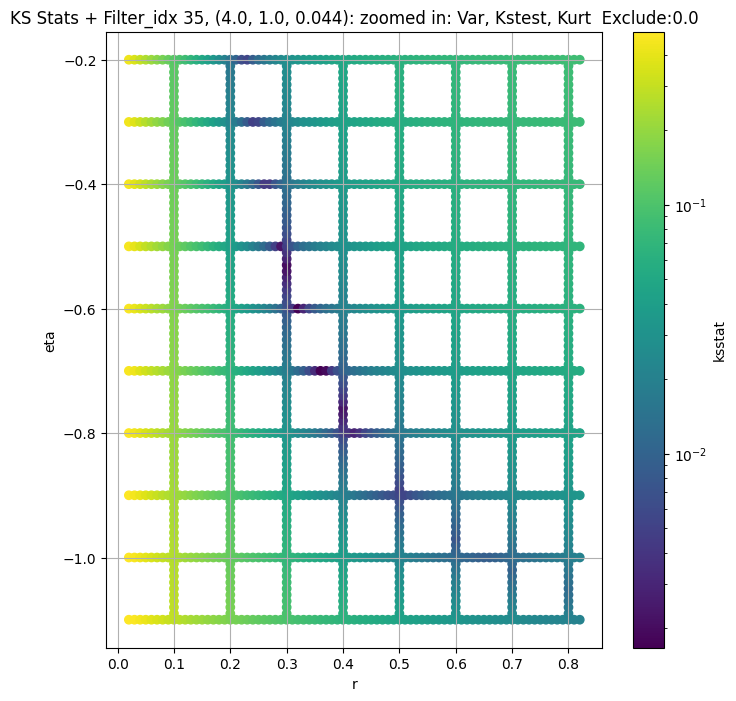

Filter_idx 36, (4.0, 1.0, 0.065):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 36, 0.0 + 100 = 100, ksstat: 0.0031454382963750915, var: 16073.9052734375


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 36, 0.0 + 75 = 75, ksstat: 0.0027853067884693328, var: 16434.091796875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 36, 0.0 + 50 = 50, ksstat: 0.0025617317075730672, var: 16848.294921875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 36, 0.0 + 25 = 25, ksstat: 0.0021864580790983412, var: 17346.857421875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 36, 0.0 + 0 = 0, ksstat: 0.0014856714386422415, var: 18127.322265625
Number of samples: 100000, Without approximation : 262144000.0


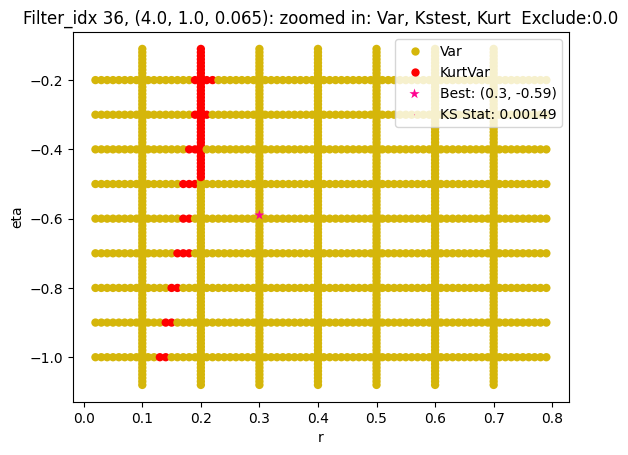

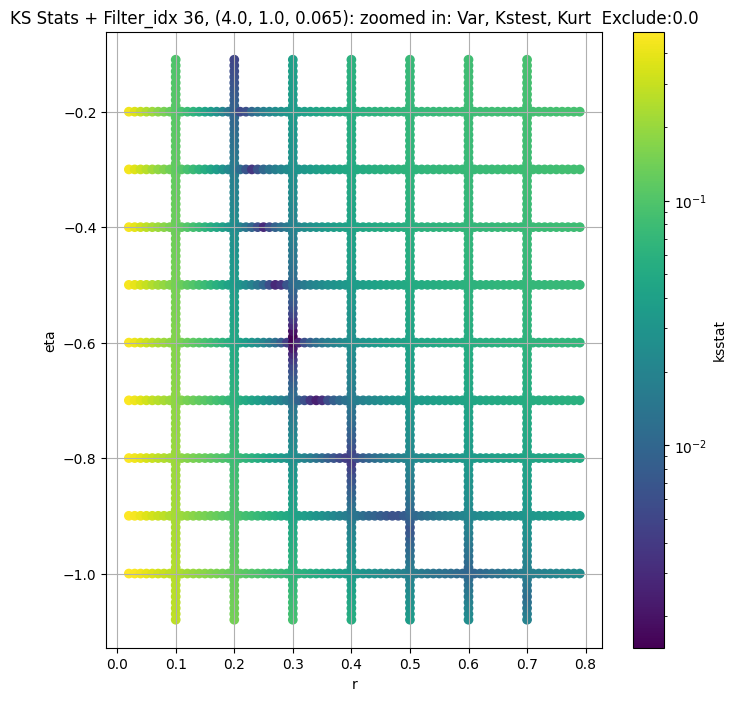

Filter_idx 37, (4.0, 1.0, 0.096):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 37, 0.0 + 100 = 100, ksstat: 0.0032223173070244915, var: 6318.7646484375


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 37, 0.0 + 75 = 75, ksstat: 0.0028793208773925452, var: 6463.7646484375


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 37, 0.0 + 50 = 50, ksstat: 0.0027697838856083623, var: 6630.3447265625


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 37, 0.0 + 25 = 25, ksstat: 0.0022110121665932098, var: 6832.89794921875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 37, 0.0 + 0 = 0, ksstat: 0.001746421063081649, var: 7172.94482421875
Number of samples: 100000, Without approximation : 262144000.0


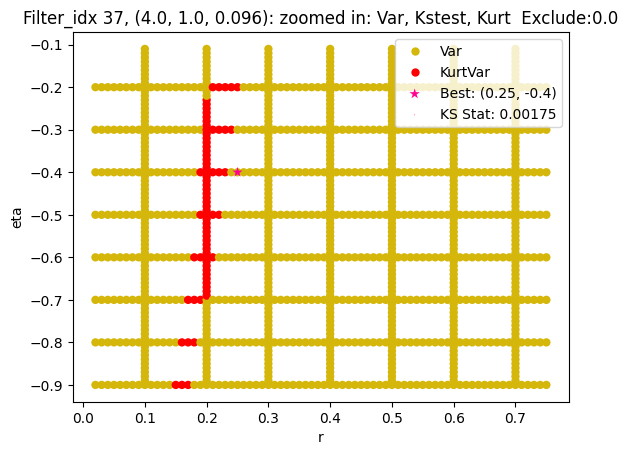

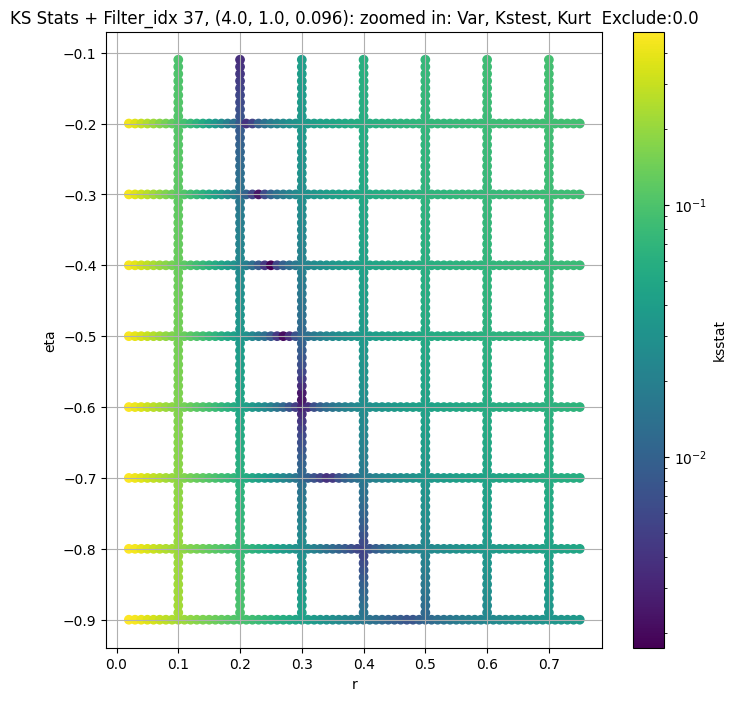

Filter_idx 38, (4.0, 1.0, 0.141):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 38, 50.0 + 100 = 150, ksstat: 0.003894453274356457, var: 2480.174560546875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 38, 50.0 + 75 = 125, ksstat: 0.0034613136327650285, var: 2531.9765625


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 38, 50.0 + 50 = 100, ksstat: 0.003116129270510526, var: 2589.32958984375


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 38, 50.0 + 25 = 75, ksstat: 0.003163791061213339, var: 2654.12255859375


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 38, 50.0 + 0 = 50, ksstat: 0.002439090660647278, var: 2729.693115234375


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 38, 50.0 + -25 = 25, ksstat: 0.0020396297332102645, var: 2823.315673828125


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 38, 50.0 + -50 = 0, ksstat: 0.0020606298846219673, var: 3011.5810546875
Number of samples: 100000, Without approximation : 262144000.0


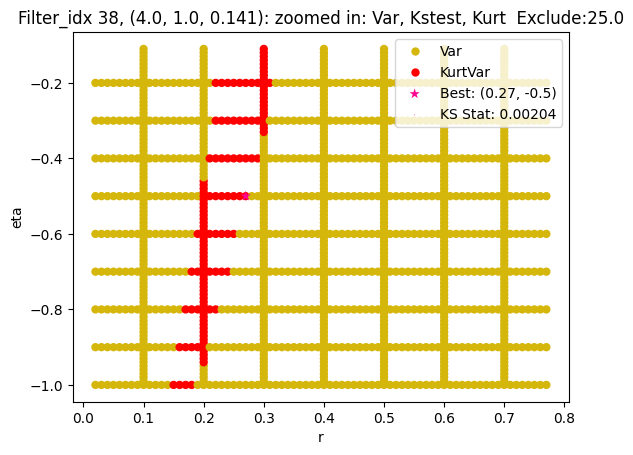

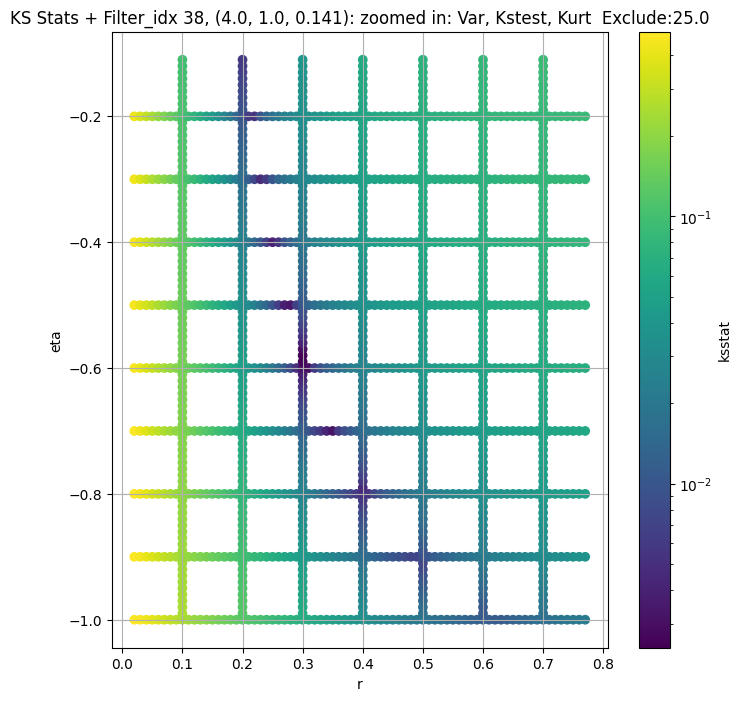

Filter_idx 39, (4.0, 1.0, 0.208):


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 39, 0.0 + 100 = 100, ksstat: 0.00432643698863433, var: 1041.5357666015625


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 39, 0.0 + 75 = 75, ksstat: 0.0036820054332385374, var: 1067.609619140625


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 39, 0.0 + 50 = 50, ksstat: 0.0036085607303147707, var: 1098.0162353515625


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 39, 0.0 + 25 = 25, ksstat: 0.0035467332990649636, var: 1136.0489501953125


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 39, 0.0 + 0 = 0, ksstat: 0.002710107227219094, var: 1211.0611572265625
Number of samples: 100000, Without approximation : 262144000.0


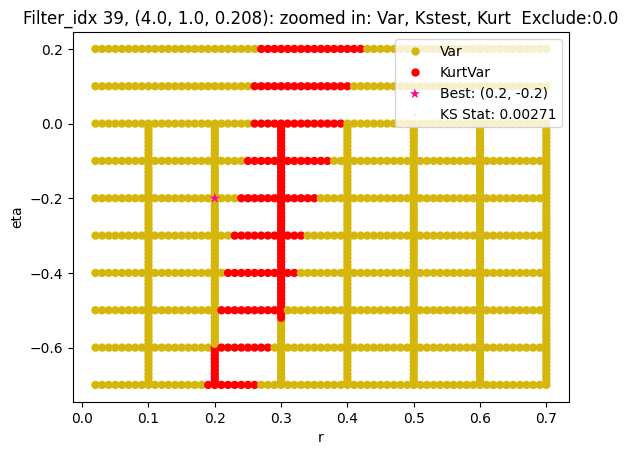

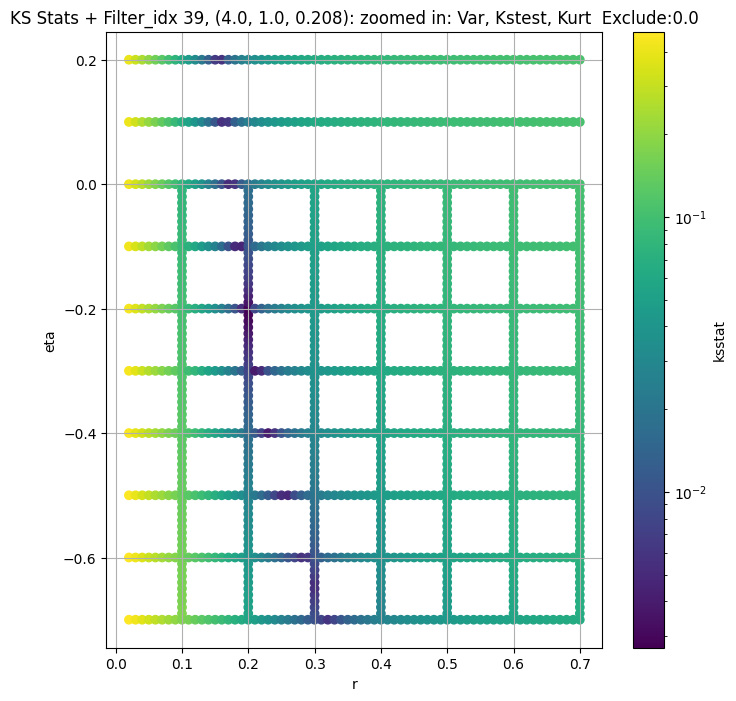

Filter_idx 40, (4.0, 1.0, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 100 = 100, ksstat: 0.006596669998110816, var: 420.4472961425781


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 75 = 75, ksstat: 0.0059348884146251946, var: 431.994873046875


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 50 = 50, ksstat: 0.005537685868092931, var: 445.62835693359375


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 25 = 25, ksstat: 0.004384201015005029, var: 462.923583984375


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 0 = 0, ksstat: 0.003260404326427324, var: 498.9797668457031
Number of samples: 100000, Without approximation : 262144000.0


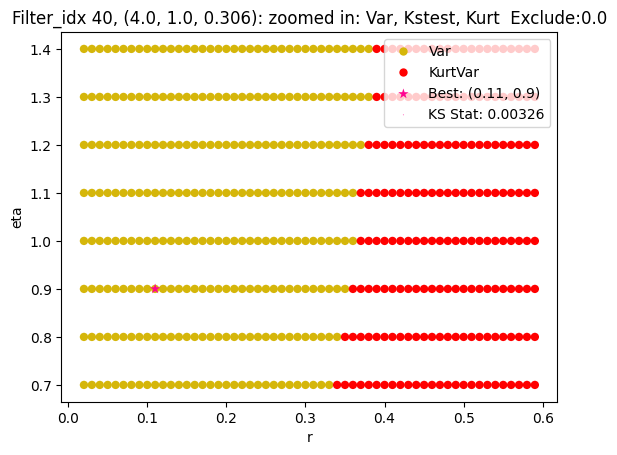

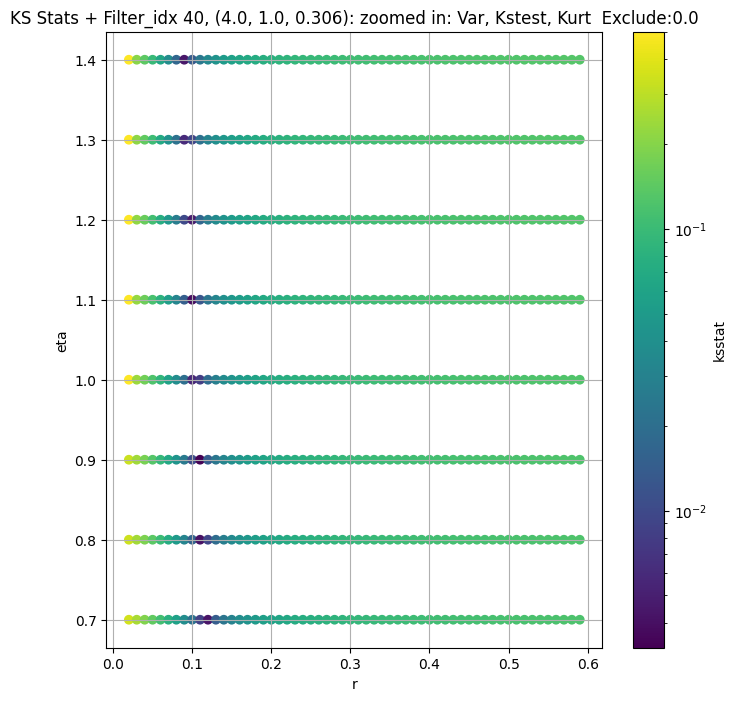

Filter_idx 41, (4.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 0.0 + 100 = 100, ksstat: 0.004992354613713619, var: 166.22889709472656


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 0.0 + 75 = 75, ksstat: 0.003941016508168901, var: 171.6559295654297


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 0.0 + 50 = 50, ksstat: 0.003799601456471735, var: 178.22854614257812


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 0.0 + 25 = 25, ksstat: 0.002947509073307819, var: 186.83714294433594


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 0.0 + 0 = 0, ksstat: 0.0022891938151897717, var: 205.20663452148438
Number of samples: 100000, Without approximation : 262144000.0


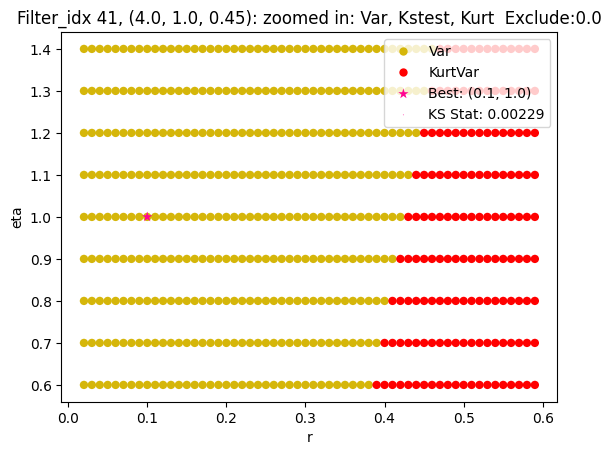

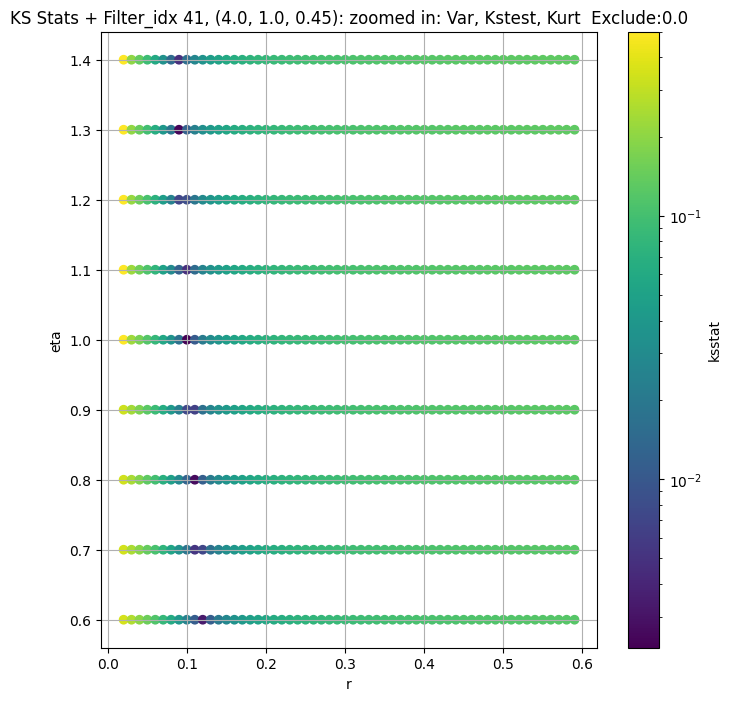

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",38141.09400,29741.96500,47408.02300,5.545877,3.051156,15.768338,262144000.0,"(2.0, 0.5, 0.044)",0.004411,...,3.645792e+04,0.0,37263.949219,0.000084,0.003951,0.73,-0.90,3.874442e+04,25.0,121500
1,"(2.0, 0.5, 0.065)",16323.57900,12823.37800,20713.02000,6.197828,3.286204,19.461838,262144000.0,"(2.0, 0.5, 0.065)",0.004968,...,1.084929e+04,0.0,16323.579102,0.000084,0.003216,0.64,-0.90,1.277281e+04,0.0,182250
2,"(2.0, 0.5, 0.096)",6576.69800,5205.66200,8263.79100,6.400652,3.229711,17.005306,262144000.0,"(2.0, 0.5, 0.096)",0.004718,...,5.844751e+03,100.0,6576.698242,0.000084,0.003171,0.60,-0.87,4.089888e+03,0.0,192000
3,"(2.0, 0.5, 0.141)",2797.85910,2166.36350,3563.50500,7.264324,3.640300,21.403347,262144000.0,"(2.0, 0.5, 0.141)",0.003138,...,8.326962e+02,0.0,2797.859100,0.000084,0.003138,0.50,-0.80,8.326962e+02,0.0,192000
4,"(2.0, 0.5, 0.208)",1152.82480,876.24927,1451.83330,8.286530,4.267028,29.099030,262144000.0,"(2.0, 0.5, 0.208)",0.005470,...,9.911036e+01,0.0,1152.824829,0.000084,0.004320,0.40,-0.71,1.015459e+02,0.0,96000
5,"(2.0, 0.5, 0.306)",415.59400,313.29500,537.46234,9.865244,4.211713,37.117893,262144000.0,"(2.0, 0.5, 0.306)",0.005197,...,2.967821e+00,0.0,415.593994,0.000084,0.003485,0.30,-0.45,2.615384e+00,0.0,153772
6,"(2.0, 0.5, 0.45)",279.85425,209.98505,375.27567,9.890322,4.796311,35.474228,262144000.0,"(2.0, 0.5, 0.45)",0.004549,...,1.998482e+00,0.0,279.854248,0.000084,0.002921,0.31,-0.50,2.636806e+00,0.0,216000
7,"(2.0, 1.0, 0.044)",54288.89500,43416.72300,68531.04000,6.410547,3.334382,19.243261,262144000.0,"(2.0, 1.0, 0.044)",0.004035,...,5.189311e+04,0.0,54288.894531,0.000084,0.002490,0.60,-0.83,3.102611e+04,0.0,288000
8,"(2.0, 1.0, 0.065)",21606.79500,16645.76000,27949.41000,7.674028,3.695609,25.068642,262144000.0,"(2.0, 1.0, 0.065)",0.002485,...,6.430594e+03,0.0,21606.795000,0.000084,0.002485,0.50,-0.80,6.430594e+03,0.0,288000


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}:")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

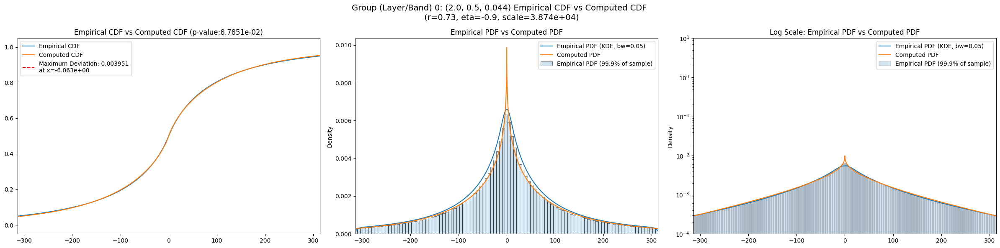

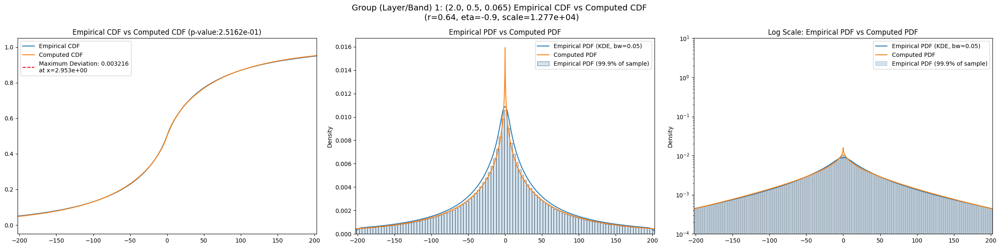

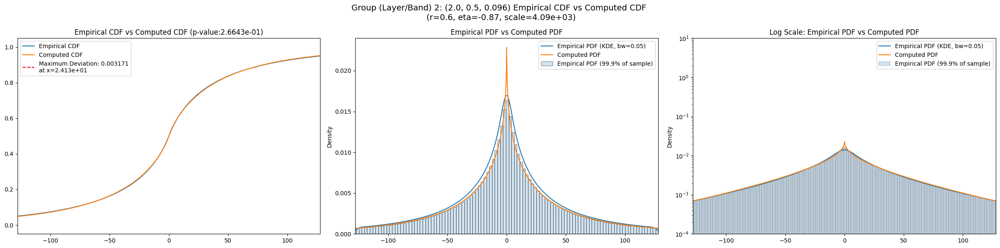

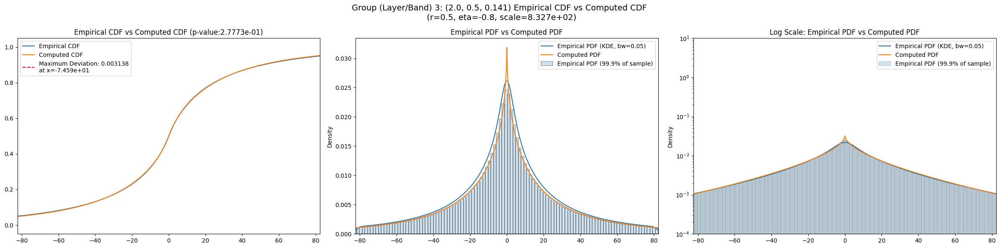

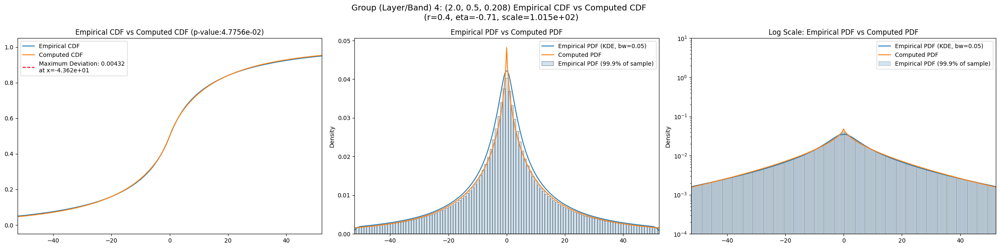

...

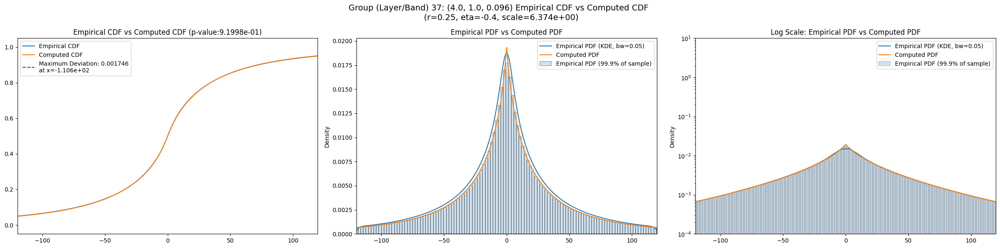

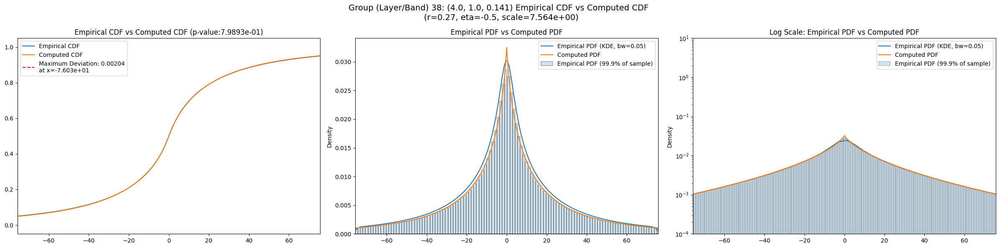

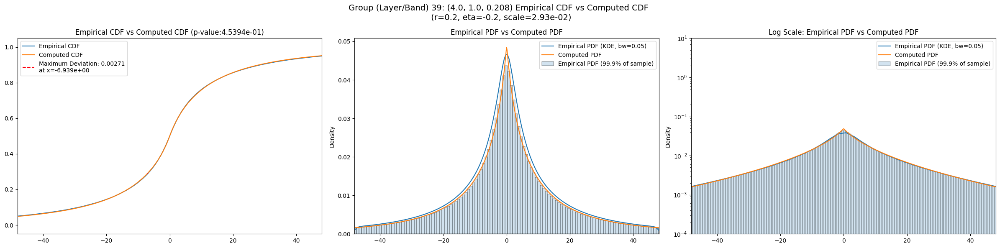

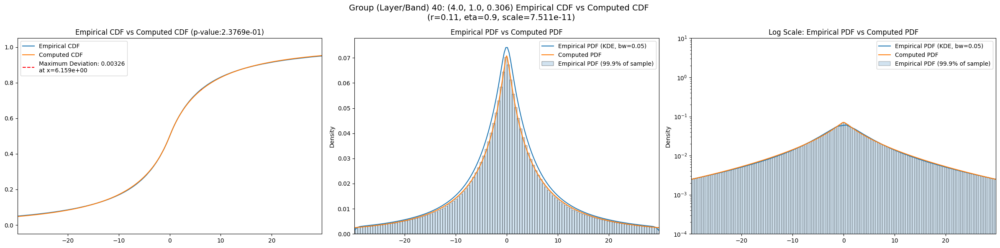

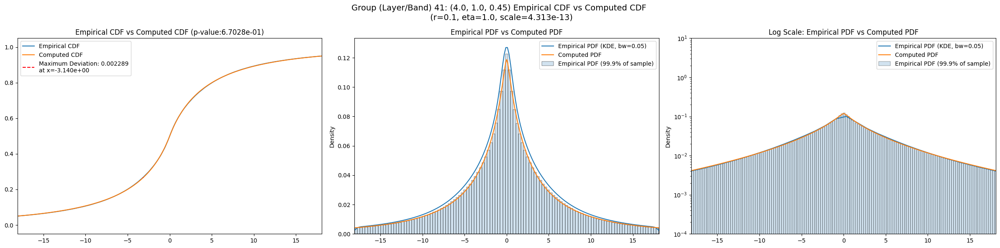

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = f"{group}: {filter_group_map[group]}")
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",38141.09400,29741.96500,47408.02300,5.545877,3.051156,15.768338,262144000.0,"(2.0, 0.5, 0.044)",0.004411,...,123.81000,0.051347,0.0,108.02300,0.023853,0.0,86.32640,0.026071,0.0,0.0
1,"(2.0, 0.5, 0.065)",16323.57900,12823.37800,20713.02000,6.197828,3.286204,19.461838,262144000.0,"(2.0, 0.5, 0.065)",0.004968,...,78.36870,0.053150,0.0,68.30190,0.025799,0.0,54.48090,0.028067,0.0,0.0
2,"(2.0, 0.5, 0.096)",6576.69800,5205.66200,8263.79100,6.400652,3.229711,17.005306,262144000.0,"(2.0, 0.5, 0.096)",0.004718,...,49.45130,0.053028,0.0,43.10530,0.025690,0.0,34.38610,0.027908,0.0,0.0
3,"(2.0, 0.5, 0.141)",2797.85910,2166.36350,3563.50500,7.264324,3.640300,21.403347,262144000.0,"(2.0, 0.5, 0.141)",0.003138,...,31.61140,0.053470,0.0,27.57620,0.026168,0.0,21.95500,0.028073,0.0,0.0
4,"(2.0, 0.5, 0.208)",1152.82480,876.24927,1451.83330,8.286530,4.267028,29.099030,262144000.0,"(2.0, 0.5, 0.208)",0.005470,...,19.41560,0.055904,0.0,16.99100,0.028492,0.0,13.51290,0.029474,0.0,0.0
5,"(2.0, 0.5, 0.306)",415.59400,313.29500,537.46234,9.865244,4.211713,37.117893,262144000.0,"(2.0, 0.5, 0.306)",0.005197,...,11.66010,0.052541,0.0,10.25450,0.025243,0.0,8.13856,0.025112,0.0,0.0
6,"(2.0, 0.5, 0.45)",279.85425,209.98505,375.27567,9.890322,4.796311,35.474228,262144000.0,"(2.0, 0.5, 0.45)",0.004549,...,9.53091,0.051938,0.0,8.39046,0.024794,0.0,6.63181,0.024543,0.0,0.0
7,"(2.0, 1.0, 0.044)",54288.89500,43416.72300,68531.04000,6.410547,3.334382,19.243261,262144000.0,"(2.0, 1.0, 0.044)",0.004035,...,146.82800,0.049911,0.0,128.22100,0.022482,0.0,102.36000,0.024661,0.0,0.0
8,"(2.0, 1.0, 0.065)",21606.79500,16645.76000,27949.41000,7.674028,3.695609,25.068642,262144000.0,"(2.0, 1.0, 0.065)",0.002485,...,87.89570,0.052192,0.0,76.82590,0.024950,0.0,61.00930,0.026587,0.0,0.0


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.004411,0.000084,0.003951,0.051347,0.023853,0.026071
1,0.004968,0.000084,0.003216,0.053150,0.025799,0.028067
2,0.004718,0.000084,0.003171,0.053028,0.025690,0.027908
3,0.003138,0.000084,0.003138,0.053470,0.026168,0.028073
4,0.005470,0.000084,0.004320,0.055904,0.028492,0.029474
5,0.005197,0.000084,0.003485,0.052541,0.025243,0.025112
6,0.004549,0.000084,0.002921,0.051938,0.024794,0.024543
7,0.004035,0.000084,0.002490,0.049911,0.022482,0.024661
8,0.002485,0.000084,0.002485,0.052192,0.024950,0.026587


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,37263.949219,0.003951,0.73,-0.90,3.874442e+04,25.0
1,16323.579102,0.003216,0.64,-0.90,1.277281e+04,0.0
2,6576.698242,0.003171,0.60,-0.87,4.089888e+03,0.0
3,2797.859100,0.003138,0.50,-0.80,8.326962e+02,0.0
4,1152.824829,0.004320,0.40,-0.71,1.015459e+02,0.0
5,415.593994,0.003485,0.30,-0.45,2.615384e+00,0.0
6,279.854248,0.002921,0.31,-0.50,2.636806e+00,0.0
7,54288.894531,0.002490,0.60,-0.83,3.102611e+04,0.0
8,21606.795000,0.002485,0.50,-0.80,6.430594e+03,0.0
